In [1]:
#imports
import pandas as pd
import numpy as np
import matplotlib as mpl
from matplotlib import rcParams
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib import cycler
from matplotlib.ticker import StrMethodFormatter
from matplotlib.axis import Axis
from matplotlib.patches import FancyBboxPatch
from matplotlib.font_manager import FontProperties
import sqlite3 as sq
from functools import reduce
#settings
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width', 150)
pd.options.mode.chained_assignment = None  # default='warn'
from warnings import simplefilter
simplefilter(action="ignore", category=pd.errors.PerformanceWarning)
import sys
sys.path.append("../..") # Adds higher directory to python modules path
import geodict
namestocommon = geodict.namestocommon

In [2]:
import vizfunctions2
prettypercentchange = vizfunctions2.prettypercentchange #single viz per x axis unit datalabels, active inputs: xoffset, yoffset, labelformat
percentchange = vizfunctions2.percentchange #double viz per x axis unit datalabels, active inputs: xoffset1, yoffset1, xoffset2, yoffset2, labelformat, size
percent = vizfunctions2.percent
percentchange = vizfunctions2.percentchange
realchange = vizfunctions2.realchange

In [3]:
import changefunctions
calculate_changes = changefunctions.calculate_changes
generate_time_frames = changefunctions.generate_time_frames

In [4]:
import vizfunctions
allheaders = vizfunctions.allheaders
howwide = vizfunctions.howwide
tablecolors = vizfunctions.tablecolors
allheadersmerged = vizfunctions.allheadersmerged
makeinvisible = vizfunctions.makeinvisible
mergecells = vizfunctions.mergecells
mergemultcells = vizfunctions.mergemultcells
stackedbarlabels = vizfunctions.stackedbarlabels

In [5]:
#Set branding parameters
GNRCDARKBLUE, GNRCLIGHTBLUE, GNRCORANGE, GNRCCOOLGRAY= '#00263E', '#6DB0C7', '#EB7525', '#7B7E85'
C1, C2, C3, C4, C5, C6, C7, C8, C9 = '#511c74', '#808989', '#ca3a3c', '#333132', '#C7846D', '#790002', '#765694', '#d681e3', '#d6d0d3'
TABLECOL1, TABLECOL2 = '#E1EFF2', '#F4F9F9'
GNRCFONTONE, GNRCFONTTWO, GNRCFONTTHREE = 'Calibri', 'DIN Condensed', 'Palatino Linotype'
SMALLER_SIZE, SMALL_SIZE, MEDIUM_SIZE, BIGGER_SIZE, BIGGEST_SIZE = 10, 11, 13, 18, 20
#Update the default style sheet using rcparams
plt.rcParams.update({'font.size': SMALL_SIZE, 'font.weight': 'normal', 'axes.titlesize': BIGGER_SIZE, 'axes.labelsize': MEDIUM_SIZE, 'xtick.labelsize': SMALL_SIZE, 
'ytick.labelsize': SMALL_SIZE, 'legend.fontsize': SMALL_SIZE, 'font.family': GNRCFONTONE, 'axes.facecolor': 'None', 'figure.figsize': (10, 5), 
'figure.facecolor': 'None', 'figure.edgecolor': 'None', 'figure.autolayout': True, 'figure.dpi': 500, 'axes.grid': False, 'axes.grid.which': 'major', 
'axes.axisbelow': True, 'text.color': GNRCDARKBLUE, 'axes.labelcolor': GNRCDARKBLUE, 'xtick.color': GNRCCOOLGRAY, 'ytick.color': GNRCCOOLGRAY, 
'axes.labelpad': 15, 'axes.titlepad': 20, 'grid.color': GNRCCOOLGRAY, 'grid.linestyle': '-', 'grid.alpha': '0.7', 'lines.linewidth': 1.5, 
'lines.linestyle': '-', 'lines.marker': 'o', 'legend.framealpha': 0.8, 'legend.facecolor': 'inherit', 'legend.frameon': False,
'axes.prop_cycle': cycler(color = [C1, C2, C3, C4, C5, C6, C7, C8, C9, GNRCLIGHTBLUE]), 
'axes.spines.top': False, 'axes.spines.right': False, 'axes.spines.bottom': False, 'axes.spines.left': False, 'xtick.major.size': 8, 
'xtick.minor.size': 4, 'ytick.major.size': 6, 'ytick.minor.size': 3, 'ytick.minor.size': 3})
#Settings not available in rcparams
tickaxisselection = 'both'                  #both axes have ticks
majororminortick = 'major'                  #only major ticks selected for now, although we just established a default size for the minor if we want them
linealpha = 0.8                             #no rcparam, set this as alpha for line plots
#AXIS LABEL FORMATTERS
yearformat = '{x:.0f}'                       #takes float datatype to look like a year
numbernodecimalformat = '{x:,.0f}'           #takes float datatype to a number with no decimal with commas at the thousandth
numberonedecimalformat = '{x:,.1f}'          #takes float datatype to a number with one decimal with commas at the thousandth
numbertwodecimalformat = '{x:,.2f}'          #takes float datatype to a number with two decimal with commas at the thousandth
percentformat = '{x:,.1f}%'                  #takes float datatype to a number with one decimal with commas at the thousandth and an appended %
percentnodecimalformat = '{x:,.0f}%'         #takes float datatype to a number with one decimal with commas at the thousandth and an appended %
moneyformat = '${x:,.0f}'                    #takes float datatype to a number with no decimal with commas at the thousandth and a MONEY sign   

In [6]:
#2000
conn = sq.connect('../../../../GNRC-Data-Pipelines/Outputs/CensusBureau.db')
#SF12000
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_SF1_2000]', conn)
sf12000 = pd.DataFrame(sql_query)
sf12000.drop(columns = 'Source', inplace = True)
#SF32000
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_SF3_2000]', conn)
sf32000 = pd.DataFrame(sql_query)
sf32000.drop(columns = 'Source', inplace = True)
#TIGER2000
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_TIGER_2000]', conn)
TIGER2000 = pd.DataFrame(sql_query)
TIGER2000.drop(columns = 'Source', inplace = True)
#SUBJECT 2000
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_ACS5SUBJ_2000]', conn)
SUBJ2000 = pd.DataFrame(sql_query)
SUBJ2000.drop(columns = 'Source', inplace = True)
dfs2000 = [TIGER2000, sf12000, sf32000, SUBJ2000]
twothousand= reduce(lambda  left,right: pd.merge(left,right,on=['NAME', 'GEO_ID'], how='outer'), dfs2000)
twothousand = twothousand.set_index(['NAME', 'GEO_ID'])
twothousandsuff = twothousand.add_suffix(' 2000')
#twothousand.columns = pd.MultiIndex.from_product([twothousand.columns, [2000], ['None']])
#2010
#SF12010
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_SF1_2010]', conn)
sf12010 = pd.DataFrame(sql_query)
sf12010.drop(columns = 'Source', inplace = True)
#ACS52010
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_ACS5_2010]', conn)
ACS52010 = pd.DataFrame(sql_query)
ACS52010.drop(columns = 'Source', inplace = True)
#TIGER2010
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_TIGER_2010]', conn)
TIGER2010 = pd.DataFrame(sql_query)
TIGER2010.drop(columns = 'Source', inplace = True)
#SUBJECT 2010
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_ACS5SUBJ_2010]', conn)
SUBJ2010 = pd.DataFrame(sql_query)
SUBJ2010.drop(columns = 'Source', inplace = True)
dfs2010 = [TIGER2010, sf12010, ACS52010, SUBJ2010]
twothousandten= reduce(lambda  left,right: pd.merge(left,right,on=['NAME', 'GEO_ID'], how='outer'), dfs2010)
twothousandten = twothousandten.fillna(0)
twothousandten = twothousandten.set_index(['NAME', 'GEO_ID'])
twothousandtensuff = twothousandten.add_suffix(' 2010')
#twothousandten.columns = pd.MultiIndex.from_product([twothousandten.columns, [2010], ['None']])
#2020/21
#ACS52021
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_ACS5_2021]', conn)
ACS52021 = pd.DataFrame(sql_query)
ACS52021.drop(columns = 'Source', inplace = True)
#PL2020
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_PL_2020]', conn)
PL2020 = pd.DataFrame(sql_query)
PL2020.drop(columns = 'Source', inplace = True)
#TIGER2020
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_TIGER_2020]', conn)
TIGER2020 = pd.DataFrame(sql_query)
TIGER2020.drop(columns = 'Source', inplace = True)
#SUBJECT 2021
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_ACS5SUBJ_2021]', conn)
SUBJ2021 = pd.DataFrame(sql_query)
SUBJ2021.drop(columns = 'Source', inplace = True)
dfs2021 = [TIGER2020, ACS52021, PL2020, SUBJ2021]
twothousandtwentyone = reduce(lambda  left,right: pd.merge(left,right,on=['NAME', 'GEO_ID'], how='outer'), dfs2021)
twothousandtwentyone = twothousandtwentyone.fillna(0)
twothousandtwentyone = twothousandtwentyone.set_index(['NAME', 'GEO_ID'])
#twothousandtwentyone = twothousandtwentyone.drop(columns = groupquarters)
twothousandtwentyonesuff = twothousandtwentyone.add_suffix(' 2021')
#twothousandtwentyone.columns = pd.MultiIndex.from_product([twothousandtwentyone.columns, [2021], ['None']])

In [7]:
#CHECK WHATS GOING ON HERE LATER
twothousandten = twothousandten.drop(columns = 'index')

In [8]:
geos = ['Sumner County', 'Gallatin', 'Millersville', 'Goodlettsville', 'Hendersonville', 'Portland', 
        'Westmoreland', 'Mitchellville', 'White House']

In [9]:
dfs = [twothousandsuff, twothousandtensuff, twothousandtwentyonesuff]
dfsuff = reduce(lambda  left,right: pd.merge(left,right, on = ['NAME', 'GEO_ID'], how='outer'), dfs)

In [10]:
dfsuff = dfsuff.reset_index().set_index('NAME').transpose()
dfsuff = dfsuff.rename(columns = namestocommon)
dfsuff = dfsuff[geos]
dfsuff = dfsuff.transpose().reset_index()

In [11]:
cols = list(dfsuff.columns)
cols.remove('NAME')
cols.remove('GEO_ID')
dfsuff[cols] = dfsuff[cols].astype(float)

In [12]:
twothousand.columns = pd.MultiIndex.from_product([twothousand.columns, [2000], ['None']])
twothousandten.columns = pd.MultiIndex.from_product([twothousandten.columns, [2010], ['None']])
twothousandtwentyone.columns = pd.MultiIndex.from_product([twothousandtwentyone.columns, [2021], ['None']])

In [13]:
#all years tidy
dfs = [twothousand, twothousandten, twothousandtwentyone]
dftidy = reduce(lambda  left,right: pd.merge(left,right,on=['NAME', 'GEO_ID'], how='outer'), dfs)

In [14]:
years = [2000, 2010, 2021]
time_frames = generate_time_frames(years)

In [15]:
value_counts = dftidy.columns.get_level_values(0).value_counts()
first_level = value_counts[value_counts == 3].index.tolist()
#remove percentages - don't want change metrics on them
first_level = [item for item in first_level if '%' not in item]

In [16]:
#pass the dataframe, the list of variables, time frames, and years through the "calculate change" function
dftidy = calculate_changes(dftidy, first_level, time_frames = time_frames, years = years)

In [17]:
#reformat and rename columns
dftidy = dftidy.stack([1, 1])
dftidy = dftidy.reset_index(drop = False)
dftidy = dftidy.rename(columns = {'level_2':'Year', 'level_3':'Time Frame'})

In [18]:
dftidy = dftidy.set_index('NAME').transpose()
dftidy = dftidy.rename(columns = namestocommon)
dftidy = dftidy[geos]
dftidy = dftidy.transpose().reset_index()
dftidy['Year'] = dftidy['Year'].replace({'None': 0})

In [19]:
cols = list(dftidy.columns)
cols.remove("GEO_ID")
cols.remove('Time Frame')
cols.remove('NAME')
dftidy[cols] = dftidy[cols].astype(float)

In [20]:
dftidy.head()

NAME          GEO_ID    Year Time Frame  Age %:Under 5  Age%:10 to 14  Age%:15 to 17  Age%:18 to 24  Age%:18 to 54  Age%:18 to 64  \
0  Sumner County  0500000US47165  2000.0       None       6.771229       7.550844       4.766614       8.037624      53.268327      63.010065   
1  Sumner County  0500000US47165  2010.0       None       6.515609       7.363441       4.376109       7.636714      49.738243      62.095303   
2  Sumner County  0500000US47165  2021.0       None       5.925320       6.421600       4.218902       7.544707      47.250772      60.545701   
3  Sumner County  0500000US47165     0.0  2000-2010            NaN            NaN            NaN            NaN            NaN            NaN   
4  Sumner County  0500000US47165     0.0  2000-2021            NaN            NaN            NaN            NaN            NaN            NaN   

   Age%:25 to 34  Age%:35 to 44  Age%:45 to 54  Age%:5 to 9  Age%:55 and Older  Age%:55 to 64  Age%:65 and Older  Age%:65 to 74  Age%:75 to 84  \
0      13.668177      17.031944      15.582335     7.233478          20.409509       9.741738          10.667771       5.901157       3.516317   
1      12.149771      14.477886      15.018208     7.036634          24.969965      12.357061          12.612904       7.524666       3.724361   
2      12.456226      13.475207      13.578814     7.056197          29.127209      13.294929          15.832280       9.716322       4.587745   
3            NaN            NaN            NaN          NaN                NaN            NaN                NaN            NaN            NaN   
4            NaN            NaN            NaN          NaN                NaN            NaN                NaN            NaN            NaN   

   Age%:85 and Older  Age%:School Age 5 to 18  Age%:Under 18  Age:10 to 14  Age:10 to 14 % Change  Age:10 to 14 Change  Age:15 to 17  \
0           1.250297                19.550936      26.322164        9850.0                    NaN                  NaN        6218.0   
1           1.363877                18.776184      25.291792       11829.0                    NaN                  NaN        7030.0   
2           1.528212                17.696699      23.622019       12396.0                    NaN                  NaN        8144.0   
3                NaN                      NaN            NaN           NaN              20.091371               1979.0           NaN   
4                NaN                      NaN            NaN           NaN              25.847716               2546.0           NaN   

   Age:15 to 17 % Change  Age:15 to 17 Change  Age:18 to 24  Age:18 to 24 % Change  Age:18 to 24 Change  Age:18 to 54  Age:18 to 54 % Change  \
0                    NaN                  NaN       10485.0                    NaN                  NaN       69488.0                    NaN   
1                    NaN                  NaN       12268.0                    NaN                  NaN       79902.0                    NaN   
2                    NaN                  NaN       14564.0                    NaN                  NaN       91211.0                    NaN   
3              13.058861                812.0           NaN              17.005246               1783.0           NaN              14.986760   
4              30.974590               1926.0           NaN              38.903195               4079.0           NaN              31.261513   

   Age:18 to 54 Change  Age:18 to 64  Age:18 to 64 % Change  Age:18 to 64 Change  Age:25 to 34  Age:25 to 34 % Change  Age:25 to 34 Change  \
0                  NaN       82196.0                    NaN                  NaN       17830.0                    NaN                  NaN   
1                  NaN       99753.0                    NaN                  NaN       19518.0                    NaN                  NaN   
2                  NaN      116875.0                    NaN                  NaN       24045.0                    NaN                  NaN   
3             

In [21]:
#set primary geo for colors
primarygeo = 'Portland'
county = 'Sumner County'
#quick geo filters
reggeos = dftidy.loc[(dftidy['NAME'] == 'Sumner County')|
                     (dftidy['NAME'] == 'Gallatin')|(dftidy['NAME'] == 'Goodlettsville')|(dftidy['NAME'] == 'Hendersonville')|
                     (dftidy['NAME'] == 'Millersville')|(dftidy['NAME'] == 'Mitchellville')|(dftidy['NAME'] == 'Portland')|(dftidy['NAME'] == 'Westmoreland')|
                     (dftidy['NAME'] == 'White House')].reset_index(drop = True)
reggeost = dfsuff.loc[(dfsuff['NAME'] == 'Sumner County')|
                      (dfsuff['NAME'] == 'Gallatin')|(dfsuff['NAME'] == 'Goodlettsville')|(dfsuff['NAME'] == 'Hendersonville')|(dfsuff['NAME'] == 'Millersville')|
                      (dfsuff['NAME'] == 'Mitchellville')|(dfsuff['NAME'] == 'Portland')|(dfsuff['NAME'] == 'Westmoreland')|
                      (dfsuff['NAME'] == 'White House')].reset_index(drop = True)
reggeosnocounty = dftidy.loc[(dftidy['NAME'] == 'Gallatin')|(dftidy['NAME'] == 'Goodlettsville')|(dftidy['NAME'] == 'Hendersonville')|
                             (dftidy['NAME'] == 'Millersville')|(dftidy['NAME'] == 'Mitchellville')|(dftidy['NAME'] == 'Portland')|(dftidy['NAME'] == 'Westmoreland')|
                             (dftidy['NAME'] == 'White House')].reset_index(drop = True)
reggeosnocountyt = dfsuff.loc[(dfsuff['NAME'] == 'Gallatin')|(dfsuff['NAME'] == 'Goodlettsville')|(dfsuff['NAME'] == 'Hendersonville')|
                              (dfsuff['NAME'] == 'Millersville')|(dfsuff['NAME'] == 'Mitchellville')|(dfsuff['NAME'] == 'Portland')|
                              (dfsuff['NAME'] == 'Westmoreland')|(dfsuff['NAME'] == 'White House')].reset_index(drop = True)
Primary = dftidy.loc[dftidy['NAME'] == 'Portland']
Primaryt = dfsuff.loc[dfsuff['NAME'] == 'Portland']
County = dftidy.loc[dftidy['NAME'] == 'Sumner County']
Countyt = dfsuff.loc[dfsuff['NAME'] == 'Sumner County']
Gallatin = dftidy.loc[dftidy['NAME'] == 'Gallatin']
Gallatint = dfsuff.loc[dfsuff['NAME'] == 'Gallatin']
Goodlettsville = dftidy.loc[dftidy['NAME'] == 'Goodlettsville']
Goodlettsvillet = dfsuff.loc[dfsuff['NAME'] == 'Goodlettsville']
Hendersonville = dftidy.loc[dftidy['NAME'] == 'Hendersonville']
Hendersonvillet = dfsuff.loc[dfsuff['NAME'] == 'Hendersonville']
Millersville = dftidy.loc[dftidy['NAME'] == 'Millersville']
Millersvillet = dfsuff.loc[dfsuff['NAME'] == 'Millersville']
Mitchellville = dftidy.loc[dftidy['NAME'] == 'Mitchellville']
Mitchellvillet = dfsuff.loc[dfsuff['NAME'] == 'Mitchellville']
Portland = dftidy.loc[dftidy['NAME'] == 'Portland']
Portlandt = dfsuff.loc[dfsuff['NAME'] == 'Portland']
Westmoreland = dftidy.loc[dftidy['NAME'] == 'Westmoreland']
Westmorelandt = dfsuff.loc[dfsuff['NAME'] == 'Westmoreland']
WhiteHouse = dftidy.loc[dftidy['NAME'] == 'White House']
WhiteHouset = dfsuff.loc[dfsuff['NAME'] == 'White House']

In [22]:
#data labels functions
def singledatalabels(xoffset, yoffset, labelformat):
    for j, k in zip(x, y):
        label = labelformat.format(k)
        plt.annotate(label, (j, k), textcoords = 'offset points', xytext = (xoffset, yoffset), ha = 'center')
boxstyleinput = "round,pad=-0.060,rounding_size=0.15"
def roundedboxes(boxstyleinput):
    new_patches = []
    for patch in reversed(ax.patches):
        bb = patch.get_bbox()
        color=patch.get_facecolor()
        p_bbox = FancyBboxPatch((bb.xmin, bb.ymin),abs(bb.width), abs(bb.height),boxstyle=boxstyleinput, ec="none", fc=color, mutation_aspect=1)
        patch.remove()
        new_patches.append(p_bbox)
    for patch in new_patches:
        ax.add_patch(patch)

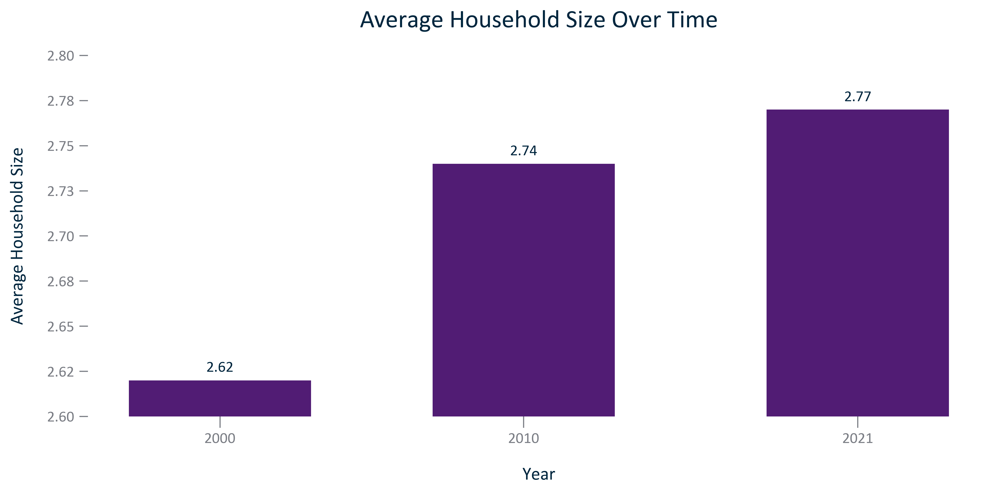

In [23]:
title = 'Average Household Size Over Time' #set title of figure
#set up temporary dataframe
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
xinput = 'Year'
yinput = 'Average Household Size'
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = xinput
ylabel = yinput
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.xaxis.set_major_formatter(ticker.FormatStrFormatter(yearformat)) #x axis formatting
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbertwodecimalformat)) #y axis formatting
ax.set_ylim(bottom = 2.6, top = 2.8)
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
singledatalabels(0, 6, "{:,.2f}")
#display and save
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_avgsize_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_avgsize_overtime.png', bbox_inches='tight')
with open('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_avgsize_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

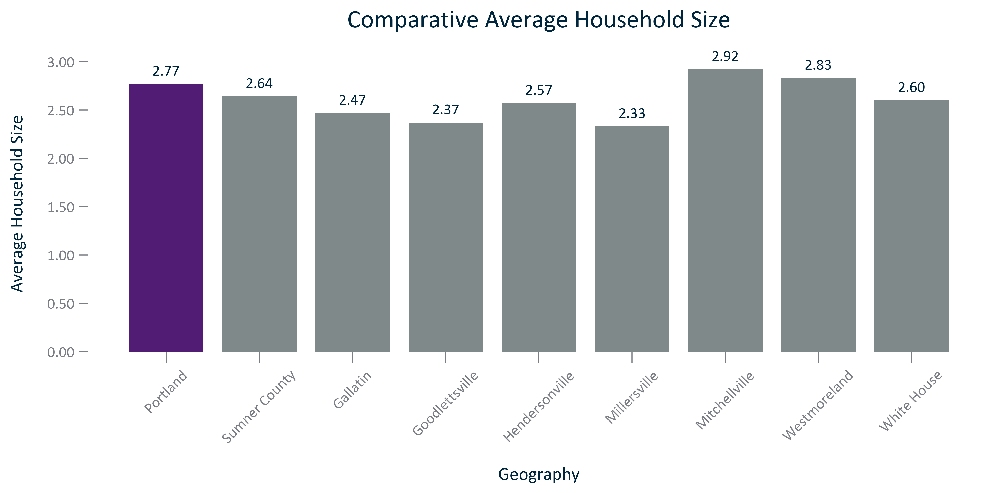

In [24]:
title = 'Comparative Average Household Size'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['NAME'] != 'GNRC Region']
df_temp = df_temp.loc[df_temp['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
xinput = 'NAME'
yinput = 'Average Household Size'
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = 'Geography'
ylabel = yinput
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbertwodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 6, "{:,.2f}")
#display and save
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_geocomparative_avgsize_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_geocomparative_avgsize_2021.png', bbox_inches='tight')
with open('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_geocomparative_avgsize_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

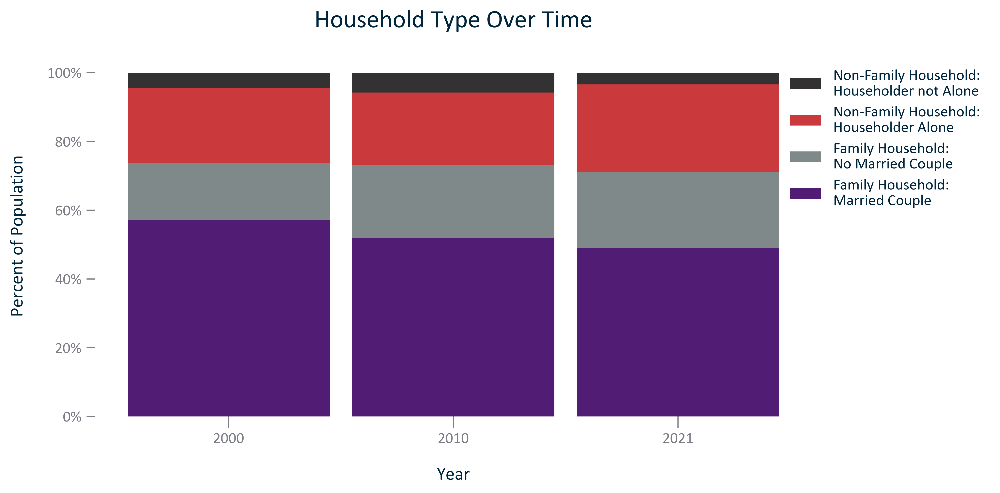

In [25]:
title = 'Household Type Over Time'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year','Household Type%: Family, Married Couple Households', 'Household Type%: Family, Not Married Couple Households',
                   'Household Type%: Nonfamily, Householder Alone', 'Household Type%: Nonfamily, Householder Not Alone']]
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.rename(columns = {'Household Type%: Family, Married Couple Households': 'Family Household: \nMarried Couple', 
                                    'Household Type%: Family, Not Married Couple Households': 'Family Household: \nNo Married Couple',
                                    'Household Type%: Nonfamily, Householder Alone': 'Non-Family Household: \nHouseholder Alone',
                                    'Household Type%: Nonfamily, Householder Not Alone': 'Non-Family Household: \nHouseholder not Alone'})
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
#roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Households') #set the title and axes labels
#rounded boxes
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Population') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
y_offset = 2
# For each patch (basically each rectangle within the bar), add a label.
# stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_stackedbar_primarygeo_type_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_stackedbar_primarygeo_type_overtime.png', bbox_inches='tight')
with open('../Figures/HOUSEHOLDS/HOUSEHOLDS_stackedbar_primarygeo_type_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

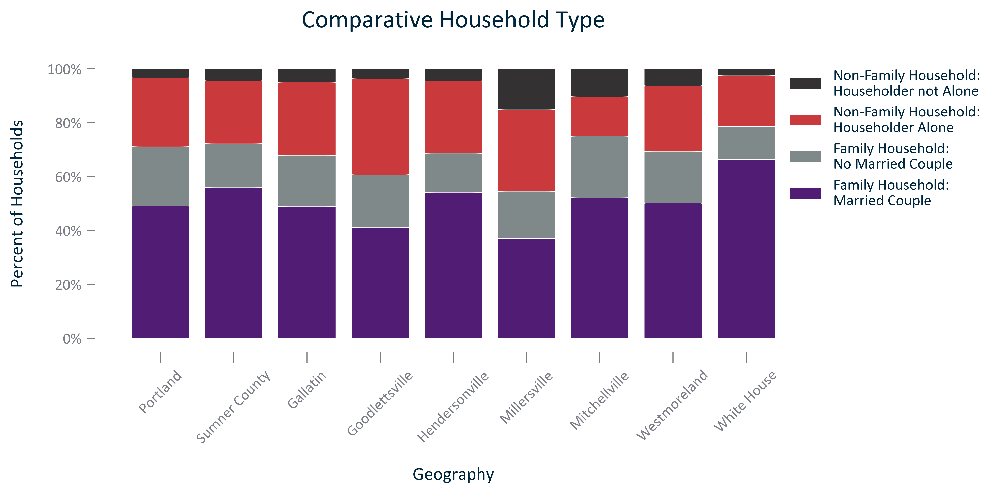

In [26]:
title = 'Comparative Household Type'
df_temp = reggeos.loc[reggeos['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['NAME','Household Type%: Family, Married Couple Households', 'Household Type%: Family, Not Married Couple Households',
                   'Household Type%: Nonfamily, Householder Alone', 'Household Type%: Nonfamily, Householder Not Alone']]
df_temp = df_temp.rename(columns = {'Household Type%: Family, Married Couple Households': 'Family Household: \nMarried Couple', 
                                    'Household Type%: Family, Not Married Couple Households': 'Family Household: \nNo Married Couple',
                                    'Household Type%: Nonfamily, Householder Alone': 'Non-Family Household: \nHouseholder Alone',
                                    'Household Type%: Nonfamily, Householder Not Alone': 'Non-Family Household: \nHouseholder not Alone'}).set_index('NAME')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Geography', ylabel = 'Percent of Households') #set the title and axes labels
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#rounded boxes
roundedboxes(boxstyleinput)
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
#display and save
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_stackedbar_geocomparative_type_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_stackedbar_geocomparative_type_2021.png', bbox_inches='tight')
with open('../Figures/HOUSEHOLDS/HOUSEHOLDS_stackedbar_geocomparative_type_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

In [30]:
def howwide(width):
    ['None' for x in range(width)]
def howlong(indexlength):
    ["None" for x in range(indexlength)]
col1, col2, edge1, edge2 = '#00263E', '#E1EFF2', 'vertical', 'horizontal'
def allheadersmerged(col1, col2, edge1, edge2):
    for cell in table.get_children():
        cell_text = cell.get_text().get_text()
        if cell_text not in row_headers\
        and cell_text not in doublecols:
            cell.set_edgecolor(col1)
        elif cell_text in column_headers:
            cell.set_edgecolor(None)
        else:
            cell.set(edgecolor=col2)
        if cell_text in column_headers:
            cell.visible_edges = 'B'
        elif cell_text in row_headers:
            cell.visible_edges = edge2
        elif cell_text in col_names:
            cell.visible_edges = 'LR'
        if cell_text in row_headers\
        or cell_text in doublecols:
            cell.set_text_props(fontproperties=FontProperties(weight='bold'))

C:\Users\jmccall\AppData\Local\Temp\ipykernel_6348\2030601451.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp1.append(dfs)


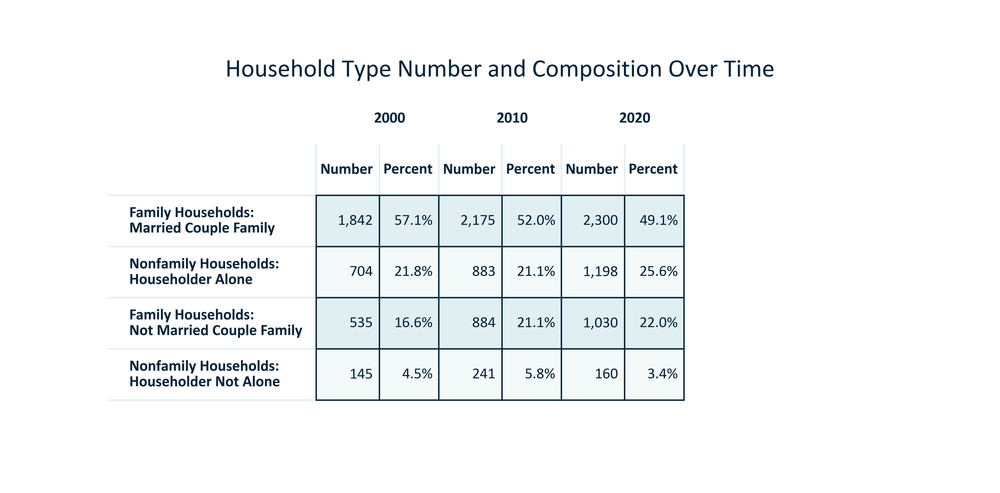

In [31]:
title = 'Household Type Number and Composition Over Time'
df_temp = Primaryt
next_line = ['Number2000', 'Percent2000', 'Number2010', 'Percent2010', 'Number2020', 'Percent2020']
df_temp1 = df_temp[['Family Households: Married Couple Family 2000', 'Household Type%: Family, Married Couple Households 2000',
                    'Family Households: Married Couple Family 2010', 'Household Type%: Family, Married Couple Households 2010',
                    'Family Households: Married Couple Family 2021', 'Household Type%: Family, Married Couple Households 2021']]
df_temp1.columns = next_line
df_temp2 = df_temp[['Family Households: Not Married Couple Family 2000', 'Household Type%: Family, Not Married Couple Households 2000',
                    'Family Households: Not Married Couple Family 2010', 'Household Type%: Family, Not Married Couple Households 2010',
                    'Family Households: Not Married Couple Family 2021', 'Household Type%: Family, Not Married Couple Households 2021']]
df_temp2.columns = next_line
df_temp3 = df_temp[['Nonfamily Households: Householder Alone 2000', 'Household Type%: Nonfamily, Householder Alone 2000',
                    'Nonfamily Households: Householder Alone 2010', 'Household Type%: Nonfamily, Householder Alone 2010',
                    'Nonfamily Households: Householder Alone 2021', 'Household Type%: Nonfamily, Householder Alone 2021']]
df_temp3.columns = next_line
df_temp4 = df_temp[['Nonfamily Households: Householder not Alone 2000', 'Household Type%: Nonfamily, Householder Not Alone 2000',
                    'Nonfamily Households: Householder not Alone 2010', 'Household Type%: Nonfamily, Householder Not Alone 2010',
                    'Nonfamily Households: Householder not Alone 2021', 'Household Type%: Nonfamily, Householder Not Alone 2021']]
df_temp4.columns = next_line
dfs = [df_temp2, df_temp3, df_temp4]
df_temp = df_temp1.append(dfs)
newindex = ['Family Households: \nMarried Couple Family', 'Family Households: \nNot Married Couple Family', 
            'Nonfamily Households: \nHouseholder Alone', 'Nonfamily Households: \nHouseholder Not Alone']
df_temp = df_temp.set_axis(newindex)
df_temp = df_temp.sort_values(by = 'Number2000', ascending = False)
df_temp.update(df_temp[['Number2000', 'Number2010', 'Number2020']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Percent2000', 'Percent2010', 'Percent2020']].applymap('{:.1f}%'.format))
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#4 groups
col_names = ['Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['2000','', '2010', '', '2020', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.8)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_table_primarygeo_type_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_table_primarygeo_type_overtime.png', bbox_inches='tight')
with open('../Figures/HOUSEHOLDS/HOUSEHOLDS_table_primarygeo_type_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

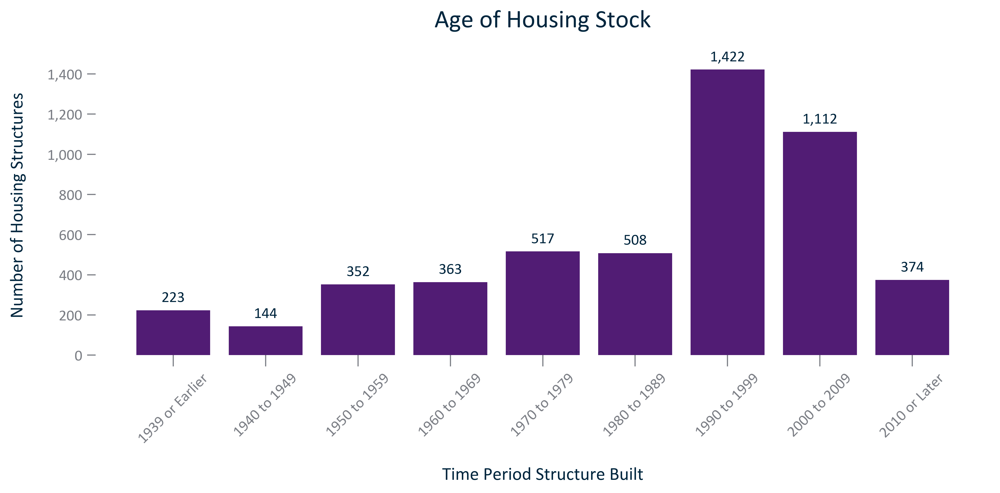

In [32]:
title = 'Age of Housing Stock'
#set up temporary dataframe
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['StructureAge:Built 1939 or Earlier', 'StructureAge:Built 1940 to 1949', 'StructureAge:Built 1950 to 1959',
                   'StructureAge:Built 1960 to 1969', 'StructureAge:Built 1970 to 1979', 'StructureAge:Built 1980 to 1989', 
                   'StructureAge:Built 1990 to 1999', 'StructureAge:Built 2000 to 2009', 'StructureAge:Built 2010 to 2013',
                   'StructureAge:Built 2014 or Later' ]]
df_temp['2010 or Later'] = df_temp['StructureAge:Built 2010 to 2013'] + df_temp['StructureAge:Built 2014 or Later']
df_temp = df_temp.drop(columns = ['StructureAge:Built 2014 or Later', 'StructureAge:Built 2010 to 2013'])
df_temp = df_temp.rename(columns = {'StructureAge:Built 2000 to 2009': '2000 to 2009', 'StructureAge:Built 1990 to 1999': '1990 to 1999', 
                                    'StructureAge:Built 1980 to 1989': '1980 to 1989', 'StructureAge:Built 1970 to 1979': '1970 to 1979', 
                                    'StructureAge:Built 1960 to 1969': '1960 to 1969', 'StructureAge:Built 1950 to 1959': '1950 to 1959', 
                                    'StructureAge:Built 1940 to 1949': '1940 to 1949', 'StructureAge:Built 1939 or Earlier': '1939 or Earlier'})
df_temp = df_temp.melt(var_name = 'Year Structure Built', value_name = 'Structures')
#initiate figure and set parameters
x = df_temp['Year Structure Built']
y = df_temp['Structures']
xlabel = 'Time Period Structure Built'
ylabel = 'Number of Housing Structures'
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 6, "{:,.0f}")
#display and save
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_ageofhousingstock_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_ageofhousingstock_2021.png', bbox_inches='tight')
with open('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_ageofhousingstock_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

In [36]:
#function to make figure invisible for tables
guy1, guy2, guy3 = False, 'off', 'tight'
def makeinvisible(guy1, guy2, guy3):
    return fig.patch.set_visible(guy1), ax.axis(guy2), ax.axis(guy3)
col1, col2, edge1, edge2 = '#00263E', '#E1EFF2', 'vertical', 'horizontal'
def allheaders(col1, col2, edge1, edge2):
    for cell in table.get_children():
        cell_text = cell.get_text().get_text()
        if cell_text not in row_headers\
        and cell_text not in column_headers:
            cell.set_edgecolor(col1)
        else:
            cell.set(edgecolor=col2)
    for cell in table.get_children():
        cell_text = cell.get_text().get_text()
        if cell_text in column_headers:
            cell.visible_edges = edge1
        elif cell_text in row_headers:
            cell.visible_edges = edge2
    for cell in table.get_children():
        cell_text = cell.get_text().get_text()
        if cell_text in row_headers\
        or cell_text in column_headers:
            cell.set_text_props(fontproperties=FontProperties(weight='bold'))

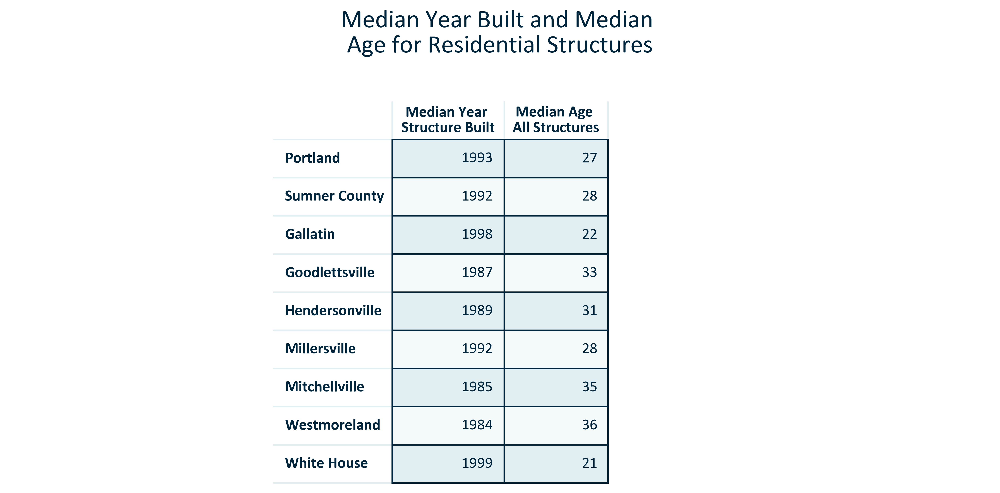

In [37]:
title = 'Median Year Built and Median \nAge for Residential Structures'
df_temp = reggeos.loc[(reggeos['Year'] == 2021.0)&(reggeos['NAME'] != 'GNRC Region')]
df_temp = df_temp[['NAME', 'StructureAge:Median Year Structure Built', 'StructureAge:Median Age of Structure']].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp.rename(columns = {'StructureAge:Median Year Structure Built':'Median Year \nStructure Built', 
                                    'StructureAge:Median Age of Structure': 'Median Age \nAll Structures'})
df_temp.update(df_temp[['Median Year \nStructure Built', 'Median Age \nAll Structures']].applymap('{:.0f}'.format))
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
makeinvisible(guy1, guy2, guy3)
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', 
                 cellColours = colours, colColours = colcolours, cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
allheaders(col1, col2, edge1, edge2)
table.scale(2, 2.5)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
#display and save
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_table_geocomparative_medianyearbuiltandageforresidentialstructures_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_table_geocomparative_medianyearbuiltandageforresidentialstructures_2021.png', bbox_inches='tight')
with open('../Figures/HOUSEHOLDS/HOUSEHOLDS_table_geocomparative_medianyearbuiltandageforresidentialstructures_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

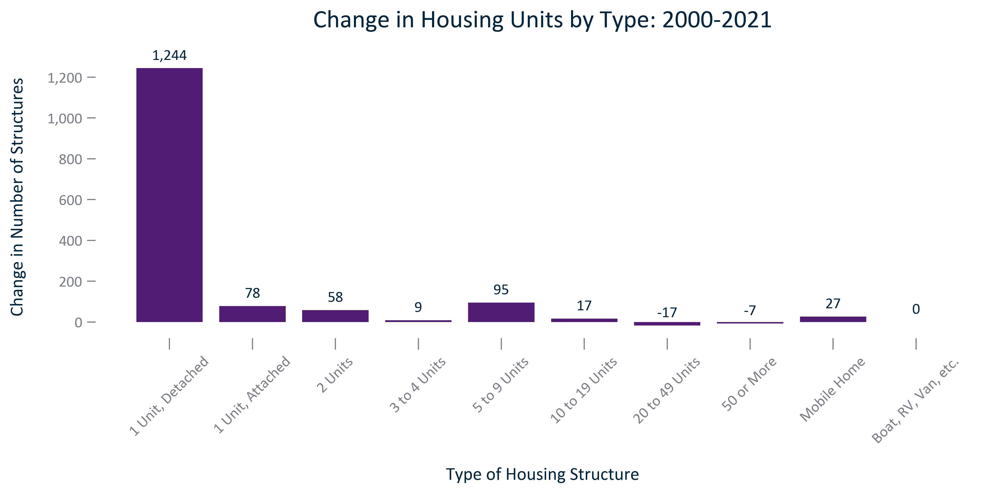

In [38]:
title = 'Change in Housing Units by Type: 2000-2021'
#set up temporary dataframe
df_temp = Primary.loc[Primary['Time Frame'] == '2000-2021']
df_temp = df_temp[['Units:1 Unit, Detached Change', 'Units:1 Unit, Attached Change', 'Units:2 Change', 'Units:3 to 4 Change', 
                   'Units:5 to 9 Change', 'Units:10 to 19 Change', 'Units:20 to 49 Change', 'Units:50 or More Change',
                   'Units:Mobile Home Change', 'Units:Boat, RV, Van etc Change']]
df_temp = df_temp.rename(columns = {'Units:1 Unit, Detached Change': '1 Unit, Detached', 'Units:1 Unit, Attached Change': '1 Unit, Attached',
                                    'Units:2 Change': '2 Units', 'Units:3 to 4 Change': '3 to 4 Units', 
                                    'Units:5 to 9 Change': '5 to 9 Units', 'Units:10 to 19 Change': '10 to 19 Units', 
                                    'Units:20 to 49 Change': '20 to 49 Units', 'Units:50 or More Change': '50 or More', 
                                    'Units:Mobile Home Change' :'Mobile Home', 'Units:Boat, RV, Van etc Change': 'Boat, RV, Van, etc.'})
df_temp = df_temp.melt(var_name = 'Type of Housing Structure', value_name = 'Change in Number of Structures')
#initiate figure and set parameters
x = df_temp['Type of Housing Structure']
y = df_temp['Change in Number of Structures']
xlabel = 'Type of Housing Structure'
ylabel = 'Change in Number of Structures'
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 6, "{:,.0f}")
#display and save
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_changeinunitsbytype_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_changeinunitsbytype_overtime.png', bbox_inches='tight')
with open('../Figures/HOUSEHOLDS/HOUSEHOLDS_bar_primarygeo_changeinunitsbytype_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2017-2021 ACS 5-Year Estimates')

NameError: name 'abovestackedbarlabels' is not defined

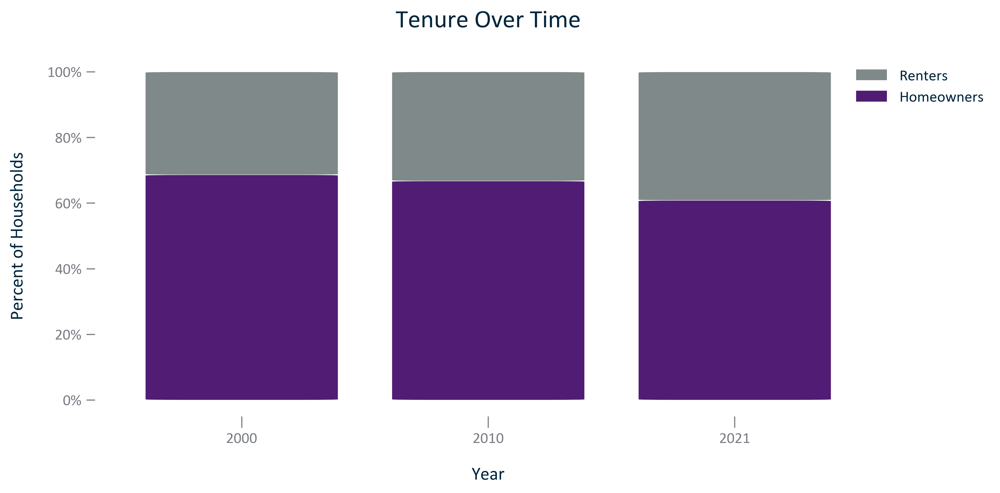

In [39]:
title = 'Tenure Over Time'
df_temp = Primary
df_temp = df_temp.loc[df_temp['Year'] != 0.0]
df_temp = df_temp[['Year','Tenure%:Owners', 'Tenure%:Renters']]
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.rename(columns = {'Tenure%:Owners': 'Homeowners', 'Tenure%:Renters': 'Renters'})
df_temp = df_temp.set_index('Year')
df_temp
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
#plt.locator_params(axis='x', nbins = 4)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Households') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
y_offset = 2
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_stackedbar_primarygeo_shareownvsrent_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_stackedbar_primarygeo_shareownvsrent_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_stackedbar_primarygeo_shareownvsrent_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 22006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

In [41]:
#stacked bar labels function
belowstackedbarlabels, abovestackedbarlabels = -5, 2
def stackedbarlabels(locationoffset):
    for bar in ax.patches:
        ax.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + bar.get_y() + locationoffset, str(float(round(bar.get_height(), 1))) + '%', ha='center')

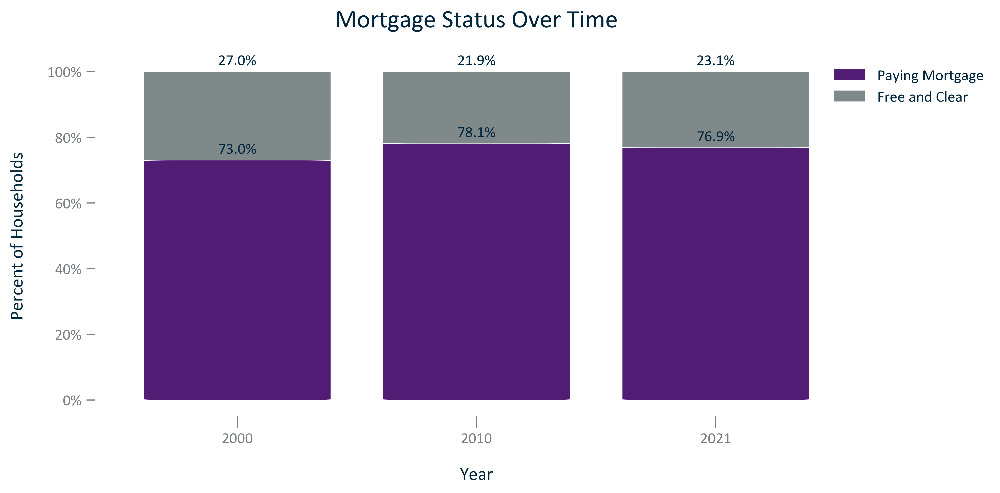

In [42]:
title = 'Mortgage Status Over Time'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year','Mortgage%:Housing Units with a Mortgage', 'Mortgage%:Housing Units without a Mortgage']]
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.rename(columns = {'Mortgage%:Housing Units with a Mortgage': 'Paying Mortgage', 
                                    'Mortgage%:Housing Units without a Mortgage': 'Free and Clear'})
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Households') #set the title and axes labels
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_stackedbar_primarygeo_mortgagestatus_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_stackedbar_primarygeo_mortgagestatus_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_stackedbar_primarygeo_mortgagestatus_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5 Year Estimates')
plt.show()
plt.close();

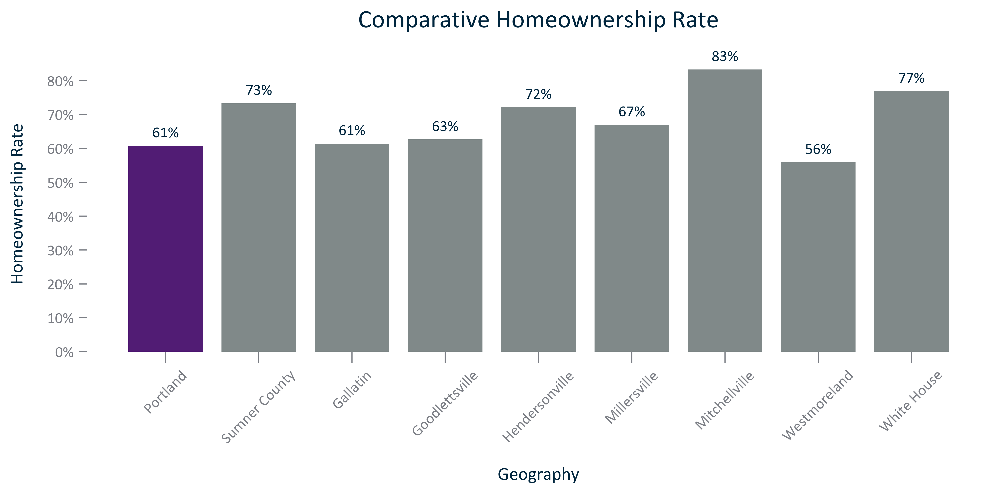

In [43]:
title = 'Comparative Homeownership Rate'
#set up temporary dataframe
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['NAME', 'Tenure%:Owners']]
#initiate figure and set parameters
x = df_temp['NAME']
y = df_temp['Tenure%:Owners']
xlabel = 'Geography'
ylabel = 'Homeownership Rate'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation=45)
#data labels
singledatalabels(0, 6, "{:,.0f}%")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_geocomparative_homeownershiprate_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_geocomparative_homeownershiprate_2021.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_geocomparative_homeownershiprate_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

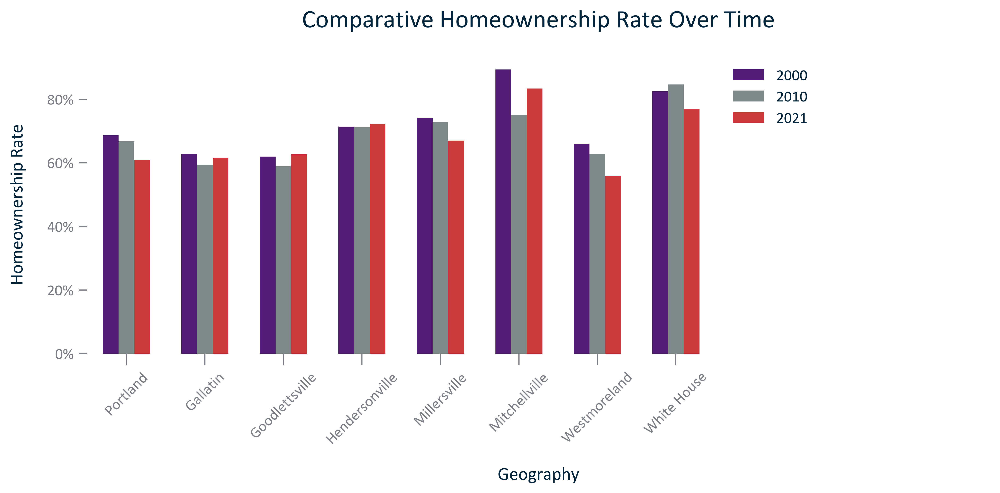

In [44]:
title = 'Comparative Homeownership Rate Over Time'
df_temp = reggeost.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [primarygeo] + newcols
newcols = [county] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Tenure%:Owners 2000', 'Tenure%:Owners 2010', 'Tenure%:Owners 2021']]
xlabel = 'Geography'
ylabel = 'Homeownership Rate'
#set up figure
xpos = np.arange(len(df_temp.index))
xlabels = df_temp.index
y1 = df_temp['Tenure%:Owners 2000']
y2 = df_temp['Tenure%:Owners 2010']
y3 = df_temp['Tenure%:Owners 2021']
width = 0.2
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width, y1, width = width, label = '2000')
bar2 = ax.bar(xpos, y2, width = width, label = '2010')
bar3 = ax.bar(xpos+width, y3, width = width, label = '2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(xlabels)
ax.set_xlim([0.5, 12])
#outside legend
ax.legend(bbox_to_anchor=(0.7, 1), loc='upper left', frameon = False)
# # #display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_homeownershiprate_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_homeownershiprate_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_homeownershiprate_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

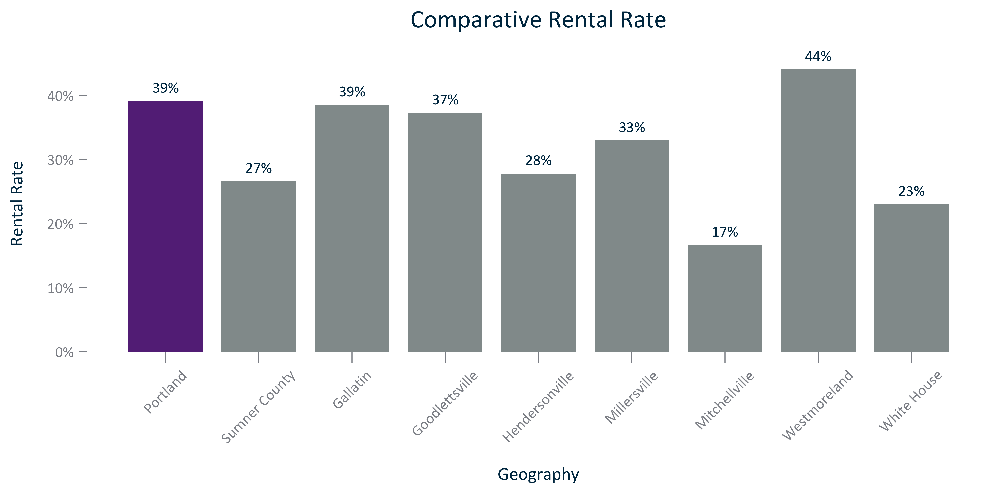

In [46]:
title = 'Comparative Rental Rate'
#set up temporary dataframe
df_temp = reggeos.loc[reggeos['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['NAME', 'Tenure%:Renters']]
#initiate figure and set parameters
x = df_temp['NAME']
y = df_temp['Tenure%:Renters']
xlabel = 'Geography'
ylabel = 'Rental Rate'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation=45)
#data labels
singledatalabels(0, 6, "{:,.0f}%")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_geocomparative_rentalrate_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_geocomparative_rentalrate_2021.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_geocomparative_rentalrate_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

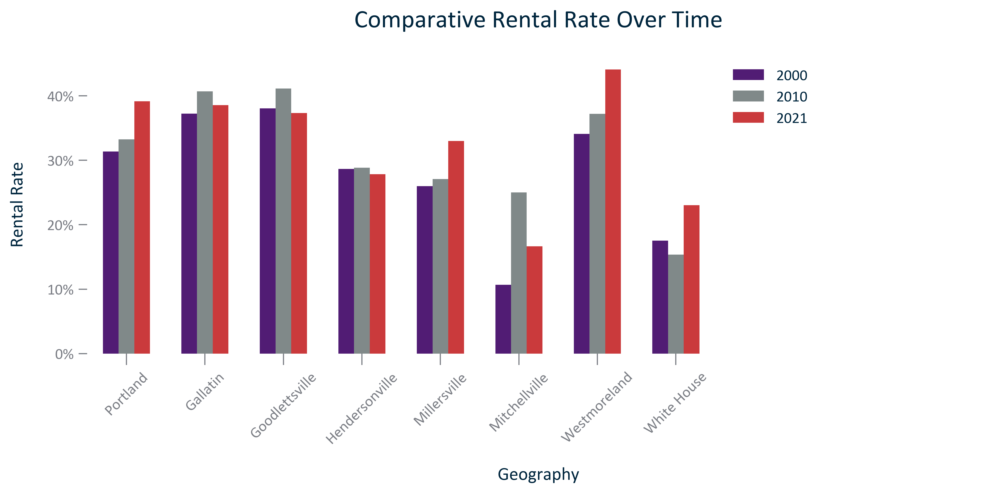

In [47]:
title = 'Comparative Rental Rate Over Time'
df_temp = reggeost.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [primarygeo] + newcols
newcols = [county] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Tenure%:Renters 2000', 'Tenure%:Renters 2010', 'Tenure%:Renters 2021']]
xlabel = 'Geography'
ylabel = 'Rental Rate'
#set up figure
xpos = np.arange(len(df_temp.index))
xlabels = df_temp.index
y1 = df_temp['Tenure%:Renters 2000']
y2 = df_temp['Tenure%:Renters 2010']
y3 = df_temp['Tenure%:Renters 2021']
width = 0.2
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width, y1, width = width, label = '2000')
bar2 = ax.bar(xpos, y2, width = width, label = '2010')
bar3 = ax.bar(xpos+width, y3, width = width, label = '2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(xlabels)
ax.set_xlim([0.5, 12])
#outside legend
ax.legend(bbox_to_anchor=(0.7, 1), loc='upper left', frameon = False)
# # #display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_rentalrate_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_rentalrate_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_rentalrate_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

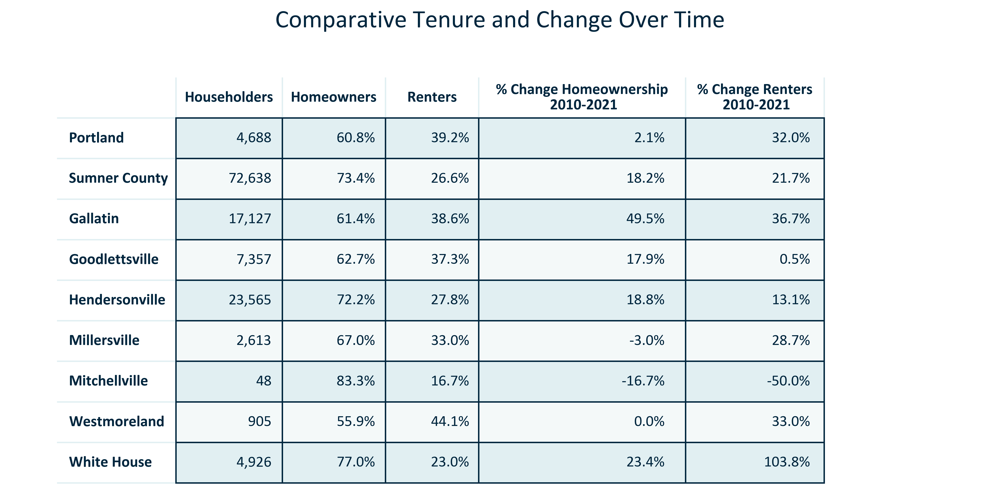

In [48]:
title = 'Comparative Tenure and Change Over Time'
#set up temporary dataframe
df_temp = reggeost.sort_values(by = 'NAME').set_index('NAME') #regular geos set up wide format
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
cols = ['Tenure:Total Households 2021','Tenure%:Owners 2021', 'Tenure%:Renters 2021', 'Tenure:Owners 2021', 
        'Tenure:Owners 2010', 'Tenure:Renters 2021', 'Tenure:Renters 2010']
df_temp = df_temp[cols]
df_temp['% Change Homeownership\n 2010-2021'] = prettypercentchange(df_temp['Tenure:Owners 2021'], df_temp['Tenure:Owners 2010'])
df_temp['% Change Renters\n 2010-2021'] = prettypercentchange(df_temp['Tenure:Renters 2021'], df_temp['Tenure:Renters 2010'])
df_temp.update(df_temp[['Tenure:Total Households 2021']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Tenure%:Owners 2021', 'Tenure%:Renters 2021']].applymap('{:,.1f}%'.format))
df_temp = df_temp.rename(columns = {'Tenure:Total Households 2021': 'Householders', 
                                    'Tenure%:Owners 2021': 'Homeowners', 
                                    'Tenure%:Renters 2021': '    Renters    '})
df_temp = df_temp[['Householders', 'Homeowners', '    Renters    ', '% Change Homeownership\n 2010-2021', '% Change Renters\n 2010-2021']]
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_table_geocomparative_tenureandchange_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_table_geocomparative_tenureandchange_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_table_geocomparative_tenureandchange_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

C:\Users\jmccall\AppData\Local\Temp\ipykernel_6348\2513189655.py:29: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1 = firstline.append(dfs)


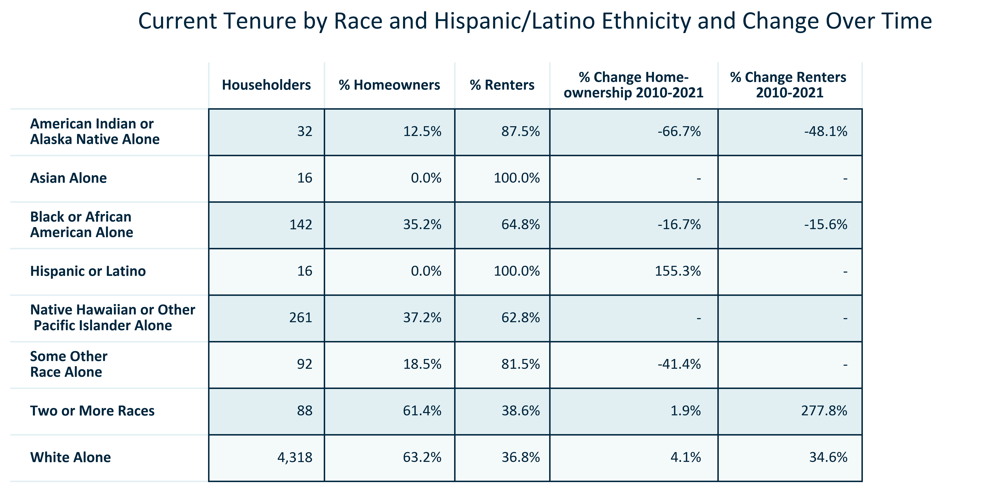

In [49]:
title = 'Current Tenure by Race and Hispanic/Latino Ethnicity and Change Over Time'
df_temp1 = Primary.loc[Primary['Year'] == 2021.0]
col_names = [' Householders ', ' % Homeowners ', '  % Renters  ']
firstline = df_temp1[['Homeownership:American Indian Alaska Native Householders', 
                     'Homeownership%:American Indian Alaska Native Householders Homeowner', 'Homeownership%:American Indian Alaska Native Householders Renters']]
firstline.columns = col_names
secondline = df_temp1[['Homeownership:Asian Householders', 'Homeownership%:Asian Householders Homeowner', 'Homeownership%:Asian Householders Renters']]
secondline.columns = col_names
thirdline = df_temp1[['Homeownership:Black or African American Householders', 'Homeownership%:Black or African American Householders Homeowner', 
                     'Homeownership%:Black or African American Householders Renters']]
thirdline.columns = col_names
fourthline = df_temp1[['Homeownership:Asian Householders', 'Homeownership%:Asian Householders Homeowner', 'Homeownership%:Asian Householders Renters']]  
fourthline = df_temp1[['Homeownership:Asian Householders', 'Homeownership%:Asian Householders Homeowner', 'Homeownership%:Asian Householders Renters']]  
fourthline.columns = col_names
fifthline = df_temp1[['Homeownership:Hispanic or Latino Householders', 'Homeownership%:Hispanic or Latino Householders Homeowner', 
                       'Homeownership%:Hispanic or Latino Householders Renters']]
fifthline.columns = col_names

sixthline = df_temp1[['Homeownership:Some Other Race Householders', 'Homeownership%:Some Other Race Householders Homeowner', 
                      'Homeownership%:Some Other Race Householders Renters']]
sixthline.columns = col_names

seventhline = df_temp1[['Homeownership:Two or More Races Householders', 'Homeownership%:Two or More Races Householders Homeowner', 
                        'Homeownership%:Two or More Races Householders Renters']] 
seventhline.columns = col_names
eighthline = df_temp1[['Homeownership:White Householders', 'Homeownership%:White Householders Homeowner', 'Homeownership%:White Householders Renters']]
eighthline.columns = col_names
dfs = [secondline, thirdline, fourthline, fifthline, sixthline, seventhline, eighthline]
df1 = firstline.append(dfs)
newindex = ['American Indian or\nAlaska Native Alone', 'Asian Alone', 'Black or African\nAmerican Alone',  'Hispanic or Latino',
            'Native Hawaiian or Other\n Pacific Islander Alone', 'Some Other\nRace Alone', 'Two or More Races', 'White Alone']
df1 = df1.set_axis(newindex)
df_temp2 = Primary.loc[Primary['Time Frame'] == '2010-2021']
df_temp2 = df_temp2[['Homeownership:American Indian Alaska Native Homeowners % Change', 'Homeownership:Asian Homeowners % Change', 
                     'Homeownership:Black or African American Homeowners % Change','Homeownership:Hispanic or Latino Homeowners % Change',
                     'Homeownership:Native Hawaiian or Other Pacific Islander Alone Homeowners % Change', 'Homeownership:Some Other Race Homeowners % Change', 
                     'Homeownership:Two or More Races Homeowners % Change', 'Homeownership:White Homeowners % Change']]
df_temp2 = df_temp2.melt(var_name = 'Race or Ethnicity', value_name = '% Change Home-\nownership 2010-2021')
df_temp2 = df_temp2.set_axis(newindex)
extracted_col = df_temp2['% Change Home-\nownership 2010-2021']
df1.insert(3, '% Change Home-\nownership 2010-2021', extracted_col)
df_temp = df1

df_temp3 = Primary.loc[Primary['Time Frame'] == '2010-2021']
df_temp3 = df_temp3[['Homeownership:American Indian Alaska Native Renters % Change', 'Homeownership:Asian Renters % Change', 
                     'Homeownership:Black or African American Renters % Change','Homeownership:Hispanic or Latino Renters % Change',
                     'Homeownership:Native Hawaiian or Other Pacific Islander Alone Renters % Change', 'Homeownership:Some Other Race Renters % Change', 
                     'Homeownership:Two or More Races Renters % Change', 'Homeownership:White Renters % Change']]
df_temp3 = df_temp3.melt(var_name = 'Race or Ethnicity', value_name = '% Change Renters \n2010-2021')
df_temp3 = df_temp3.set_axis(newindex)
extracted_col = df_temp3['% Change Renters \n2010-2021']
df1.insert(4, '% Change Renters \n2010-2021', extracted_col)
df_temp = df1

df_temp.update(df_temp[[' % Homeowners ', '  % Renters  ', '% Change Home-\nownership 2010-2021', '% Change Renters \n2010-2021']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[[' Householders ']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
# #display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_table_primarygeo_tenurebyraceandethnicity_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_table_primarygeo_tenurebyraceandethnicity_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_table_primarygeo_tenurebyraceandethnicity_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 and 2017-2021 5-Year American Community Survey Estimates')
plt.show()
plt.close();

C:\Users\jmccall\AppData\Local\Temp\ipykernel_6348\1823799437.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df1 = firstline.append(dfs)


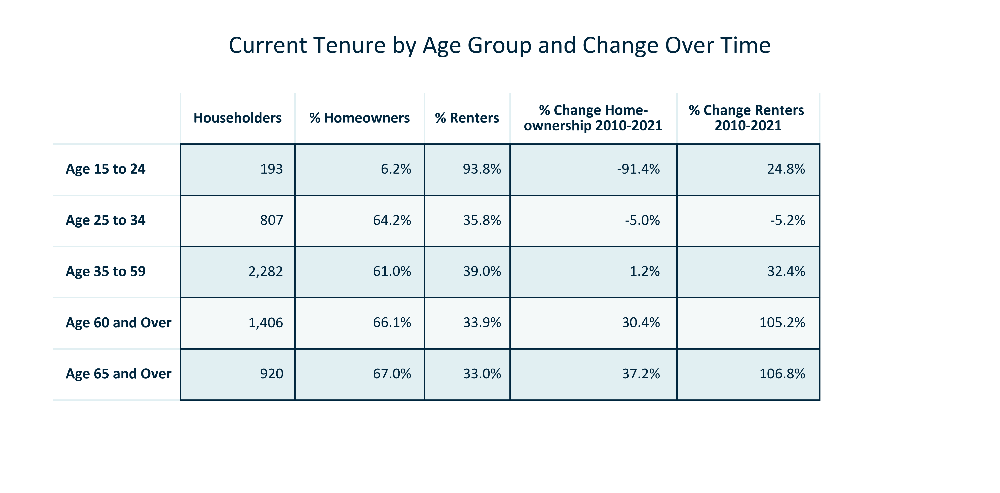

In [50]:
title = 'Current Tenure by Age Group and Change Over Time'
df_temp = Primary
df_temp1 = df_temp.loc[df_temp['Year'] == 2021.0]
col_names = [' Householders ', ' % Homeowners ', ' % Renters ']
firstline = df_temp1[['Homeownership:Householders Age 15 to 24', 'Homeownership%:Age 15 to 24 Householders Homeowners',
                      'Homeownership%:Age 15 to 24 Householders Renters']]
firstline.columns = col_names
secondline = df_temp1[['Homeownership:Householders Age 25 to 34', 'Homeownership%:Age 25 to 34 Householders Homeowners', 
                     'Homeownership%:Age 25 to 34 Householders Renters']]
secondline.columns = col_names
thirdline = df_temp1[['Homeownership:Householders Age 35 to 59', 'Homeownership%:Age 35 to 59 Householders Homeowners', 
                     'Homeownership%:Age 35 to 59 Householders Renters']]
thirdline.columns = col_names
fourthline = df_temp1[['Homeownership:Householders Age 60 and Over', 
                       'Homeownership%:Age 60 and Over Householders Homeowners', 'Homeownership%:Age 60 and Over Householders Renters']]
fourthline.columns = col_names
fifthline = df_temp1[['Homeownership:Householders Age 65 and Over', 
                     'Homeownership%:Age 65 and Over Householders Homeowners', 'Homeownership%:Age 65 and Over Householders Renters']]
fifthline.columns = col_names
dfs = [secondline, thirdline, fourthline, fifthline]
df1 = firstline.append(dfs)
newindex = ['Age 15 to 24', 'Age 25 to 34', 'Age 35 to 59', 'Age 60 and Over', 'Age 65 and Over']
df1 = df1.set_axis(newindex)
df_temp2 = df_temp.loc[df_temp['Time Frame'] == '2010-2021']
df_temp2 = df_temp2[['Homeownership:Homeowners Age 15 to 24 % Change', 'Homeownership:Homeowners Age 25 to 34 % Change', 
                     'Homeownership:Homeowners Age 35 to 59 % Change', 'Homeownership:Homeowners Age 60 and Over % Change', 
                     'Homeownership:Homeowners Age 65 and Over % Change']]
df_temp2 = df_temp2.melt(var_name = 'Age Group', value_name = '% Change Home-\nownership 2010-2021')
df_temp2 = df_temp2.set_axis(newindex)
extracted_col = df_temp2['% Change Home-\nownership 2010-2021']
df1.insert(3, '% Change Home-\nownership 2010-2021', extracted_col)
df_temp = df1

df_temp3 = Primary.loc[Primary['Time Frame'] == '2010-2021']
df_temp3 = df_temp3[['Homeownership:Renters Age 15 to 24 % Change', 
                     'Homeownership:Renters Age 25 to 34 % Change', 
                     'Homeownership:Renters Age 35 to 59 % Change', 'Homeownership:Renters Age 60 and Over % Change', 
                     'Homeownership:Renters Age 65 and Over % Change']]
df_temp3 = df_temp3.melt(var_name = 'Age Group', value_name = '% Change Renters \n2010-2021')
df_temp3 = df_temp3.set_axis(newindex)
extracted_col = df_temp3['% Change Renters \n2010-2021']
df1.insert(4, '% Change Renters \n2010-2021', extracted_col)
df_temp = df1

df_temp.update(df_temp[[' % Homeowners ', ' % Renters ', 
                        '% Change Home-\nownership 2010-2021', '% Change Renters \n2010-2021']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[[' Householders ']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.85)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_table_primarygeo_tenureandchangebyagegroup_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_table_primarygeo_tenureandchangebyagegroup_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_table_primarygeo_tenureandchangebyagegroup_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 and 2017-2021 5-Year American Community Survey Estimates')
plt.show()
plt.close();

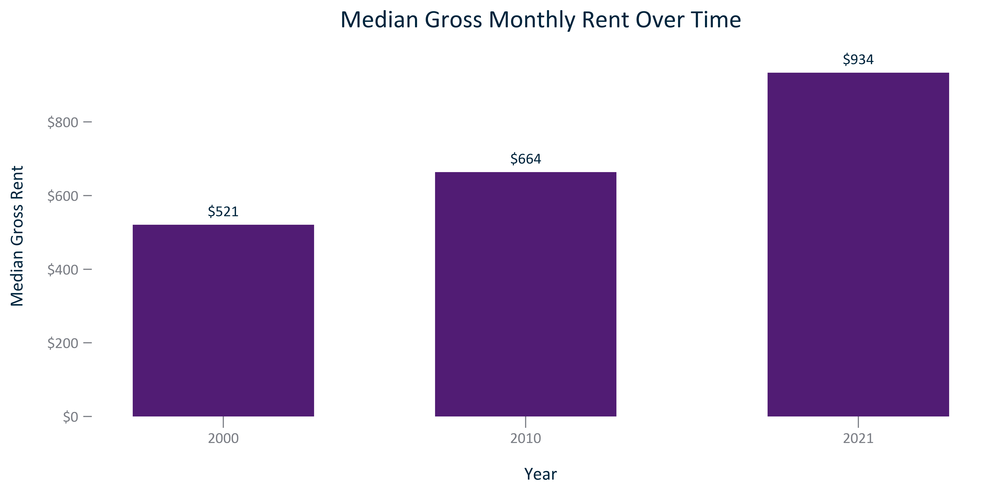

In [51]:
title = 'Median Gross Monthly Rent Over Time' #set title of figure
#set up temporary dataframe
xinput = 'Year'
yinput = 'Median Gross Rent'
df_temp = Primary[Primary['Time Frame'] == 'None']
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = xinput
ylabel = yinput
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.xaxis.set_major_formatter(ticker.FormatStrFormatter(yearformat)) #x axis formatting
#ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentformatnodecimal)) #y axis formatting
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
singledatalabels(0, 6, "${:,.0f}")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_mediangrossrent_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_mediangrossrent_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_primarygeo_mediangrossrent_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5 Year Estimates')
plt.show()
plt.close();

In [53]:
def doubledatalabels(xoffset1, yoffset1, xoffset2, yoffset2, labelformat, size):
    for j, k in zip(xpos, y1):
        label = labelformat.format(k)
        ax.annotate(label, (j, k), textcoords = 'offset points', xytext = (xoffset1, yoffset1), fontsize = size, ha = 'center')
    for j, k in zip(xpos, y2):
        label = labelformat.format(k)
        ax.annotate(label, (j, k), textcoords = 'offset points', xytext = (xoffset2, yoffset2), fontsize = size, ha = 'center')

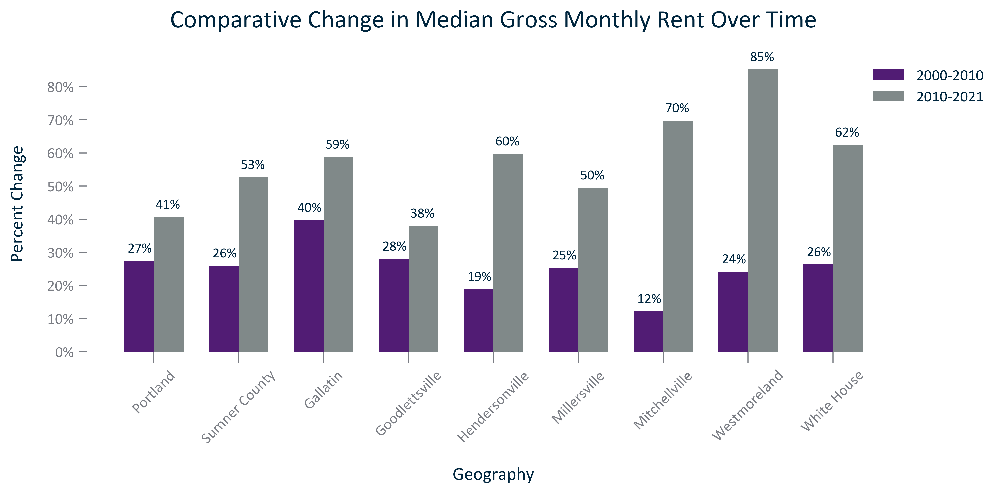

In [55]:
title = 'Comparative Change in Median Gross Monthly Rent Over Time'
df_temp = reggeos.loc[(reggeos['Time Frame'] != '2000-2021') & (reggeos['Time Frame'] != 'None')]
df_temp = df_temp.loc[df_temp['NAME'] != 'GNRC Region']
df_temp = df_temp[['NAME', 'Time Frame','Median Gross Rent % Change']]
df_temp = df_temp.set_index(['Time Frame', 'NAME'])
df_temp = df_temp.unstack(['Time Frame'])
df_temp.columns = ['{} {}'.format(t, v) for v,t in df_temp.columns]
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
xlabel = 'Geography'
ylabel = 'Percent Change'

xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010 Median Gross Rent % Change']
y2 = df_temp['2010-2021 Median Gross Rent % Change']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')

ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)

#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)
#data labels
doubledatalabels(-10, 6, 10, 6, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemediangrossrent_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemediangrossrent_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemediangrossrent_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

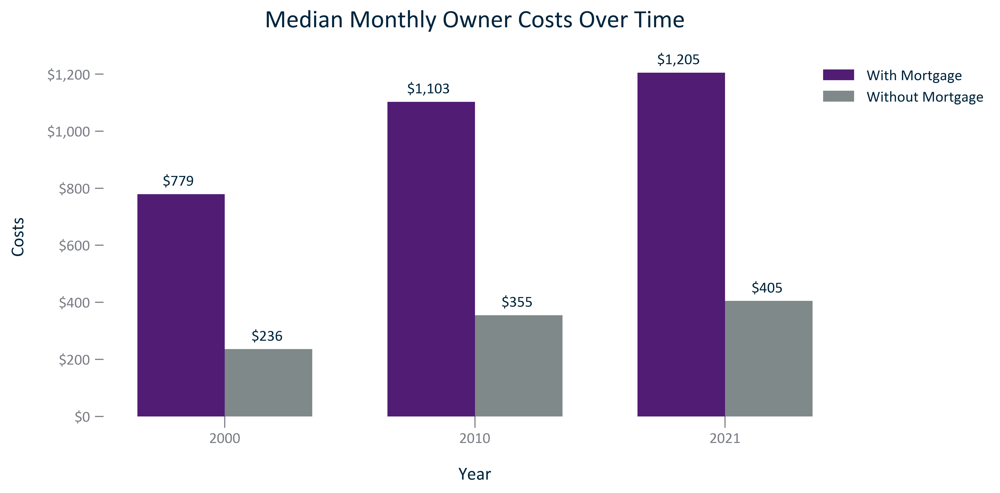

In [56]:
title = 'Median Monthly Owner Costs Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['Year', 'Median Monthly Owner Costs Home with Mortgage', 'Median Monthly Owner Costs Home without Mortgage']]
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.set_index(['Year'])
xlabel = 'Year'
ylabel = 'Costs'
#figure
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['Median Monthly Owner Costs Home with Mortgage']
y2 = df_temp['Median Monthly Owner Costs Home without Mortgage']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = 'With Mortgage')
bar2 = ax.bar(xpos+width/2, y2, width, label = 'Without Mortgage')
ax.xaxis.set_major_formatter(ticker.FormatStrFormatter(yearformat)) #x axis formatting
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)
#data labels
doubledatalabels(-33, 6, 30, 6, "${:,.0f}", SMALL_SIZE)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_ownercostsbymortgagestatus_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_ownercostsbymortgagestatus_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_ownercostsbymortgagestatus_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

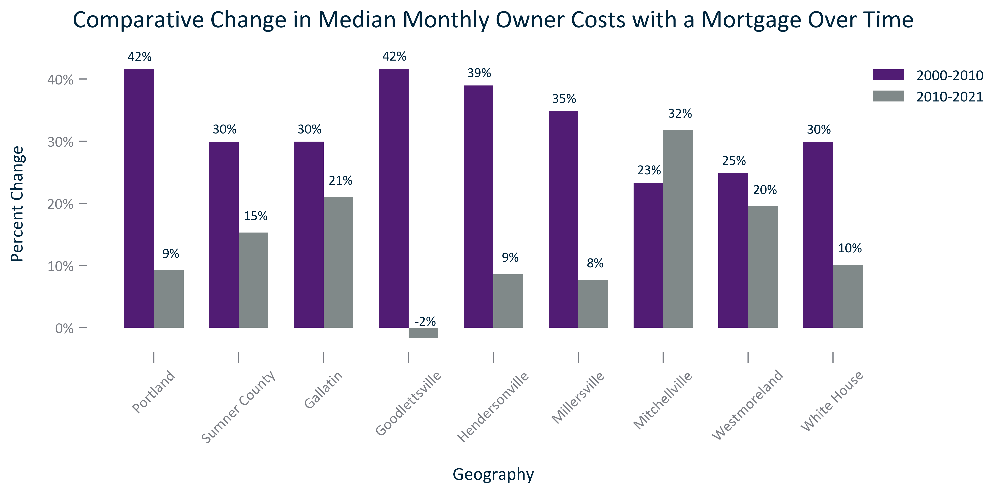

In [57]:
title = 'Comparative Change in Median Monthly Owner Costs with a Mortgage Over Time'
df_temp = reggeos.loc[(reggeos['Time Frame'] != '2000-2021') & (reggeos['Time Frame'] != 'None')]
df_temp = df_temp.loc[df_temp['NAME'] != 'GNRC Region']
df_temp = df_temp[['NAME', 'Time Frame','Median Monthly Owner Costs Home with Mortgage % Change']]
df_temp = df_temp.set_index(['Time Frame', 'NAME'])
df_temp = df_temp.unstack(['Time Frame'])
df_temp.columns = ['{} {}'.format(t, v) for v,t in df_temp.columns]
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
xlabel = 'Geography'
ylabel = 'Percent Change'

xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010 Median Monthly Owner Costs Home with Mortgage % Change']
y2 = df_temp['2010-2021 Median Monthly Owner Costs Home with Mortgage % Change']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')

ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)

#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-10, 6, 12, 9, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemedianownerwithmortgagecost_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemedianownerwithmortgagecost_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemedianownerwithmortgagecost_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

title = 'Median Value of Owner-Occcupied Housing Over Time'
#set up temporary dataframe
xinput = 'Year'
yinput = 'Median Home Value Owner Occupied'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = xinput
ylabel = 'Median Home Value'
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.xaxis.set_major_formatter(ticker.FormatStrFormatter(yearformat)) #x axis formatting
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
singledatalabels(0, 6, "${:,.0f}")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_valueowneroccupiedhousing_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_valueowneroccupiedhousing_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_primarygeo_valueowneroccupiedhousing_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

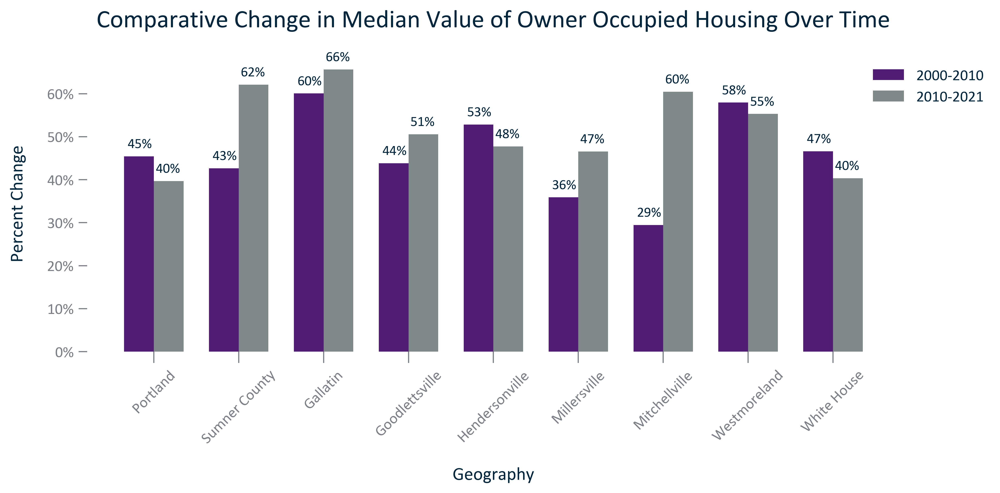

In [58]:
title = 'Comparative Change in Median Value of Owner Occupied Housing Over Time'
df_temp = reggeos.loc[(reggeos['Time Frame'] != '2000-2021') & (reggeos['Time Frame'] != 'None')]
df_temp = df_temp.loc[df_temp['NAME'] != 'GNRC Region']
df_temp = df_temp[['NAME', 'Time Frame','Median Home Value Owner Occupied % Change']]
df_temp = df_temp.set_index(['Time Frame', 'NAME'])
df_temp = df_temp.unstack(['Time Frame'])
df_temp.columns = ['{} {}'.format(t, v) for v,t in df_temp.columns]
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
xlabel = 'Geography'
ylabel = 'Percent Change'

xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010 Median Home Value Owner Occupied % Change']
y2 = df_temp['2010-2021 Median Home Value Owner Occupied % Change']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')

ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)

#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)
#data labels
doubledatalabels(-10, 6, 10, 6, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemedianhomevalueowneroccupied_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemedianhomevalueowneroccupied_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_clusterbar_geocomparative_changemedianhomevalueowneroccupied_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

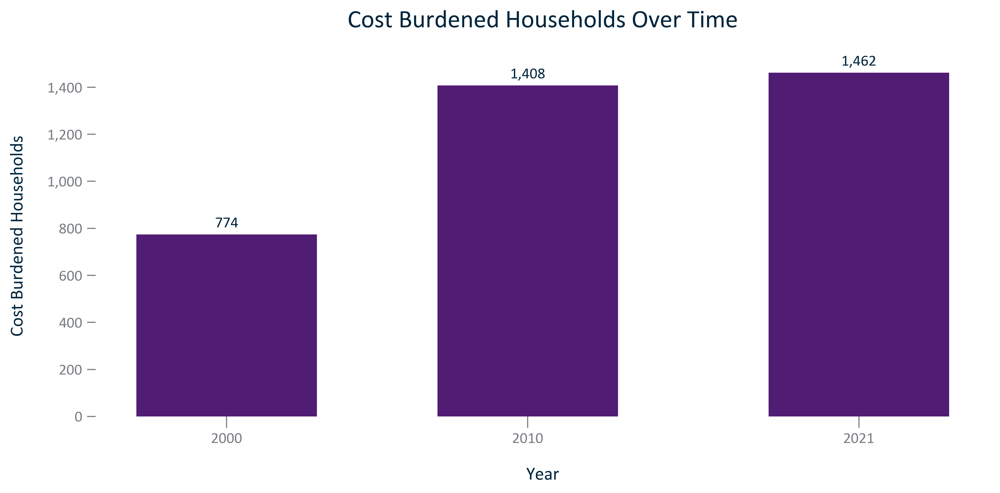

In [59]:
title = 'Cost Burdened Households Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'CB:Cost Burdened Households']]
xinput = 'Year'
yinput = 'CB:Cost Burdened Households'
xlabel = xinput
ylabel = 'Cost Burdened Households'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedhouseholds_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedhouseholds_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedhouseholds_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

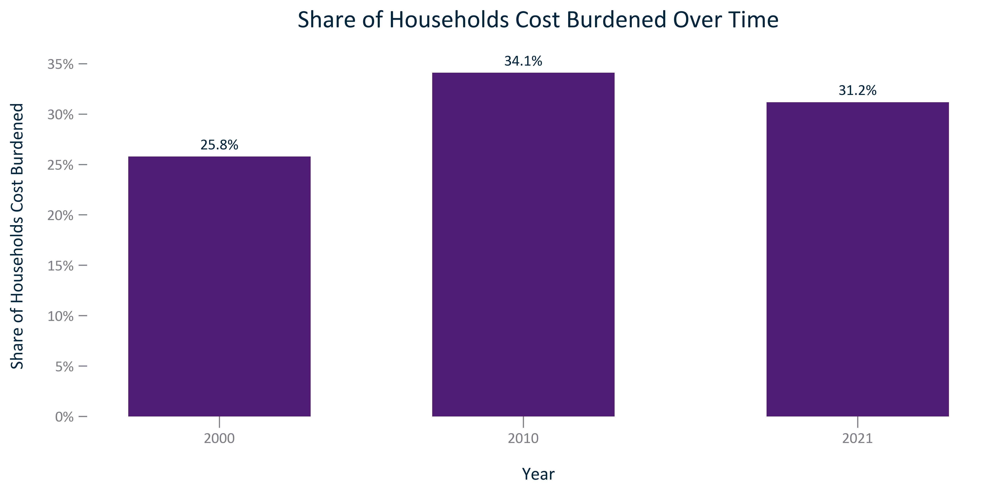

In [60]:
title = 'Share of Households Cost Burdened Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'CB%:Cost Burdened Households']]
xinput = 'Year'
yinput = 'CB%:Cost Burdened Households'
xlabel = xinput
ylabel = 'Share of Households Cost Burdened'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.1f}%")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_sharehouseholdscostburdened_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_sharehouseholdscostburdened_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_primarygeo_sharehouseholdscostburdened_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

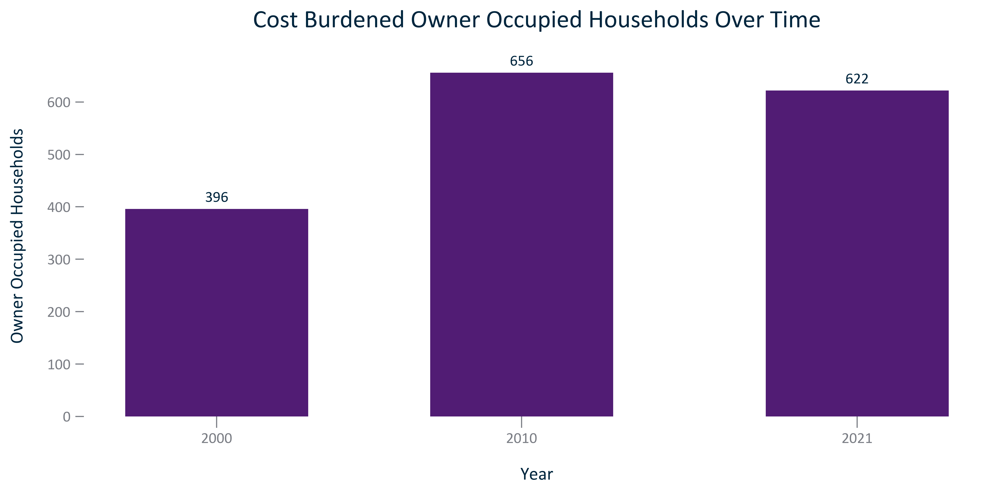

In [61]:
title = 'Cost Burdened Owner Occupied Households Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'CB:Cost Burdened Homeowners']]
xinput = 'Year'
yinput = 'CB:Cost Burdened Homeowners'
xlabel = xinput
ylabel = 'Owner Occupied Households'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedownerocchouseholds_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedownerocchouseholds_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedownerocchouseholds_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

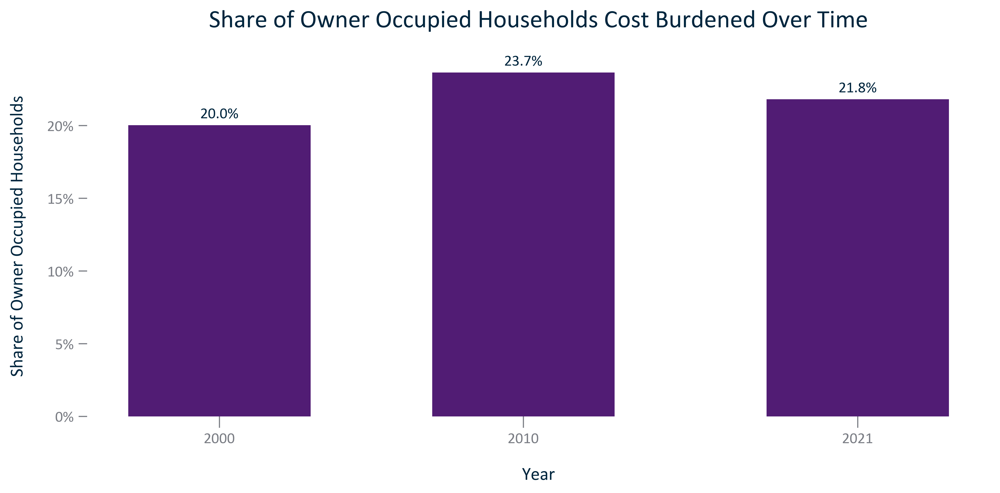

In [62]:
title = 'Share of Owner Occupied Households Cost Burdened Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'CB%: Cost Burdened Homeowners']]
xinput = 'Year'
yinput = 'CB%: Cost Burdened Homeowners'
xlabel = xinput
ylabel = 'Share of Owner Occupied Households'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.1f}%")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_shareownerocchouseholdscostburdened_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_shareownerocchouseholdscostburdened_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_primarygeo_shareownerocchouseholdscostburdened_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

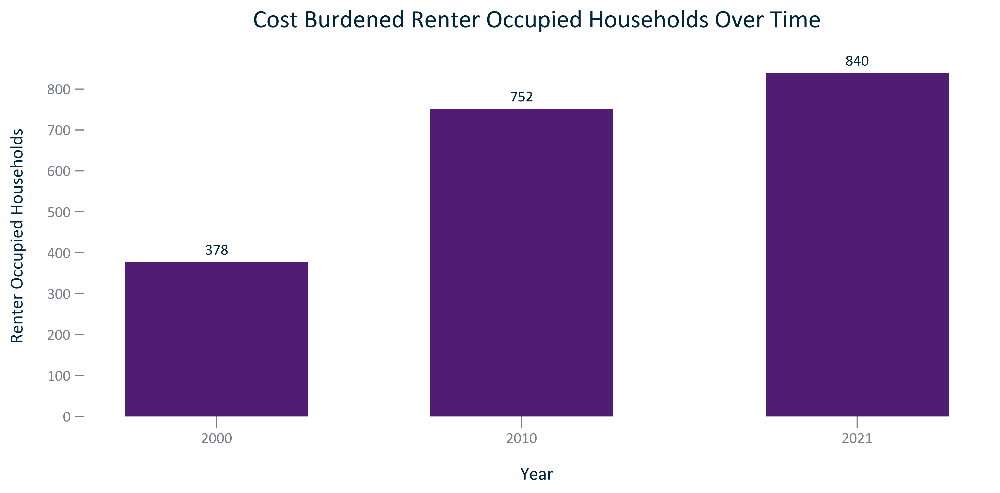

In [63]:
title = 'Cost Burdened Renter Occupied Households Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'CB:Cost Burdened Renters']]
xinput = 'Year'
yinput = 'CB:Cost Burdened Renters'
xlabel = xinput
ylabel = 'Renter Occupied Households'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedrenterocchouseholds_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedrenterocchouseholds_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_primarygeo_costburdenedrenterocchouseholds_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

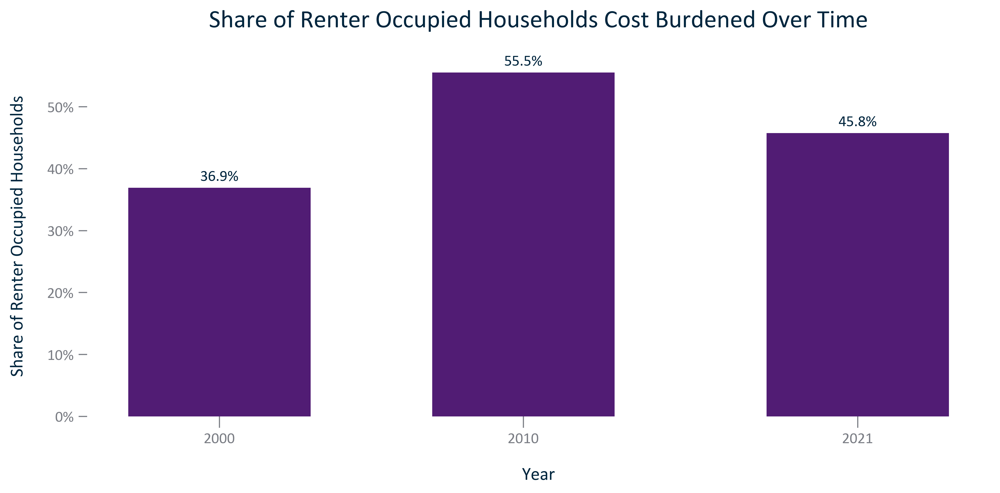

In [64]:
title = 'Share of Renter Occupied Households Cost Burdened Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'CB%:Cost Burdened Renters']]
xinput = 'Year'
yinput = 'CB%:Cost Burdened Renters'
xlabel = xinput
ylabel = 'Share of Renter Occupied Households'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.1f}%")
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_sharerenterocchouseholdscostburdened_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_bar_primarygeo_sharerenterocchouseholdscostburdened_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_bar_primarygeo_sharerenterocchouseholdscostburdened_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

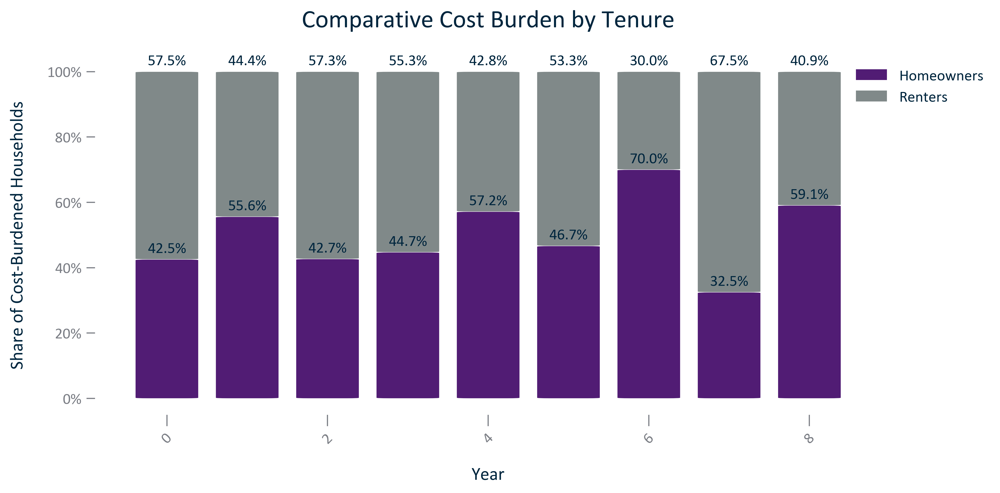

In [65]:
title = 'Comparative Cost Burden by Tenure'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['CB%:Cost Burdened Households Homeowners', 'CB%:Cost Burdened Households Renters']]
df_temp = df_temp.rename(columns = {'CB%:Cost Burdened Households Homeowners': 'Homeowners', 
                                    'CB%:Cost Burdened Households Renters': 'Renters'})
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Cost-Burdened Households') #set the title and axes labels
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_stackedbar_geocomparative_costburdenbytenure_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_stackedbar_geocomparative_costburdenbytenure_2021.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_stackedbar_geocomparative_costburdenbytenure_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

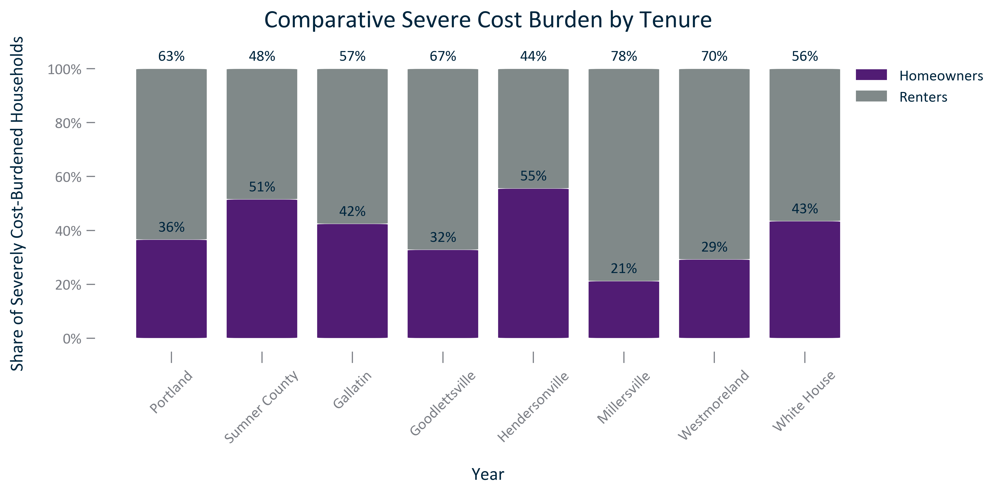

In [66]:
title = 'Comparative Severe Cost Burden by Tenure'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp.loc[df_temp['NAME'] != 'Mitchellville']
df_temp = df_temp[['NAME','CB%:Severe Cost Burdened Households Homeowners', 'CB%:Severe Cost Burdened Households Renters']]
df_temp = df_temp.rename(columns = {'CB%:Severe Cost Burdened Households Homeowners': 'Homeowners', 
                                    'CB%:Severe Cost Burdened Households Renters': 'Renters'})
df_temp = df_temp.set_index('NAME')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Severely Cost-Burdened Households') #set the title and axes labels
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#outside legend
ax.legend(bbox_to_anchor=(.95, 1), loc='upper left', frameon = False)
y_offset = -6
# For each patch (basically each rectangle within the bar), add a label.
for bar in ax.patches:
    ax.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + bar.get_y() + 3, str(int(round(bar.get_height(), 1))) + '%', ha='center')
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_stackedbar_geocomparative_severecostburdenbytenure_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_stackedbar_geocomparative_severecostburdenbytenure_2021.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_stackedbar_geocomparative_severecostburdenbytenure_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

C:\Users\jmccall\AppData\Local\Temp\ipykernel_6348\481488997.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp1.append(dfs)


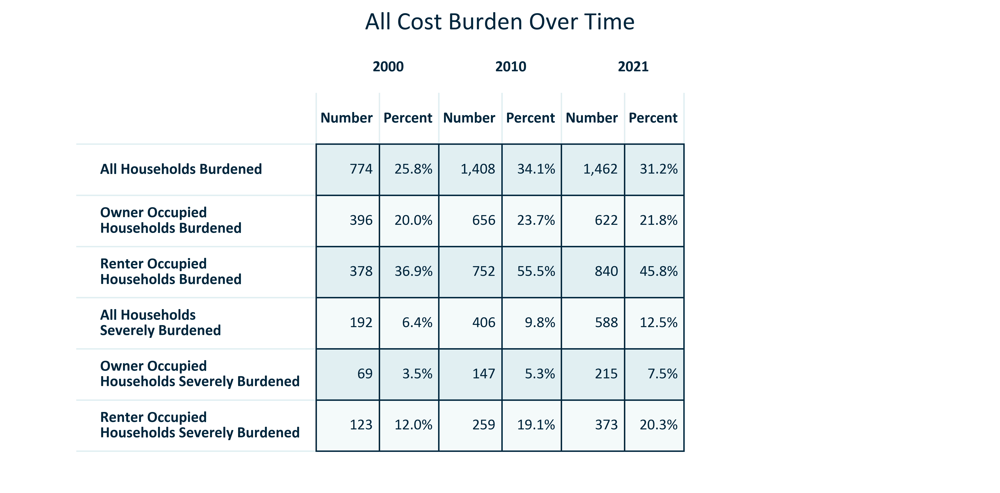

In [67]:
title = 'All Cost Burden Over Time'
#set up temporary dataframe
df_temp = Primaryt
next_line = ['Number2000', 'Percent2000', 'Number2010', 'Percent2010', 'Number2021', 'Percent2021']
df_temp1 = df_temp[['CB:Cost Burdened Households 2000', 'CB%:Cost Burdened Households 2000',
                    'CB:Cost Burdened Households 2010', 'CB%:Cost Burdened Households 2010',
                    'CB:Cost Burdened Households 2021', 'CB%:Cost Burdened Households 2021']]
df_temp1.columns = next_line
df_temp2 = df_temp[['CB:Severe Cost Burdened Households 2000', 'CB%:Severe Cost Burdened Households 2000',
                    'CB:Severe Cost Burdened Households 2010', 'CB%:Severe Cost Burdened Households 2010',
                    'CB:Severe Cost Burdened Households 2021', 'CB%:Severe Cost Burdened Households 2021']]
df_temp2.columns = next_line
df_temp3 = df_temp[['CB:Cost Burdened Homeowners 2000', 'CB%: Cost Burdened Homeowners 2000',
                    'CB:Cost Burdened Homeowners 2010', 'CB%: Cost Burdened Homeowners 2010',
                    'CB:Cost Burdened Homeowners 2021', 'CB%: Cost Burdened Homeowners 2021']]
df_temp3.columns = next_line
df_temp4 = df_temp[['CB:Severe Cost Burdened Homeowners 2000', 'CB%:Severe Cost Burdened Homeowners 2000',
                    'CB:Severe Cost Burdened Homeowners 2010', 'CB%:Severe Cost Burdened Homeowners 2010',
                    'CB:Severe Cost Burdened Homeowners 2021', 'CB%:Severe Cost Burdened Homeowners 2021']]
df_temp4.columns = next_line
df_temp5 = df_temp[['CB:Cost Burdened Renters 2000', 'CB%:Cost Burdened Renters 2000',
                    'CB:Cost Burdened Renters 2010', 'CB%:Cost Burdened Renters 2010',
                    'CB:Cost Burdened Renters 2021', 'CB%:Cost Burdened Renters 2021']]
df_temp5.columns = next_line
df_temp6 = df_temp[['CB:Severe Cost Burdened Renters 2000', 'CB%:Severe Cost Burdened Renters 2000',
                    'CB:Severe Cost Burdened Renters 2010', 'CB%:Severe Cost Burdened Renters 2010',
                    'CB:Severe Cost Burdened Renters 2021', 'CB%:Severe Cost Burdened Renters 2021']]
df_temp6.columns = next_line
dfs = [df_temp3, df_temp5, df_temp2, df_temp4, df_temp6]
df_temp = df_temp1.append(dfs)
newindex = ['All Households Burdened', 'Owner Occupied \nHouseholds Burdened', 'Renter Occupied \nHouseholds Burdened',  
            'All Households \nSeverely Burdened', 'Owner Occupied \nHouseholds Severely Burdened', 'Renter Occupied \nHouseholds Severely Burdened']
df_temp = df_temp.set_axis(newindex)
#df_temp = df_temp.sort_values(by = 'Number2000', ascending = False)
df_temp.update(df_temp[['Number2000', 'Number2010', 'Number2021']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Percent2000', 'Percent2010', 'Percent2021']].applymap('{:.1f}%'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#groups
col_names = ['Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['2000','', '2010', '', '2021', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.9)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/TENURECOST/TENURECOST_table_primarygeo_allcostburdennumberandpercent_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_table_primarygeo_allcostburdennumberandpercent_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_table_primarygeo_allcostburdennumberandpercent_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

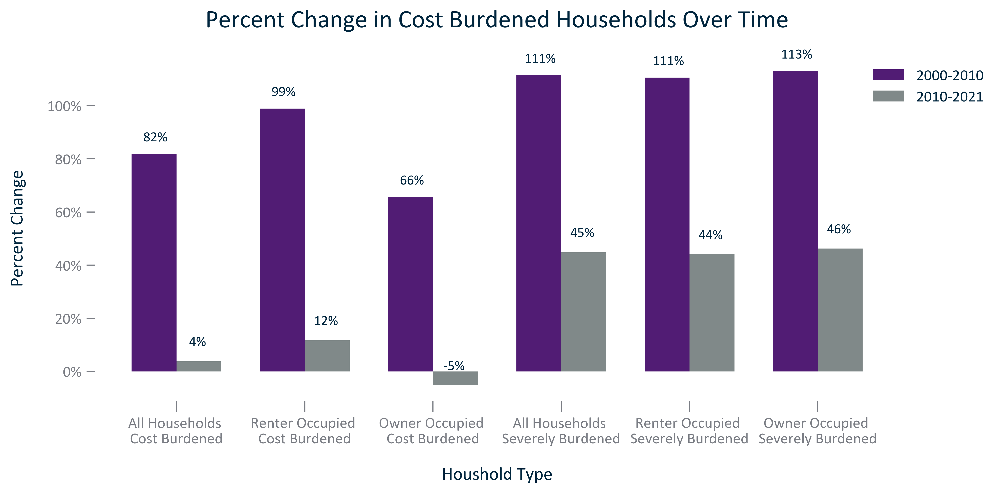

In [68]:
title = 'Percent Change in Cost Burdened Households Over Time'
df_temp = Primary.loc[Primary['Time Frame'] != 'None']
df_temp = df_temp.loc[df_temp['Time Frame'] != '2000-2021']
df_temp = df_temp[['Time Frame','CB:Cost Burdened Households % Change', 'CB:Cost Burdened Renters % Change', 'CB:Cost Burdened Homeowners % Change',
                   'CB:Severe Cost Burdened Households % Change', 'CB:Severe Cost Burdened Renters % Change', 
                   'CB:Severe Cost Burdened Homeowners % Change']]
df_temp = df_temp.rename(columns = {'CB:Cost Burdened Households % Change': 'All Households \nCost Burdened', 
                                    'CB:Severe Cost Burdened Households % Change': 'All Households \nSeverely Burdened', 
                                    'CB:Cost Burdened Homeowners % Change': 'Owner Occupied \nCost Burdened', 
                                    'CB:Severe Cost Burdened Homeowners % Change': 'Owner Occupied \nSeverely Burdened', 
                                    'CB:Cost Burdened Renters % Change': 'Renter Occupied \nCost Burdened', 
                                    'CB:Severe Cost Burdened Renters % Change': 'Renter Occupied \nSeverely Burdened'})
df_temp = df_temp.set_index('Time Frame')
df_temp = df_temp.transpose()
#df_temp = df_temp.sort_values(by = '2000-2010', ascending = False)
xlabel = 'Houshold Type'
ylabel = 'Percent Change'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2021']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-15, 9, 15, 11, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_allcostburdenpercentchange_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_allcostburdenpercentchange_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_allcostburdenpercentchange_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

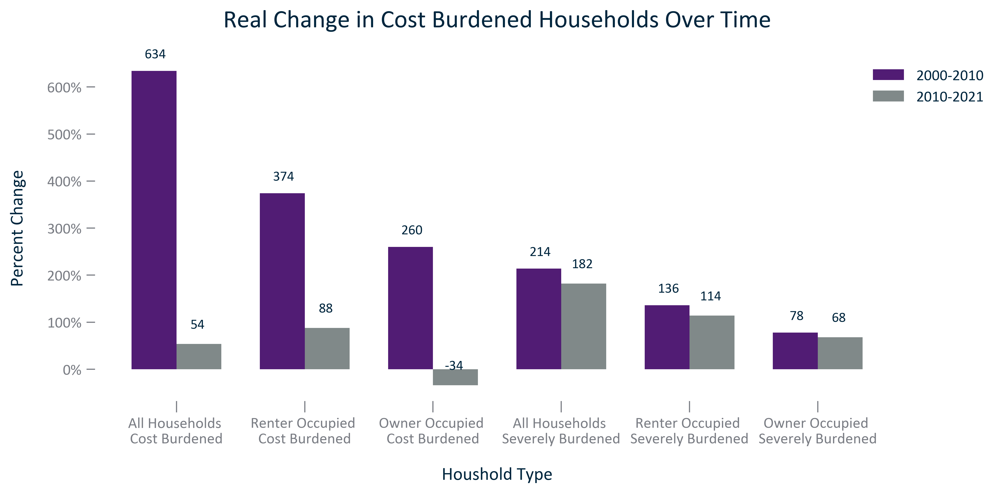

In [69]:
title = 'Real Change in Cost Burdened Households Over Time'
df_temp = Primary.loc[Primary['Time Frame'] != 'None']
df_temp = df_temp.loc[df_temp['Time Frame'] != '2000-2021']
df_temp = df_temp[['Time Frame','CB:Cost Burdened Households Change', 'CB:Severe Cost Burdened Households Change', 'CB:Cost Burdened Homeowners Change', 
                   'CB:Severe Cost Burdened Homeowners Change', 'CB:Cost Burdened Renters Change', 'CB:Severe Cost Burdened Renters Change']]
df_temp = df_temp.rename(columns = {'CB:Cost Burdened Households Change': 'All Households \nCost Burdened', 
                                    'CB:Severe Cost Burdened Households Change': 'All Households \nSeverely Burdened', 
                                    'CB:Cost Burdened Homeowners Change': 'Owner Occupied \nCost Burdened', 
                                    'CB:Severe Cost Burdened Homeowners Change': 'Owner Occupied \nSeverely Burdened', 
                                    'CB:Cost Burdened Renters Change': 'Renter Occupied \nCost Burdened', 
                                    'CB:Severe Cost Burdened Renters Change': 'Renter Occupied \nSeverely Burdened'})
df_temp = df_temp.set_index('Time Frame')
df_temp = df_temp.transpose()
df_temp = df_temp.sort_values(by = '2000-2010', ascending = False)
xlabel = 'Houshold Type'
ylabel = 'Percent Change'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2021']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-15, 9, 15, 11, "{:,.0f}", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_allcostburdenrealchange_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_allcostburdenrealchange_overtime.png', bbox_inches='tight')
with open('../Figures/TENURECOST/TENURECOST_clusterbar_primarygeo_allcostburdenrealchange_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

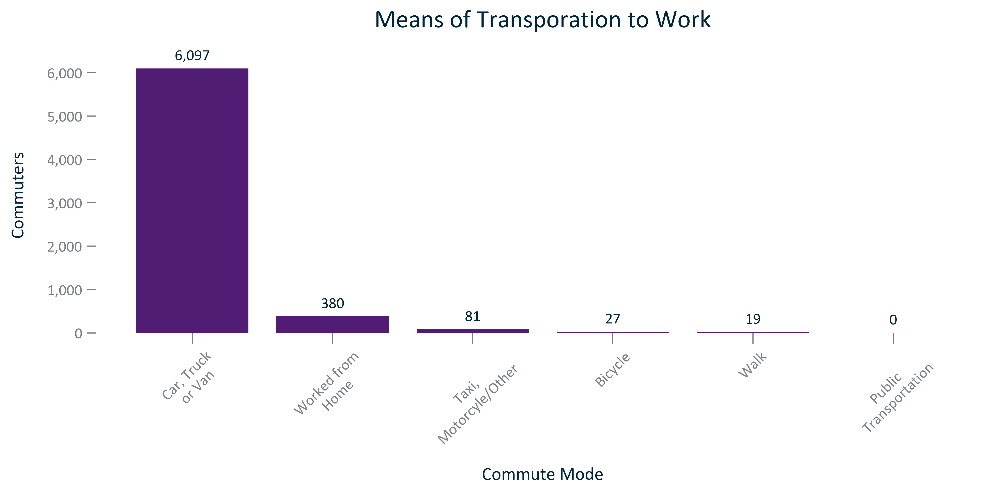

In [70]:
title = 'Means of Transporation to Work'
#set up temporary dataframe
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Transpo:Car, Truck, or Van', 'Transpo:Public Transportation', 'Transpo:Bicycle',
                   'Transpo:Walk', 'Transpo:Worked From Home', 'Transpo:Taxi, Motorcycle, Other']]
df_temp = df_temp.rename(columns = {'Transpo:Car, Truck, or Van': 'Car, Truck\nor Van', 'Transpo:Public Transportation': 'Public \nTransportation', 
                                    'Transpo:Bicycle': 'Bicycle', 'Transpo:Walk': 'Walk', 'Transpo:Worked From Home': 'Worked from\nHome',
                                    'Transpo:Taxi, Motorcycle, Other': 'Taxi,\nMotorcyle/Other'})
df_temp = df_temp.melt(var_name = 'Commute Mode', value_name = 'Commuters')
df_temp = df_temp.sort_values(by = 'Commuters', ascending = False)
#initiate figure and set parameters
x = df_temp['Commute Mode']
y = df_temp['Commuters']
xlabel = 'Commute Mode'
ylabel = 'Commuters'
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 6, "{:,.0f}")
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_meansoftransportationtowork_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_meansoftransportationtowork_2021.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_bar_primarygeo_meansoftransportationtowork_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')

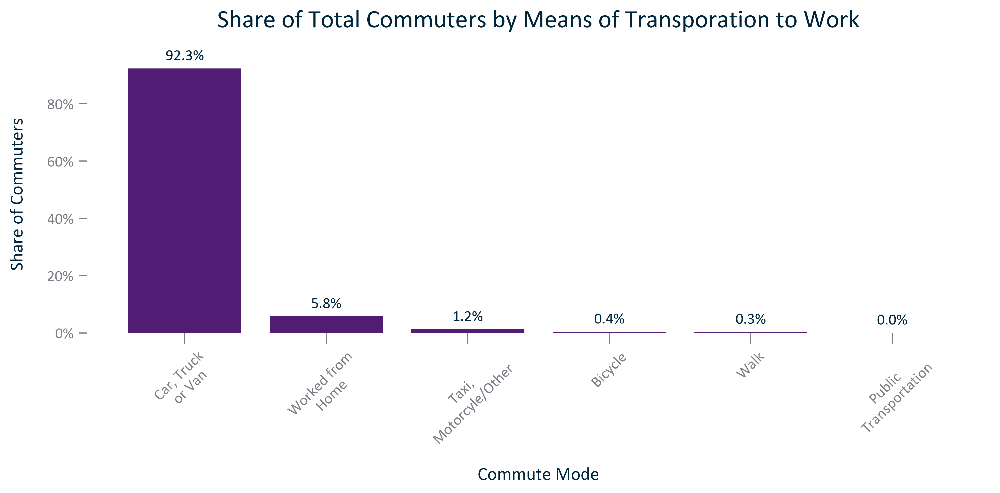

In [71]:
title = 'Share of Total Commuters by Means of Transporation to Work'
#set up temporary dataframe
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Transpo%:Car, Truck, or Van', 'Transpo%:Public Transportation', 'Transpo%:Bicycle',
                   'Transpo%:Walk', 'Transpo%:Worked From Home', 'Transpo%:Taxi, Motorcycle, Other']]
df_temp = df_temp.rename(columns = {'Transpo%:Car, Truck, or Van': 'Car, Truck\nor Van', 'Transpo%:Public Transportation': 'Public \nTransportation', 
                                    'Transpo%:Bicycle': 'Bicycle', 'Transpo%:Walk': 'Walk', 'Transpo%:Worked From Home': 'Worked from\nHome',
                                    'Transpo%:Taxi, Motorcycle, Other': 'Taxi,\nMotorcyle/Other'})
df_temp = df_temp.melt(var_name = 'Commute Mode', value_name = 'Commuters')
df_temp = df_temp.sort_values(by = 'Commuters', ascending = False)
#initiate figure and set parameters
x = df_temp['Commute Mode']
y = df_temp['Commuters']
xlabel = 'Commute Mode'
ylabel = 'Share of Commuters'
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 6, "{:,.1f}%")
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_sharemeansoftransportationtowork_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_sharemeansoftransportationtowork_2021.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_bar_primarygeo_sharemeansoftransportationtowork_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')

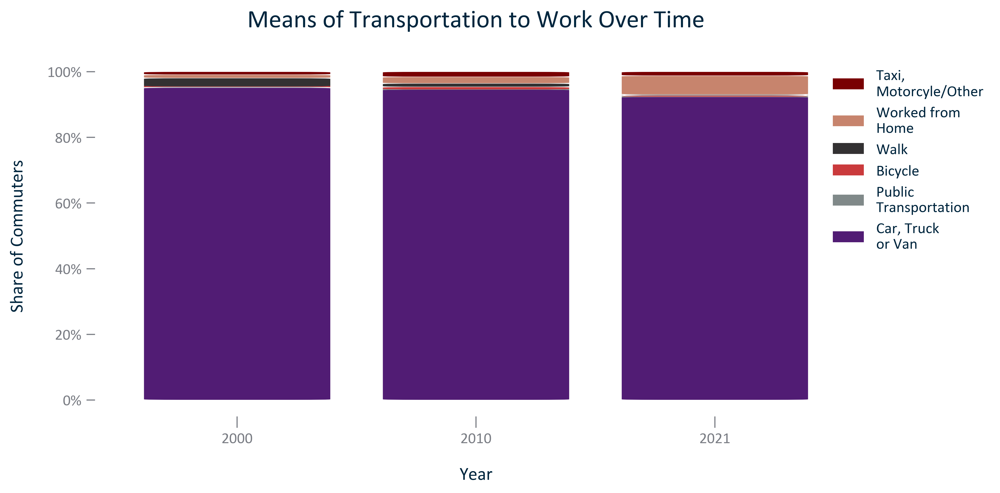

In [72]:
title = 'Means of Transportation to Work Over Time'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year', 'Transpo%:Car, Truck, or Van', 'Transpo%:Public Transportation', 'Transpo%:Bicycle',
                   'Transpo%:Walk', 'Transpo%:Worked From Home', 'Transpo%:Taxi, Motorcycle, Other']]
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.rename(columns = {'Transpo%:Car, Truck, or Van': 'Car, Truck\nor Van', 'Transpo%:Public Transportation': 'Public \nTransportation', 
                                    'Transpo%:Bicycle': 'Bicycle', 'Transpo%:Walk': 'Walk', 'Transpo%:Worked From Home': 'Worked from\nHome',
                                    'Transpo%:Taxi, Motorcycle, Other': 'Taxi,\nMotorcyle/Other'})
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Commuters') #set the title and axes labels
ax.tick_params(axis = 'x', which = 'major')
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
y_offset = -6
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_stackedbar_primarygeo_sharecommutemodes_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_stackedbar_primarygeo_sharecommutemodes_overtime.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_stackedbar_primarygeo_sharecommutemodes_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

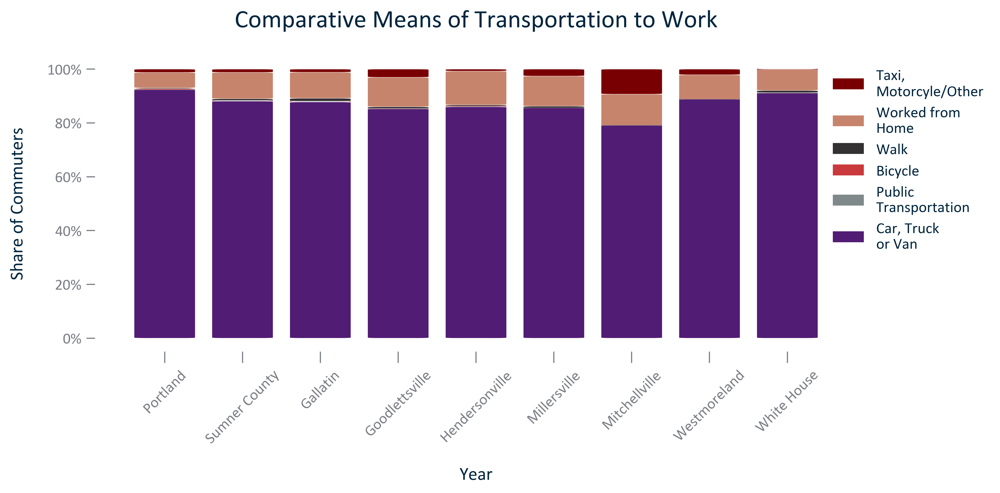

In [73]:
title = 'Comparative Means of Transportation to Work'
df_temp = reggeos.loc[reggeos['Year'] == 2021.0]
df_temp = df_temp[['NAME', 'Transpo%:Car, Truck, or Van', 'Transpo%:Public Transportation', 'Transpo%:Bicycle',
                   'Transpo%:Walk', 'Transpo%:Worked From Home', 'Transpo%:Taxi, Motorcycle, Other']]
df_temp = df_temp.rename(columns = {'Transpo%:Car, Truck, or Van': 'Car, Truck\nor Van', 'Transpo%:Public Transportation': 'Public \nTransportation', 
                                    'Transpo%:Bicycle': 'Bicycle', 'Transpo%:Walk': 'Walk', 'Transpo%:Worked From Home': 'Worked from\nHome',
                                    'Transpo%:Taxi, Motorcycle, Other': 'Taxi,\nMotorcyle/Other'})
df_temp = df_temp.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Commuters') #set the title and axes labels
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
y_offset = -6
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_stackedbar_geocomparative_sharecommutemodes_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_stackedbar_geocomparative_sharecommutemodes_2021.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_stackedbar_geocomparative_sharecommutemodes_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

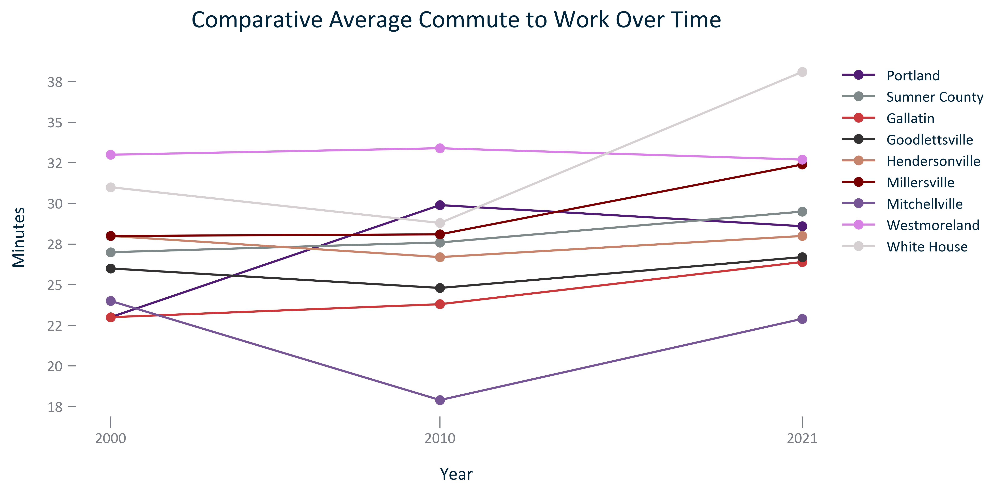

In [74]:
title = 'Comparative Average Commute to Work Over Time'
#set up temporary dataframe
xinput = 'Year'
yinput = 'Mean Travel Time to Work'
df_temp0 = Hendersonville
linelabel0 = str(df_temp0['NAME'].values[0])
x0 = df_temp0[xinput]
y0 = df_temp0[yinput]
df_temp1 = Gallatin
linelabel1 = str(df_temp1['NAME'].values[0])
x1 = df_temp1[xinput]
y1 = df_temp1[yinput]
df_temp2 = Goodlettsville
linelabel2 = str(df_temp2['NAME'].values[0])
x2 = df_temp2[xinput]
y2 = df_temp2[yinput]
df_temp3 = Primary
linelabel3 = str(df_temp3['NAME'].values[0])
x3 = df_temp3[xinput]
y3 = df_temp3[yinput]
df_temp4 = WhiteHouse
linelabel4 = str(df_temp4['NAME'].values[0])
x4 = df_temp4[xinput]
y4 = df_temp4[yinput]
df_temp5 = Millersville
linelabel5 = str(df_temp5['NAME'].values[0])
x5 = df_temp5[xinput]
y5 = df_temp5[yinput]
df_temp6 = Westmoreland
linelabel6 = str(df_temp6['NAME'].values[0])
x6 = df_temp6[xinput]
y6 = df_temp6[yinput]
df_temp7 = Mitchellville
linelabel7 = str(df_temp7['NAME'].values[0])
x7 = df_temp7[xinput]
y7 = df_temp7[yinput]
df_temp8 = County
linelabel8 = str(df_temp8['NAME'].values[0])
x8 = df_temp8[xinput]
y8 = df_temp8[yinput]
#initiate figure and add lines and parameters
fig, ax = plt.subplots()
ax.plot(x3, y3,  label = linelabel3)
ax.plot(x8, y8,  label = linelabel8)
ax.plot(x1, y1,  label = linelabel1)
ax.plot(x2, y2,  label = linelabel2)
ax.plot(x0, y0,  label = linelabel0)
ax.plot(x5, y5,  label = linelabel5)
ax.plot(x7, y7,  label = linelabel7)
ax.plot(x6, y6,  label = linelabel6)
ax.plot(x4, y4,  label = linelabel4)
ax.set(title = title, xlabel = xinput, ylabel = 'Minutes')
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks([2000, 2010, 2021], labels)
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left')
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_line_geocomparative_commutetime_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_line_geocomparative_commutetime_overtime.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_line_geocomparative_commutetime_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

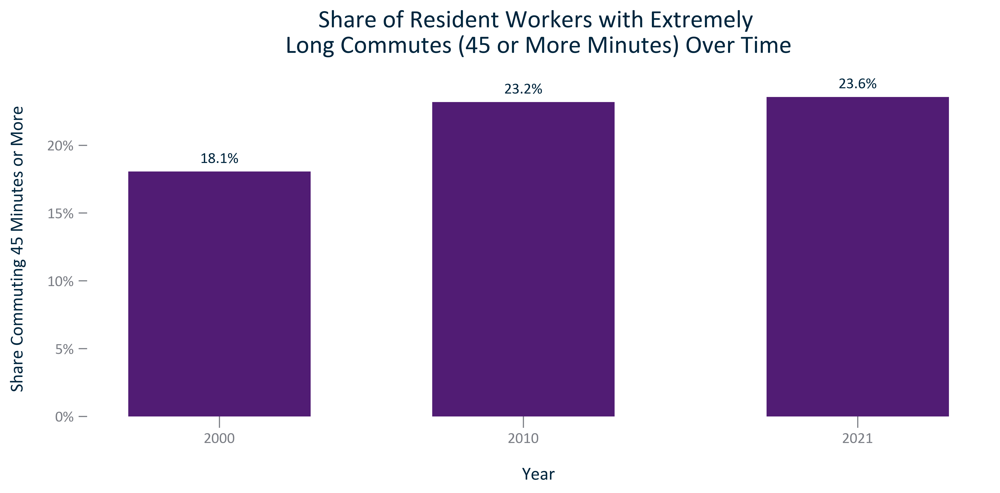

In [75]:
title = 'Share of Resident Workers with Extremely \nLong Commutes (45 or More Minutes) Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Commute%:Extremely Long Commute 45 Minutes or Over']]
xinput = 'Year'
yinput = 'Commute%:Extremely Long Commute 45 Minutes or Over'
xlabel = xinput
ylabel = 'Share Commuting 45 Minutes or More'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#plt.locator_params(axis='x', nbins=3)
#data labels
singledatalabels(0, 6, "{:,.1f}%")
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_extremelylongcommutetime_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_extremelylongcommutetime_overtime.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_bar_primarygeo_extremelylongcommutetime_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

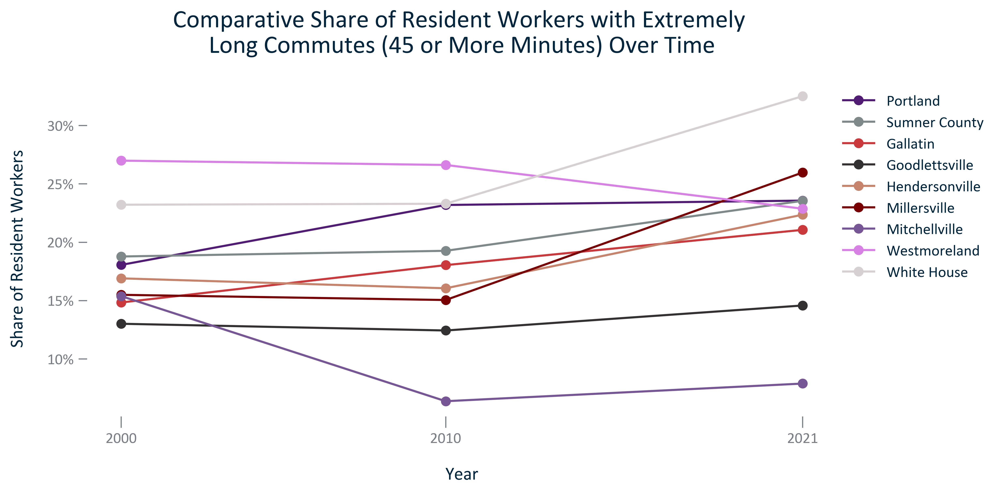

In [76]:
title = 'Comparative Share of Resident Workers with Extremely \nLong Commutes (45 or More Minutes) Over Time'
#set up temporary dataframe
xinput = 'Year'
yinput = 'Commute%:Extremely Long Commute 45 Minutes or Over'
df_temp0 = Hendersonville
linelabel0 = str(df_temp0['NAME'].values[0])
x0 = df_temp0[xinput]
y0 = df_temp0[yinput]
df_temp1 = Gallatin
linelabel1 = str(df_temp1['NAME'].values[0])
x1 = df_temp1[xinput]
y1 = df_temp1[yinput]
df_temp2 = Goodlettsville
linelabel2 = str(df_temp2['NAME'].values[0])
x2 = df_temp2[xinput]
y2 = df_temp2[yinput]
df_temp3 = Primary
linelabel3 = str(df_temp3['NAME'].values[0])
x3 = df_temp3[xinput]
y3 = df_temp3[yinput]
df_temp4 = WhiteHouse
linelabel4 = str(df_temp4['NAME'].values[0])
x4 = df_temp4[xinput]
y4 = df_temp4[yinput]
df_temp5 = Millersville
linelabel5 = str(df_temp5['NAME'].values[0])
x5 = df_temp5[xinput]
y5 = df_temp5[yinput]
df_temp6 = Westmoreland
linelabel6 = str(df_temp6['NAME'].values[0])
x6 = df_temp6[xinput]
y6 = df_temp6[yinput]
df_temp7 = Mitchellville
linelabel7 = str(df_temp7['NAME'].values[0])
x7 = df_temp7[xinput]
y7 = df_temp7[yinput]
df_temp8 = County
linelabel8 = str(df_temp8['NAME'].values[0])
x8 = df_temp8[xinput]
y8 = df_temp8[yinput]
#initiate figure and add lines and parameters
fig, ax = plt.subplots()
ax.plot(x3, y3,  label = linelabel3)
ax.plot(x8, y8,  label = linelabel8)
ax.plot(x1, y1,  label = linelabel1)
ax.plot(x2, y2,  label = linelabel2)
ax.plot(x0, y0,  label = linelabel0)
ax.plot(x5, y5,  label = linelabel5)
ax.plot(x7, y7,  label = linelabel7)
ax.plot(x6, y6,  label = linelabel6)
ax.plot(x4, y4,  label = linelabel4)
ax.set(title = title, xlabel = xinput, ylabel = 'Share of Resident Workers')
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks([2000, 2010, 2021], labels)
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left')
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_line_geocomparative_extremelylongcommutetime_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_line_geocomparative_extremelylongcommutetime_overtime.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_line_geocomparative_extremelylongcommutetime_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

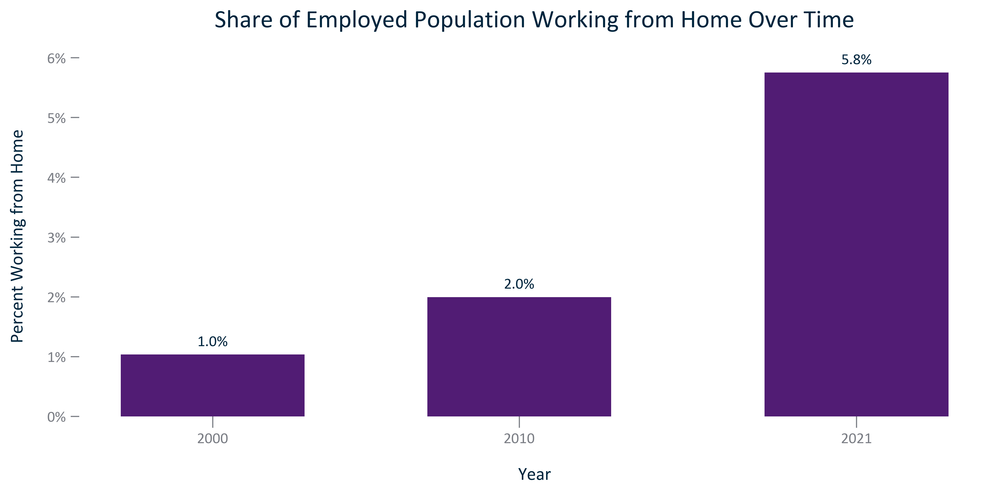

In [77]:
title = 'Share of Employed Population Working from Home Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Transpo%:Worked From Home']]
xinput = 'Year'
yinput = 'Transpo%:Worked From Home'
xlabel = xinput
ylabel = 'Percent Working from Home'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#plt.locator_params(axis='x', nbins=3)
#data labels
singledatalabels(0, 6, "{:,.1f}%")
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_workfromhome_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_workfromhome_overtime.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_bar_primarygeo_workfromhome_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

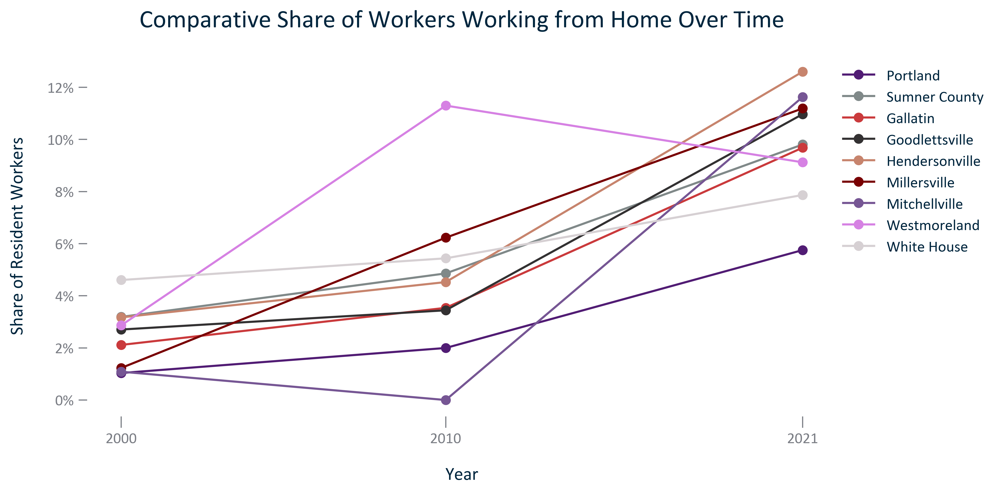

In [78]:
title = 'Comparative Share of Workers Working from Home Over Time'
#set up temporary dataframe
xinput = 'Year'
yinput = 'Transpo%:Worked From Home'
df_temp0 = Hendersonville
linelabel0 = str(df_temp0['NAME'].values[0])
x0 = df_temp0[xinput]
y0 = df_temp0[yinput]
df_temp1 = Gallatin
linelabel1 = str(df_temp1['NAME'].values[0])
x1 = df_temp1[xinput]
y1 = df_temp1[yinput]
df_temp2 = Goodlettsville
linelabel2 = str(df_temp2['NAME'].values[0])
x2 = df_temp2[xinput]
y2 = df_temp2[yinput]
df_temp3 = Primary
linelabel3 = str(df_temp3['NAME'].values[0])
x3 = df_temp3[xinput]
y3 = df_temp3[yinput]
df_temp4 = WhiteHouse
linelabel4 = str(df_temp4['NAME'].values[0])
x4 = df_temp4[xinput]
y4 = df_temp4[yinput]
df_temp5 = Millersville
linelabel5 = str(df_temp5['NAME'].values[0])
x5 = df_temp5[xinput]
y5 = df_temp5[yinput]
df_temp6 = Westmoreland
linelabel6 = str(df_temp6['NAME'].values[0])
x6 = df_temp6[xinput]
y6 = df_temp6[yinput]
df_temp7 = Mitchellville
linelabel7 = str(df_temp7['NAME'].values[0])
x7 = df_temp7[xinput]
y7 = df_temp7[yinput]
df_temp8 = County
linelabel8 = str(df_temp8['NAME'].values[0])
x8 = df_temp8[xinput]
y8 = df_temp8[yinput]
#initiate figure and add lines and parameters
fig, ax = plt.subplots()
ax.plot(x3, y3,  label = linelabel3)
ax.plot(x8, y8,  label = linelabel8)
ax.plot(x1, y1,  label = linelabel1)
ax.plot(x2, y2,  label = linelabel2)
ax.plot(x0, y0,  label = linelabel0)
ax.plot(x5, y5,  label = linelabel5)
ax.plot(x7, y7,  label = linelabel7)
ax.plot(x6, y6,  label = linelabel6)
ax.plot(x4, y4,  label = linelabel4)
ax.set(title = title, xlabel = xinput, ylabel = 'Share of Resident Workers')
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks([2000, 2010, 2021], labels)
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left')
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_line_geocomparative_shareworkfromhome_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_line_geocomparative_shareworkfromhome_overtime.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_line_geocomparative_shareworkfromhome_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

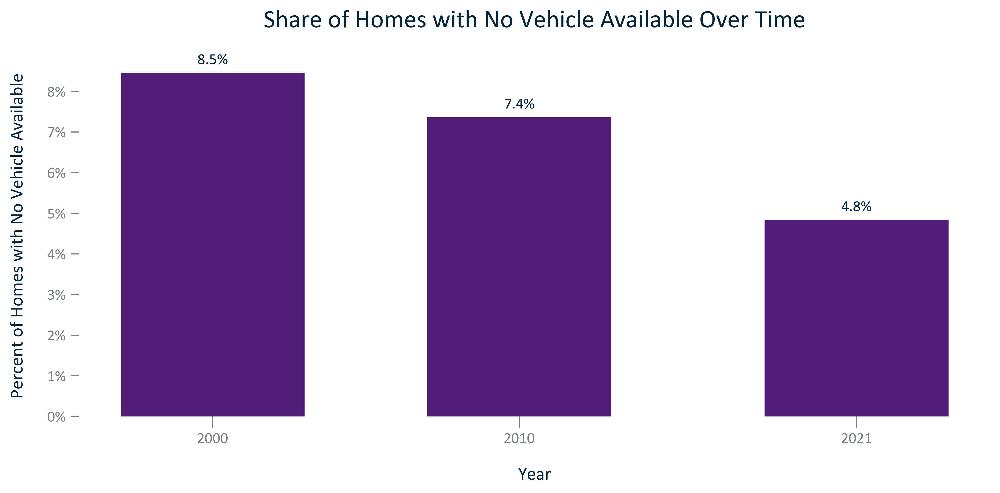

In [79]:
title = 'Share of Homes with No Vehicle Available Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Vehicles%:None']]
xinput = 'Year'
yinput = 'Vehicles%:None'
xlabel = xinput
ylabel = 'Percent of Homes with No Vehicle Available'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#plt.locator_params(axis='x', nbins=3)
#data labels
singledatalabels(0, 6, "{:,.1f}%")
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_novehicleavailable_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_bar_primarygeo_novehicleavailable_overtime.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_bar_primarygeo_novehicleavailable_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

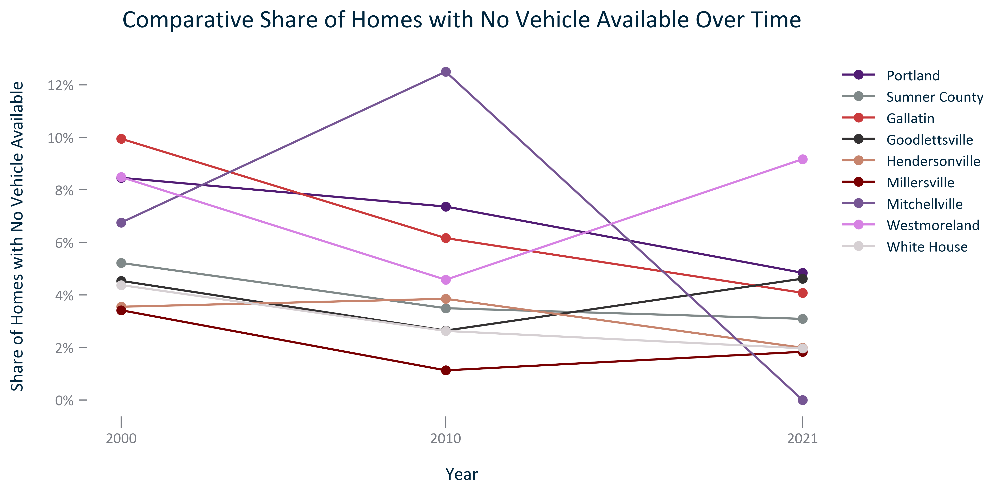

In [80]:
title = 'Comparative Share of Homes with No Vehicle Available Over Time'
#set up temporary dataframe
xinput = 'Year'
yinput = 'Vehicles%:None'
df_temp0 = Hendersonville
linelabel0 = str(df_temp0['NAME'].values[0])
x0 = df_temp0[xinput]
y0 = df_temp0[yinput]
df_temp1 = Gallatin
linelabel1 = str(df_temp1['NAME'].values[0])
x1 = df_temp1[xinput]
y1 = df_temp1[yinput]
df_temp2 = Goodlettsville
linelabel2 = str(df_temp2['NAME'].values[0])
x2 = df_temp2[xinput]
y2 = df_temp2[yinput]
df_temp3 = Primary
linelabel3 = str(df_temp3['NAME'].values[0])
x3 = df_temp3[xinput]
y3 = df_temp3[yinput]
df_temp4 = WhiteHouse
linelabel4 = str(df_temp4['NAME'].values[0])
x4 = df_temp4[xinput]
y4 = df_temp4[yinput]
df_temp5 = Millersville
linelabel5 = str(df_temp5['NAME'].values[0])
x5 = df_temp5[xinput]
y5 = df_temp5[yinput]
df_temp6 = Westmoreland
linelabel6 = str(df_temp6['NAME'].values[0])
x6 = df_temp6[xinput]
y6 = df_temp6[yinput]
df_temp7 = Mitchellville
linelabel7 = str(df_temp7['NAME'].values[0])
x7 = df_temp7[xinput]
y7 = df_temp7[yinput]
df_temp8 = County
linelabel8 = str(df_temp8['NAME'].values[0])
x8 = df_temp8[xinput]
y8 = df_temp8[yinput]
#initiate figure and add lines and parameters
fig, ax = plt.subplots()
ax.plot(x3, y3,  label = linelabel3)
ax.plot(x8, y8,  label = linelabel8)
ax.plot(x1, y1,  label = linelabel1)
ax.plot(x2, y2,  label = linelabel2)
ax.plot(x0, y0,  label = linelabel0)
ax.plot(x5, y5,  label = linelabel5)
ax.plot(x7, y7,  label = linelabel7)
ax.plot(x6, y6,  label = linelabel6)
ax.plot(x4, y4,  label = linelabel4)
ax.set(title = title, xlabel = xinput, ylabel = 'Share of Homes with No Vehicle Available')
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks([2000, 2010, 2021], labels)
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left')
#display and save
fig.savefig('../Figures/TRANSPO/TRANSPO_line_geocomparative_novehicleavailable_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/TRANSPO/TRANSPO_line_geocomparative_novehicleavailable_overtime.png', bbox_inches='tight')
with open('../Figures/TRANSPO/TRANSPO_line_geocomparative_novehicleavailable_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

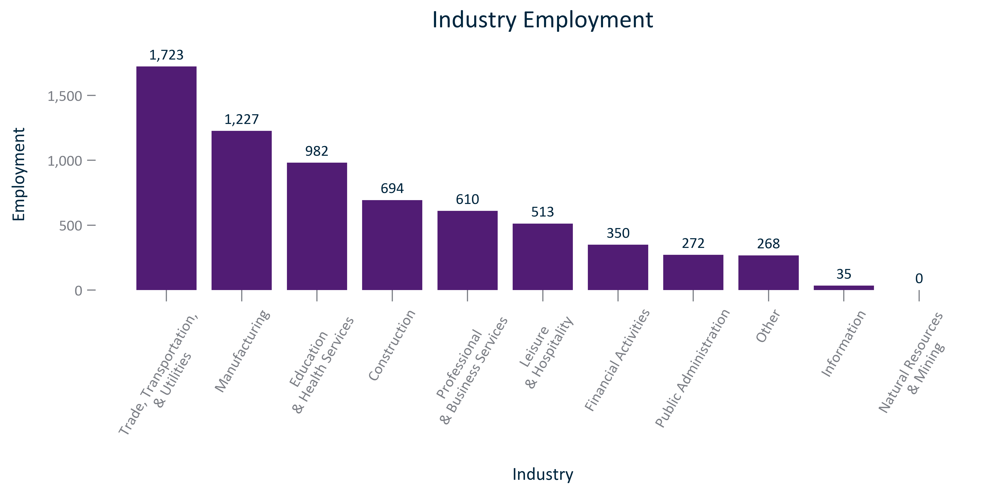

In [81]:
title = 'Industry Employment'
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Ind:Natural Resources and Mining', 
                   'Ind:Construction', 
                   'Ind:Manufacturing', 
                   'Ind:Trade, Transportation, and Utilities', 
                   'Ind:Information', 
                   'Ind:Financial Activities', 
                   'Ind:Professional and Business Services',
                   'Ind:Education and Health Services', 
                   'Ind:Leisure and Hospitality', 
                   'Ind:Public Administration',
                   'Ind:Other Services (Except Public Administration)']]
df_temp = df_temp.rename(columns = {'Ind:Natural Resources and Mining': 'Natural Resources \n& Mining',  
                                    'Ind:Construction': 'Construction', 
                                    'Ind:Manufacturing': 'Manufacturing',
                                    'Ind:Trade, Transportation, and Utilities': 'Trade, Transportation, \n& Utilities', 
                                    'Ind:Information': 'Information', 
                                    'Ind:Financial Activities': 'Financial Activities',
                                    'Ind:Professional and Business Services': 'Professional \n& Business Services',
                                    'Ind:Education and Health Services': 'Education \n& Health Services', 
                                    'Ind:Leisure and Hospitality': 'Leisure \n& Hospitality', 
                                    'Ind:Public Administration': 'Public Administration',
                                    'Ind:Other Services (Except Public Administration)': 'Other'})
df_temp = df_temp.melt(var_name = 'Industry', value_name = 'Employment')
df_temp = df_temp.sort_values(by = 'Employment', ascending = False)
#initiate figure and set parameters
x = df_temp['Industry']
y = df_temp['Employment']
xlabel = 'Industry'
ylabel = 'Employment'
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 60)#, labelsize = SMALLER_SIZE)#prop = {'size': 9})
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_numindustryemployment_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_numindustryemployment_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_numindustryemployment_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

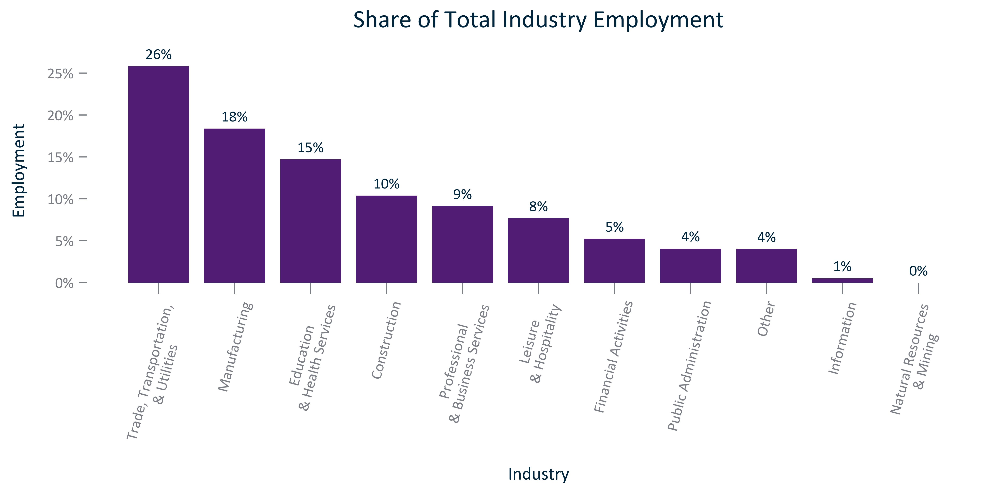

In [82]:
title = 'Share of Total Industry Employment'
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Ind%:Natural Resources and Mining', 
                   'Ind%:Construction', 
                   'Ind%:Manufacturing', 
                   'Ind%:Trade, Transportation, and Utilities', 
                   'Ind%:Information', 
                   'Ind%:Financial Activities', 
                   'Ind%:Professional and Business Services',
                   'Ind%:Education and Health Services', 
                   'Ind%:Leisure and Hospitality', 
                   'Ind%:Public Administration',
                   'Ind%:Other Services (Except Public Administration)']]
df_temp = df_temp.rename(columns = {'Ind%:Natural Resources and Mining': 'Natural Resources \n& Mining',  
                                    'Ind%:Construction': 'Construction', 
                                    'Ind%:Manufacturing': 'Manufacturing',
                                    'Ind%:Trade, Transportation, and Utilities': 'Trade, Transportation, \n& Utilities', 
                                    'Ind%:Information': 'Information', 
                                    'Ind%:Financial Activities': 'Financial Activities',
                                    'Ind%:Professional and Business Services': 'Professional \n& Business Services',
                                    'Ind%:Education and Health Services': 'Education \n& Health Services', 
                                    'Ind%:Leisure and Hospitality': 'Leisure \n& Hospitality', 
                                    'Ind%:Public Administration': 'Public Administration',
                                    'Ind%:Other Services (Except Public Administration)': 'Other'})
df_temp = df_temp.melt(var_name = 'Industry', value_name = 'Employment')
df_temp = df_temp.sort_values(by = 'Employment', ascending = False)
#initiate figure and set parameters
x = df_temp['Industry']
y = df_temp['Employment']
xlabel = 'Industry'
ylabel = 'Employment'
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 75)#, labelsize = SMALLER_SIZE)#prop = {'size': 9})
#data labels
singledatalabels(0, 5, "{:,.0f}%")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_shareindustryemployment_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_shareindustryemployment_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_shareindustryemployment_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

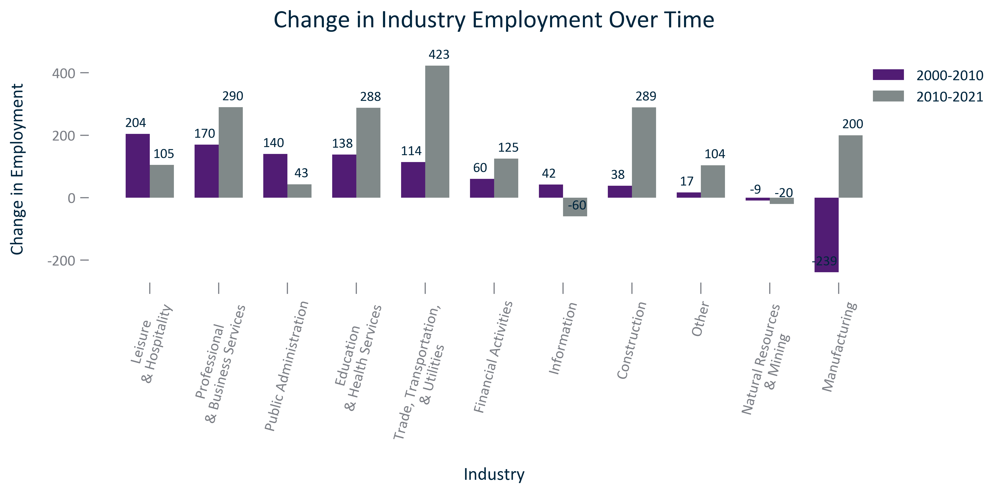

In [83]:
title = 'Change in Industry Employment Over Time'
df_temp = Primary.loc[Primary['Time Frame'] != 'None']
df_temp = df_temp.loc[df_temp['Time Frame'] != '2000-2021']
df_temp = df_temp[['Time Frame', 'Ind:Natural Resources and Mining Change', 
                   'Ind:Construction Change', 
                   'Ind:Manufacturing Change', 
                   'Ind:Trade, Transportation, and Utilities Change', 
                   'Ind:Information Change', 
                   'Ind:Financial Activities Change', 
                   'Ind:Professional and Business Services Change',
                   'Ind:Education and Health Services Change', 
                   'Ind:Leisure and Hospitality Change', 
                   'Ind:Public Administration Change',
                   'Ind:Other Services (Except Public Administration) Change']]
df_temp = df_temp.rename(columns = {'Ind:Natural Resources and Mining Change': 'Natural Resources \n& Mining',  
                                    'Ind:Construction Change': 'Construction', 
                                    'Ind:Manufacturing Change': 'Manufacturing',
                                    'Ind:Trade, Transportation, and Utilities Change': 'Trade, Transportation, \n& Utilities', 
                                    'Ind:Information Change': 'Information', 
                                    'Ind:Financial Activities Change': 'Financial Activities',
                                    'Ind:Professional and Business Services Change': 'Professional \n& Business Services',
                                    'Ind:Education and Health Services Change': 'Education \n& Health Services', 
                                    'Ind:Leisure and Hospitality Change': 'Leisure \n& Hospitality', 
                                    'Ind:Public Administration Change': 'Public Administration',
                                    'Ind:Other Services (Except Public Administration) Change': 'Other'})
df_temp = df_temp.set_index('Time Frame')
df_temp = df_temp.transpose()
df_temp = df_temp.sort_values(by = '2000-2010', ascending = False)
#initiate figure and set parameters
xlabel = 'Industry'
ylabel = 'Change in Employment'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2021']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 75)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-10, 5, 10, 5, "{:,.0f}", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_realchangeindustryemployment_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_realchangeindustryemployment_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_clusterbar_primarygeo_realchangeindustryemployment_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

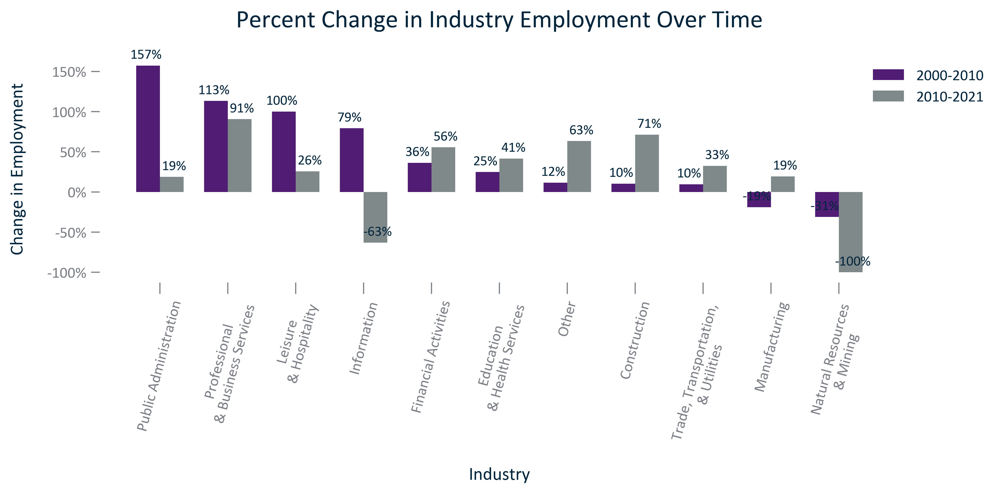

In [84]:
title = 'Percent Change in Industry Employment Over Time'
df_temp = Primary.loc[Primary['Time Frame'] != 'None']
df_temp = df_temp.loc[df_temp['Time Frame'] != '2000-2021']
df_temp = df_temp[['Time Frame', 'Ind:Natural Resources and Mining % Change', 
                   'Ind:Construction % Change', 
                   'Ind:Manufacturing % Change', 
                   'Ind:Trade, Transportation, and Utilities % Change', 
                   'Ind:Information % Change', 
                   'Ind:Financial Activities % Change', 
                   'Ind:Professional and Business Services % Change',
                   'Ind:Education and Health Services % Change', 
                   'Ind:Leisure and Hospitality % Change', 
                   'Ind:Public Administration % Change',
                   'Ind:Other Services (Except Public Administration) % Change']]
df_temp = df_temp.rename(columns = {'Ind:Natural Resources and Mining % Change': 'Natural Resources \n& Mining',  
                                    'Ind:Construction % Change': 'Construction', 
                                    'Ind:Manufacturing % Change': 'Manufacturing',
                                    'Ind:Trade, Transportation, and Utilities % Change': 'Trade, Transportation, \n& Utilities', 
                                    'Ind:Information % Change': 'Information', 
                                    'Ind:Financial Activities % Change': 'Financial Activities',
                                    'Ind:Professional and Business Services % Change': 'Professional \n& Business Services',
                                    'Ind:Education and Health Services % Change': 'Education \n& Health Services', 
                                    'Ind:Leisure and Hospitality % Change': 'Leisure \n& Hospitality', 
                                    'Ind:Public Administration % Change': 'Public Administration',
                                    'Ind:Other Services (Except Public Administration) % Change': 'Other'})
df_temp = df_temp.set_index('Time Frame')
df_temp = df_temp.transpose()
df_temp = df_temp.sort_values(by = '2000-2010', ascending = False)
#initiate figure and set parameters
xlabel = 'Industry'
ylabel = 'Change in Employment'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2021']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 75)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-10, 5, 10, 5, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangeindustryemployment_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangeindustryemployment_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangeindustryemployment_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

C:\Users\jmccall\AppData\Local\Temp\ipykernel_6348\3489385904.py:50: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp1.append(dfs)


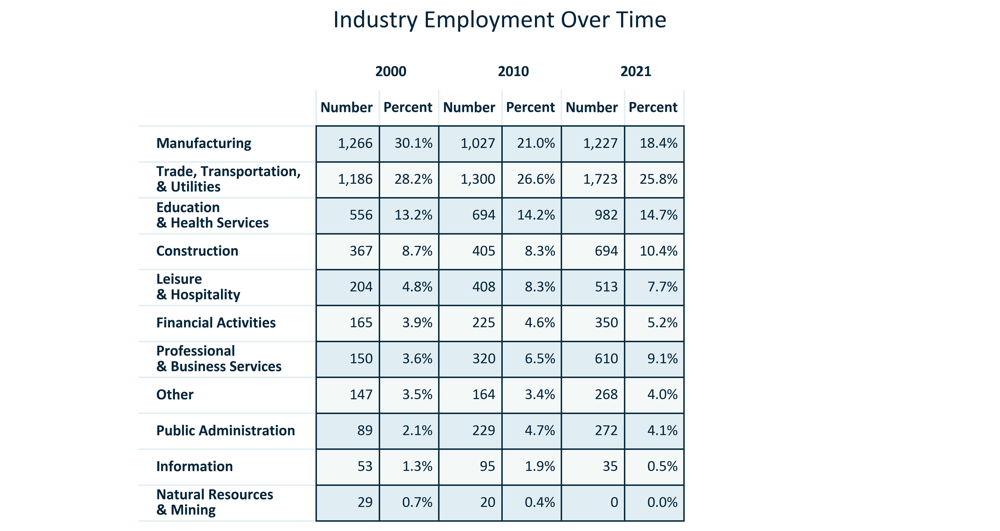

In [85]:
title = 'Industry Employment Over Time'
#set up temporary dataframe
df_temp = Primaryt
next_line = ['Number2000', 'Percent2000', 'Number2010', 'Percent2010', 'Number2021', 'Percent2021']
df_temp1 = df_temp[['Ind:Natural Resources and Mining 2000', 'Ind%:Natural Resources and Mining 2000',
                    'Ind:Natural Resources and Mining 2010', 'Ind%:Natural Resources and Mining 2010',
                    'Ind:Natural Resources and Mining 2021', 'Ind%:Natural Resources and Mining 2021']]
df_temp1.columns = next_line
df_temp2 = df_temp[['Ind:Construction 2000', 'Ind%:Construction 2000',
                    'Ind:Construction 2010', 'Ind%:Construction 2010',
                    'Ind:Construction 2021', 'Ind%:Construction 2021']]
df_temp2.columns = next_line
df_temp3 = df_temp[['Ind:Manufacturing 2000', 'Ind%:Manufacturing 2000',
                    'Ind:Manufacturing 2010', 'Ind%:Manufacturing 2010',
                    'Ind:Manufacturing 2021', 'Ind%:Manufacturing 2021']]
df_temp3.columns = next_line
df_temp4 = df_temp[['Ind:Trade, Transportation, and Utilities 2000', 'Ind%:Trade, Transportation, and Utilities 2000',
                    'Ind:Trade, Transportation, and Utilities 2010', 'Ind%:Trade, Transportation, and Utilities 2010',
                    'Ind:Trade, Transportation, and Utilities 2021', 'Ind%:Trade, Transportation, and Utilities 2021']]
df_temp4.columns = next_line
df_temp5 = df_temp[['Ind:Information 2000', 'Ind%:Information 2000',
                    'Ind:Information 2010', 'Ind%:Information 2010',
                    'Ind:Information 2021', 'Ind%:Information 2021']]
df_temp5.columns = next_line
df_temp6 = df_temp[['Ind:Financial Activities 2000', 'Ind%:Financial Activities 2000',
                    'Ind:Financial Activities 2010', 'Ind%:Financial Activities 2010',
                    'Ind:Financial Activities 2021', 'Ind%:Financial Activities 2021']]
df_temp6.columns = next_line
df_temp7 = df_temp[['Ind:Professional and Business Services 2000', 'Ind%:Professional and Business Services 2000',
                    'Ind:Professional and Business Services 2010', 'Ind%:Professional and Business Services 2010',
                    'Ind:Professional and Business Services 2021', 'Ind%:Professional and Business Services 2021']]
df_temp7.columns = next_line
df_temp8 = df_temp[['Ind:Education and Health Services 2000', 'Ind%:Education and Health Services 2000',
                    'Ind:Education and Health Services 2010', 'Ind%:Education and Health Services 2010',
                    'Ind:Education and Health Services 2021', 'Ind%:Education and Health Services 2021']]
df_temp8.columns = next_line
df_temp9 = df_temp[['Ind:Leisure and Hospitality 2000', 'Ind%:Leisure and Hospitality 2000',
                    'Ind:Leisure and Hospitality 2010', 'Ind%:Leisure and Hospitality 2010',
                    'Ind:Leisure and Hospitality 2021', 'Ind%:Leisure and Hospitality 2021']]
df_temp9.columns = next_line
df_temp10 = df_temp[['Ind:Public Administration 2000', 'Ind%:Public Administration 2000',
                    'Ind:Public Administration 2010', 'Ind%:Public Administration 2010',
                    'Ind:Public Administration 2021', 'Ind%:Public Administration 2021']]
df_temp10.columns = next_line
df_temp11 = df_temp[['Ind:Other Services (Except Public Administration) 2000', 'Ind%:Other Services (Except Public Administration) 2000',
                    'Ind:Other Services (Except Public Administration) 2010', 'Ind%:Other Services (Except Public Administration) 2010',
                    'Ind:Other Services (Except Public Administration) 2021', 'Ind%:Other Services (Except Public Administration) 2021']]
df_temp11.columns = next_line
dfs = [df_temp2, df_temp3, df_temp4, df_temp5, df_temp6, df_temp7, df_temp8, df_temp9, df_temp10, df_temp11]
df_temp = df_temp1.append(dfs)
newindex = ['Natural Resources \n& Mining', 'Construction', 'Manufacturing', 'Trade, Transportation, \n& Utilities', 'Information', 
            'Financial Activities', 'Professional \n& Business Services', 'Education \n& Health Services', 'Leisure \n& Hospitality', 
            'Public Administration', 'Other']
df_temp = df_temp.set_axis(newindex)
df_temp = df_temp.sort_values(by = 'Number2000', ascending = False)
df_temp.update(df_temp[['Number2000', 'Number2010', 'Number2021']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Percent2000', 'Percent2010', 'Percent2021']].applymap('{:.1f}%'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#groups
col_names = ['Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['2000','', '2010', '', '2021', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.2)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/EMP/EMP_table_primarygeo_industryemployment_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_table_primarygeo_industryemployment_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_table_primarygeo_industryemployment_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

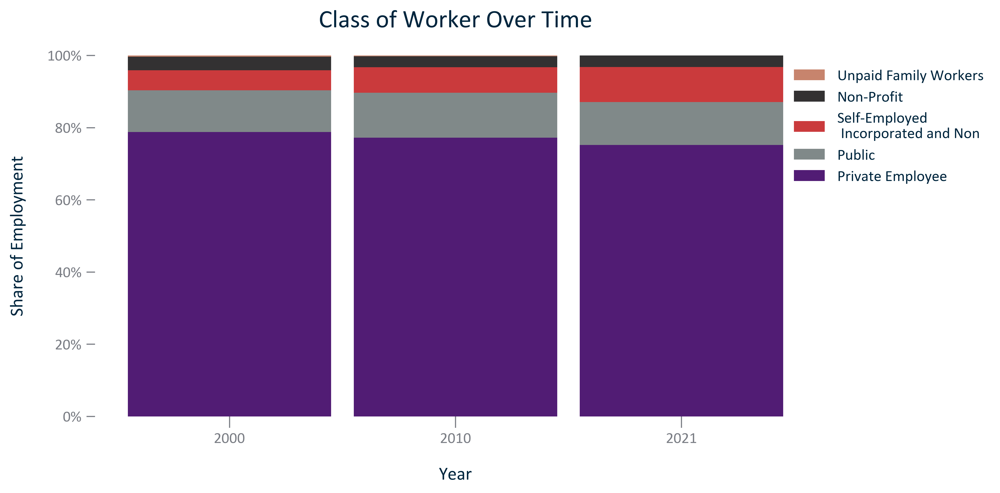

In [86]:
#PRIMARY GEO, employment sector
title = 'Class of Worker Over Time'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year', 'Sector%:Private, Employee', 'Sector%:Public', 'Sector%:Self-Employed', 'Sector%:Non-Profit', 'Sector%:Unpaid Family Workers']]
df_temp = df_temp.rename(columns = {'Sector%:Private, Employee': 'Private Employee',
                                    'Sector%:Public': 'Public',
                                    'Sector%:Self-Employed': 'Self-Employed\n Incorporated and Non', 
                                    'Sector%:Non-Profit': "Non-Profit",
                                    'Ed%:Bachelors': "Bachelor's Degree", 
                                    'Sector%:Unpaid Family Workers': "Unpaid Family Workers"})
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
boxstyleinput = "round,pad=-0.060,rounding_size=0.15"
def roundedboxes(boxstyle):
    new_patches = []
    for patch in reversed(ax.patches):
        bb = patch.get_bbox()
        color=patch.get_facecolor()
        p_bbox = FancyBboxPatch((bb.xmin, bb.ymin),abs(bb.width), abs(bb.height),boxstyle=boxstyleinput, ec="none", fc=color, mutation_aspect=1)
        patch.remove()
        new_patches.append(p_bbox)
    for patch in new_patches:
        ax.add_patch(patch) 
#plt.locator_params(axis='x', nbins = 4)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Employment') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
#display and save
fig.savefig('../Figures/EMP/EMP_stackedbar_primarygeo_classofworker_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_stackedbar_primarygeo_classofworker_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_stackedbar_primarygeo_classofworker_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

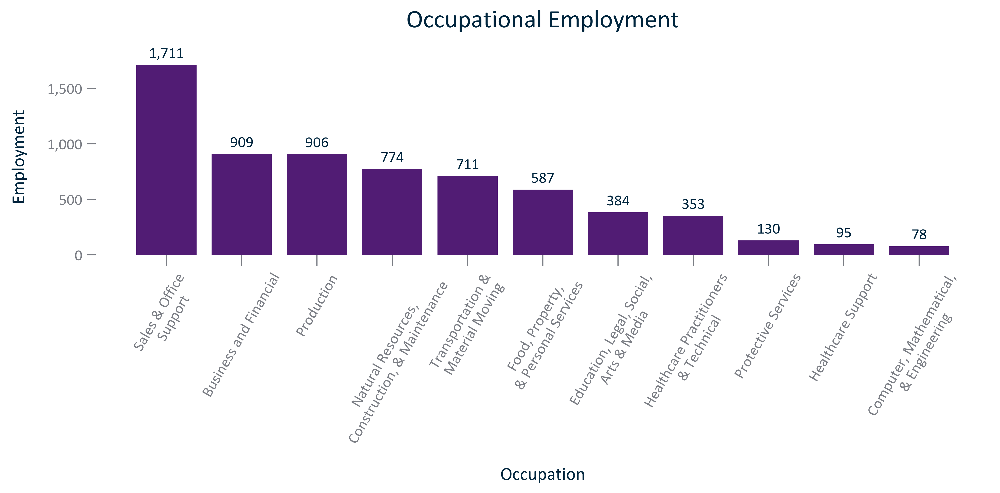

In [87]:
title = 'Occupational Employment'
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Occ:Business and Financial Operations', 
                   'Occ:Computer, Mathematical, and Engineering Occupations', 
                   'Occ:Education, Legal, Social, Arts, and Media Occupations', 
                   'Occ:Healthcare Practitioners and Technical Occupations', 
                   'Occ:Healthcare Support', 
                   'Occ:Protective Services', 
                   'Occ:Food, Property, and Personal Services',
                   'Occ:Sales and Office Support Occupations', 
                   'Occ:Natural Resources, Construction, and Maintenance Occupations', 
                   'Occ:Production',
                   'Occ:Transportation and Material Moving']]
df_temp = df_temp.rename(columns = {'Occ:Business and Financial Operations': 'Business and Financial', 
                                    'Occ:Computer, Mathematical, and Engineering Occupations': 'Computer, Mathematical,\n& Engineering', 
                                    'Occ:Education, Legal, Social, Arts, and Media Occupations': 'Education, Legal, Social,\nArts & Media', 
                                    'Occ:Healthcare Practitioners and Technical Occupations': 'Healthcare Practitioners\n& Technical', 
                                    'Occ:Healthcare Support': 'Healthcare Support', 
                                    'Occ:Protective Services': 'Protective Services', 
                                    'Occ:Food, Property, and Personal Services': 'Food, Property,\n& Personal Services',
                                    'Occ:Sales and Office Support Occupations': 'Sales & Office\n Support', 
                                    'Occ:Natural Resources, Construction, and Maintenance Occupations': 'Natural Resources,\nConstruction, & Maintenance', 
                                    'Occ:Production': 'Production',
                                    'Occ:Transportation and Material Moving': 'Transportation &\nMaterial Moving'})
df_temp = df_temp.melt(var_name = 'Occupation', value_name = 'Employment')
df_temp = df_temp.sort_values(by = 'Employment', ascending = False)
#initiate figure and set parameters
x = df_temp['Occupation']
y = df_temp['Employment']
xlabel = 'Occupation'
ylabel = 'Employment'
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 60)#, labelsize = SMALLER_SIZE)#prop = {'size': 9})
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_numoccupationalemployment_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_numoccupationalemployment_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_numoccupationalemployment_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

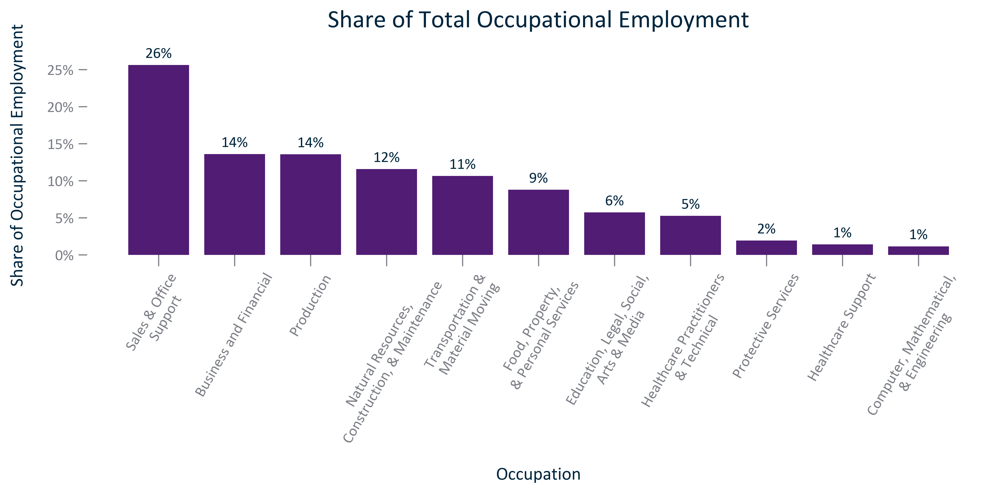

In [88]:
title = 'Share of Total Occupational Employment'
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Occ%:Business and Financial Operations', 
                   'Occ%:Computer, Mathematical, and Engineering Occupations', 
                   'Occ%:Education, Legal, Social, Arts, and Media Occupations', 
                   'Occ%:Healthcare Practitioners and Technical Occupations', 
                   'Occ%:Healthcare Support', 
                   'Occ%:Protective Services', 
                   'Occ%:Food, Property, and Personal Services',
                   'Occ%:Sales and Office Support Occupations', 
                   'Occ%:Natural Resources, Construction, and Maintenance Occupations', 
                   'Occ%:Production',
                   'Occ%:Transportation and Material Moving']]
df_temp = df_temp.rename(columns = {'Occ%:Business and Financial Operations': 'Business and Financial', 
                                    'Occ%:Computer, Mathematical, and Engineering Occupations': 'Computer, Mathematical,\n& Engineering', 
                                    'Occ%:Education, Legal, Social, Arts, and Media Occupations': 'Education, Legal, Social,\nArts & Media', 
                                    'Occ%:Healthcare Practitioners and Technical Occupations': 'Healthcare Practitioners\n& Technical', 
                                    'Occ%:Healthcare Support': 'Healthcare Support', 
                                    'Occ%:Protective Services': 'Protective Services', 
                                    'Occ%:Food, Property, and Personal Services': 'Food, Property,\n& Personal Services',
                                    'Occ%:Sales and Office Support Occupations': 'Sales & Office\n Support', 
                                    'Occ%:Natural Resources, Construction, and Maintenance Occupations': 'Natural Resources,\nConstruction, & Maintenance', 
                                    'Occ%:Production': 'Production',
                                    'Occ%:Transportation and Material Moving': 'Transportation &\nMaterial Moving'})
df_temp = df_temp.melt(var_name = 'Occupation', value_name = 'Employment')
df_temp = df_temp.sort_values(by = 'Employment', ascending = False)
#initiate figure and set parameters
x = df_temp['Occupation']
y = df_temp['Employment']
xlabel = 'Occupation'
ylabel = 'Share of Occupational Employment'
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 60)#, labelsize = SMALLER_SIZE)#prop = {'size': 9})
#data labels
singledatalabels(0, 5, "{:,.0f}%")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_shareoccupationalemployment_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_shareoccupationalemployment_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_shareoccupationalemployment_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

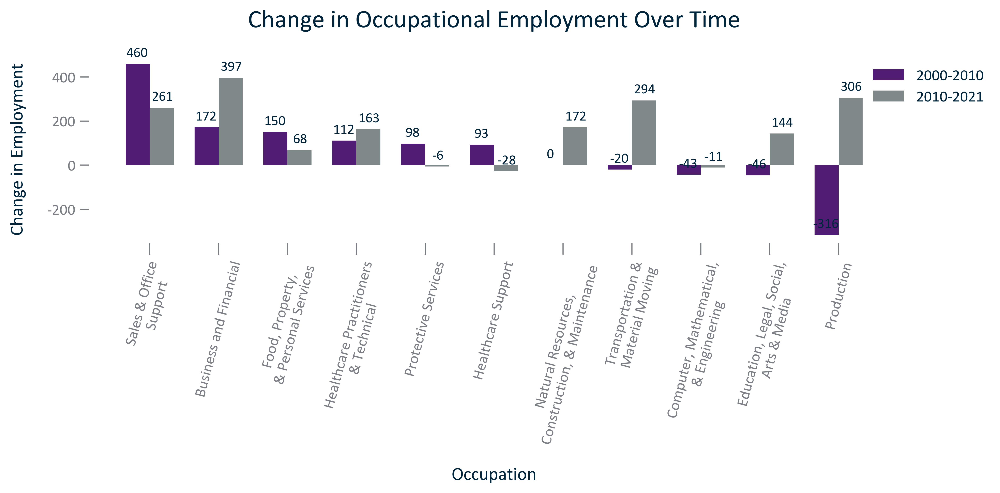

In [89]:
title = 'Change in Occupational Employment Over Time'
df_temp = Primary.loc[Primary['Time Frame'] != 'None']
df_temp = df_temp.loc[df_temp['Time Frame'] != '2000-2021']

df_temp = df_temp[['Time Frame', 'Occ:Business and Financial Operations Change', 
                   'Occ:Computer, Mathematical, and Engineering Occupations Change', 
                   'Occ:Education, Legal, Social, Arts, and Media Occupations Change', 
                   'Occ:Healthcare Practitioners and Technical Occupations Change', 
                   'Occ:Healthcare Support Change', 
                   'Occ:Protective Services Change', 
                   'Occ:Food, Property, and Personal Services Change',
                   'Occ:Sales and Office Support Occupations Change', 
                   'Occ:Natural Resources, Construction, and Maintenance Occupations Change', 
                   'Occ:Production Change',
                   'Occ:Transportation and Material Moving Change']]
df_temp = df_temp.rename(columns = {'Occ:Business and Financial Operations Change': 'Business and Financial', 
                                    'Occ:Computer, Mathematical, and Engineering Occupations Change': 'Computer, Mathematical,\n& Engineering', 
                                    'Occ:Education, Legal, Social, Arts, and Media Occupations Change': 'Education, Legal, Social,\nArts & Media', 
                                    'Occ:Healthcare Practitioners and Technical Occupations Change': 'Healthcare Practitioners\n& Technical', 
                                    'Occ:Healthcare Support Change': 'Healthcare Support', 
                                    'Occ:Protective Services Change': 'Protective Services', 
                                    'Occ:Food, Property, and Personal Services Change': 'Food, Property,\n& Personal Services',
                                    'Occ:Sales and Office Support Occupations Change': 'Sales & Office\n Support', 
                                    'Occ:Natural Resources, Construction, and Maintenance Occupations Change': 'Natural Resources,\nConstruction, & Maintenance', 
                                    'Occ:Production Change': 'Production',
                                    'Occ:Transportation and Material Moving Change': 'Transportation &\nMaterial Moving'})
df_temp = df_temp.set_index('Time Frame')
df_temp = df_temp.transpose()
df_temp = df_temp.sort_values(by = '2000-2010', ascending = False)
#initiate figure and set parameters
xlabel = 'Occupation'
ylabel = 'Change in Employment'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2021']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 75)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-9, 5, 9, 5, "{:,.0f}", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_realchangeoccupationalemployment_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_realchangeoccupationalemployment_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_clusterbar_primarygeo_realchangeoccupationalemployment_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

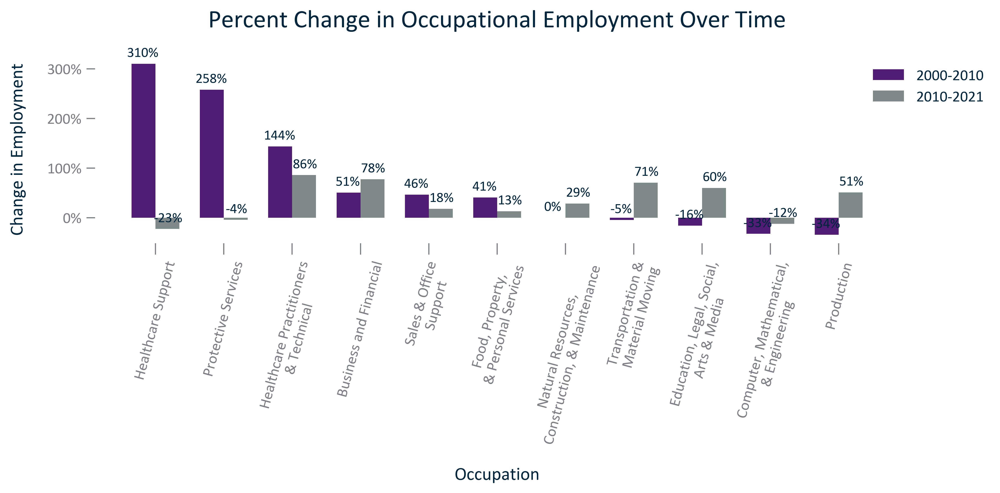

In [90]:
title = 'Percent Change in Occupational Employment Over Time'
df_temp = Primary.loc[Primary['Time Frame'] != 'None']
df_temp = df_temp.loc[df_temp['Time Frame'] != '2000-2021']

df_temp = df_temp[['Time Frame', 'Occ:Business and Financial Operations % Change', 
                   'Occ:Computer, Mathematical, and Engineering Occupations % Change', 
                   'Occ:Education, Legal, Social, Arts, and Media Occupations % Change', 
                   'Occ:Healthcare Practitioners and Technical Occupations % Change', 
                   'Occ:Healthcare Support % Change', 
                   'Occ:Protective Services % Change', 
                   'Occ:Food, Property, and Personal Services % Change',
                   'Occ:Sales and Office Support Occupations % Change', 
                   'Occ:Natural Resources, Construction, and Maintenance Occupations % Change', 
                   'Occ:Production % Change',
                   'Occ:Transportation and Material Moving % Change']]
df_temp = df_temp.rename(columns = {'Occ:Business and Financial Operations % Change': 'Business and Financial', 
                                    'Occ:Computer, Mathematical, and Engineering Occupations % Change': 'Computer, Mathematical,\n& Engineering', 
                                    'Occ:Education, Legal, Social, Arts, and Media Occupations % Change': 'Education, Legal, Social,\nArts & Media', 
                                    'Occ:Healthcare Practitioners and Technical Occupations % Change': 'Healthcare Practitioners\n& Technical', 
                                    'Occ:Healthcare Support % Change': 'Healthcare Support', 
                                    'Occ:Protective Services % Change': 'Protective Services', 
                                    'Occ:Food, Property, and Personal Services % Change': 'Food, Property,\n& Personal Services',
                                    'Occ:Sales and Office Support Occupations % Change': 'Sales & Office\n Support', 
                                    'Occ:Natural Resources, Construction, and Maintenance Occupations % Change': 'Natural Resources,\nConstruction, & Maintenance', 
                                    'Occ:Production % Change': 'Production',
                                    'Occ:Transportation and Material Moving % Change': 'Transportation &\nMaterial Moving'})
df_temp = df_temp.set_index('Time Frame')
df_temp = df_temp.transpose()
df_temp = df_temp.sort_values(by = '2000-2010', ascending = False)
#initiate figure and set parameters
xlabel = 'Occupation'
ylabel = 'Change in Employment'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2021']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 75)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-9, 5, 9, 5, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangeoccupationalemployment_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangeoccupationalemployment_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangeoccupationalemployment_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

C:\Users\jmccall\AppData\Local\Temp\ipykernel_6348\4089477339.py:50: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp1.append(dfs)


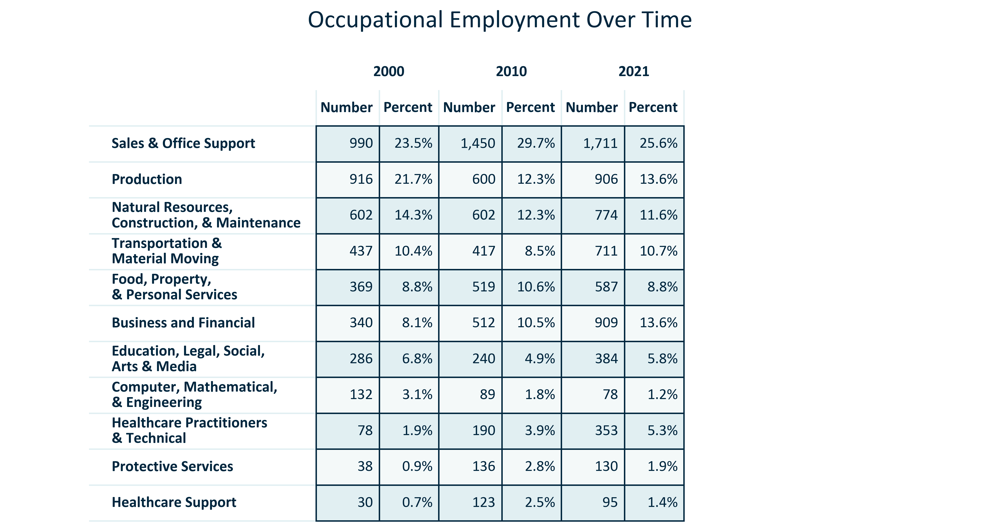

In [91]:
title = 'Occupational Employment Over Time'
#set up temporary dataframe
df_temp = Primaryt
next_line = ['Number2000', 'Percent2000', 'Number2010', 'Percent2010', 'Number2021', 'Percent2021']
df_temp1 = df_temp[['Occ:Business and Financial Operations 2000', 'Occ%:Business and Financial Operations 2000',
                    'Occ:Business and Financial Operations 2010', 'Occ%:Business and Financial Operations 2010',
                    'Occ:Business and Financial Operations 2021', 'Occ%:Business and Financial Operations 2021']]
df_temp1.columns = next_line
df_temp2 = df_temp[['Occ:Computer, Mathematical, and Engineering Occupations 2000', 'Occ%:Computer, Mathematical, and Engineering Occupations 2000',
                    'Occ:Computer, Mathematical, and Engineering Occupations 2010', 'Occ%:Computer, Mathematical, and Engineering Occupations 2010',
                    'Occ:Computer, Mathematical, and Engineering Occupations 2021', 'Occ%:Computer, Mathematical, and Engineering Occupations 2021']]
df_temp2.columns = next_line
df_temp3 = df_temp[['Occ:Education, Legal, Social, Arts, and Media Occupations 2000', 'Occ%:Education, Legal, Social, Arts, and Media Occupations 2000',
                    'Occ:Education, Legal, Social, Arts, and Media Occupations 2010', 'Occ%:Education, Legal, Social, Arts, and Media Occupations 2010',
                    'Occ:Education, Legal, Social, Arts, and Media Occupations 2021', 'Occ%:Education, Legal, Social, Arts, and Media Occupations 2021']]
df_temp3.columns = next_line
df_temp4 = df_temp[['Occ:Healthcare Practitioners and Technical Occupations 2000', 'Occ%:Healthcare Practitioners and Technical Occupations 2000',
                    'Occ:Healthcare Practitioners and Technical Occupations 2010', 'Occ%:Healthcare Practitioners and Technical Occupations 2010',
                    'Occ:Healthcare Practitioners and Technical Occupations 2021', 'Occ%:Healthcare Practitioners and Technical Occupations 2021']]
df_temp4.columns = next_line
df_temp5 = df_temp[['Occ:Healthcare Support 2000', 'Occ%:Healthcare Support 2000',
                    'Occ:Healthcare Support 2010', 'Occ%:Healthcare Support 2010',
                    'Occ:Healthcare Support 2021', 'Occ%:Healthcare Support 2021']]
df_temp5.columns = next_line
df_temp6 = df_temp[['Occ:Protective Services 2000', 'Occ%:Protective Services 2000',
                    'Occ:Protective Services 2010', 'Occ%:Protective Services 2010',
                    'Occ:Protective Services 2021', 'Occ%:Protective Services 2021']]
df_temp6.columns = next_line
df_temp7 = df_temp[['Occ:Food, Property, and Personal Services 2000', 'Occ%:Food, Property, and Personal Services 2000',
                    'Occ:Food, Property, and Personal Services 2010', 'Occ%:Food, Property, and Personal Services 2010',
                    'Occ:Food, Property, and Personal Services 2021', 'Occ%:Food, Property, and Personal Services 2021']]
df_temp7.columns = next_line
df_temp8 = df_temp[['Occ:Sales and Office Support Occupations 2000', 'Occ%:Sales and Office Support Occupations 2000',
                    'Occ:Sales and Office Support Occupations 2010', 'Occ%:Sales and Office Support Occupations 2010',
                    'Occ:Sales and Office Support Occupations 2021', 'Occ%:Sales and Office Support Occupations 2021']]
df_temp8.columns = next_line
df_temp9 = df_temp[['Occ:Natural Resources, Construction, and Maintenance Occupations 2000', 'Occ%:Natural Resources, Construction, and Maintenance Occupations 2000',
                    'Occ:Natural Resources, Construction, and Maintenance Occupations 2010', 'Occ%:Natural Resources, Construction, and Maintenance Occupations 2010',
                    'Occ:Natural Resources, Construction, and Maintenance Occupations 2021', 'Occ%:Natural Resources, Construction, and Maintenance Occupations 2021']]
df_temp9.columns = next_line
df_temp10 = df_temp[['Occ:Production 2000', 'Occ%:Production 2000',
                    'Occ:Production 2010', 'Occ%:Production 2010',
                    'Occ:Production 2021', 'Occ%:Production 2021']]
df_temp10.columns = next_line
df_temp11 = df_temp[['Occ:Transportation and Material Moving 2000', 'Occ%:Transportation and Material Moving 2000',
                    'Occ:Transportation and Material Moving 2010', 'Occ%:Transportation and Material Moving 2010',
                    'Occ:Transportation and Material Moving 2021', 'Occ%:Transportation and Material Moving 2021']]
df_temp11.columns = next_line
dfs = [df_temp2, df_temp3, df_temp4, df_temp5, df_temp6, df_temp7, df_temp8, df_temp9, df_temp10, df_temp11]
df_temp = df_temp1.append(dfs)
newindex = ['Business and Financial', 'Computer, Mathematical,\n& Engineering', 'Education, Legal, Social,\nArts & Media',
            'Healthcare Practitioners\n& Technical', 'Healthcare Support', 'Protective Services',  'Food, Property,\n& Personal Services',
            'Sales & Office Support', 'Natural Resources,\nConstruction, & Maintenance', 'Production', 'Transportation &\nMaterial Moving']
df_temp = df_temp.set_axis(newindex)
df_temp = df_temp.sort_values(by = 'Number2000', ascending = False)
df_temp.update(df_temp[['Number2000', 'Number2010', 'Number2021']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Percent2000', 'Percent2010', 'Percent2021']].applymap('{:.1f}%'.format))
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#groups
col_names = ['Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['2000','', '2010', '', '2021', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.2)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/EMP/EMP_table_primarygeo_occupationalemployment_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_table_primarygeo_occupationalemployment_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_table_primarygeo_occupationalemployment_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

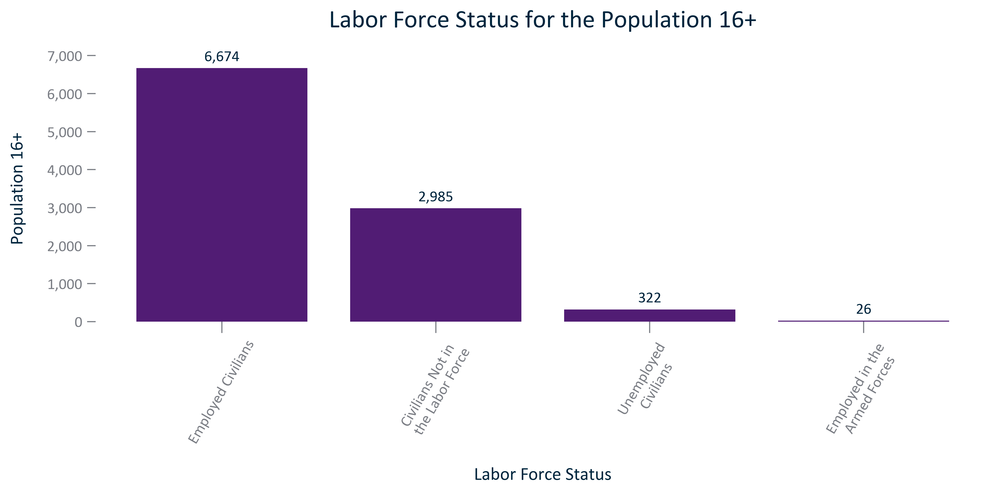

In [92]:
title = 'Labor Force Status for the Population 16+'
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Employment:Employed Civilian', 'Employment:Unemployed Civilian', 'Employment:Not in Labor Force', 'Employment:Armed Forces']]
df_temp = df_temp.rename(columns = {'Employment:Employed Civilian': 'Employed Civilians', 'Employment:Unemployed Civilian': 'Unemployed \nCivilians', 
                                    'Employment:Not in Labor Force': 'Civilians Not in \nthe Labor Force', 
                                    'Employment:Armed Forces': 'Employed in the \nArmed Forces'})
df_temp = df_temp.melt(var_name = 'Labor Force Status', value_name = 'Population 16+')
df_temp = df_temp.sort_values(by = 'Population 16+', ascending = False)
#initiate figure and set parameters
x = df_temp['Labor Force Status']
y = df_temp['Population 16+']
xlabel = 'Labor Force Status'
ylabel = 'Population 16+'
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 60)#, labelsize = SMALLER_SIZE)#prop = {'size': 9})
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_numlfstatus_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_numlfstatus_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_numlfstatus_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

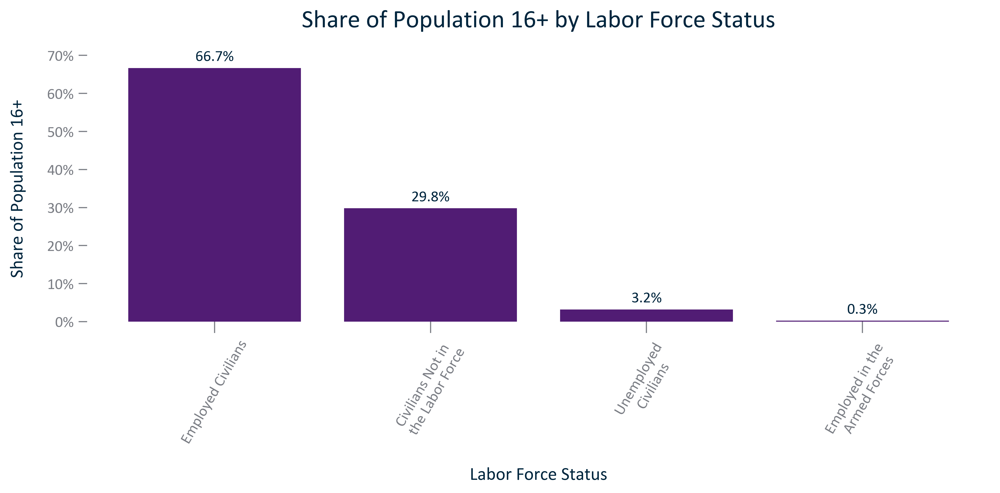

In [93]:
title = 'Share of Population 16+ by Labor Force Status'
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Employment%:Population 16 Over that are Employed Civilians', 'Employment%:Population 16 Over that are Unemployed Civilians', 
                   'Employment%:Total Population 16 Over Not in Labor Force', 'Employment%:Population 16 Over Employed in Armed Forces']]
df_temp = df_temp.rename(columns = {'Employment%:Population 16 Over that are Employed Civilians': 'Employed Civilians', 
                                    'Employment%:Population 16 Over that are Unemployed Civilians': 'Unemployed \nCivilians', 
                                    'Employment%:Total Population 16 Over Not in Labor Force': 'Civilians Not in \nthe Labor Force', 
                                    'Employment%:Population 16 Over Employed in Armed Forces': 'Employed in the \nArmed Forces'})
df_temp = df_temp.melt(var_name = 'Labor Force Status', value_name = 'Population 16+')
df_temp = df_temp.sort_values(by = 'Population 16+', ascending = False)
#initiate figure and set parameters
x = df_temp['Labor Force Status']
y = df_temp['Population 16+']
xlabel = 'Labor Force Status'
ylabel = 'Share of Population 16+'
fig, ax = plt.subplots()
ax.bar(x, y)
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 60)#, labelsize = SMALLER_SIZE)#prop = {'size': 9})
#data labels
singledatalabels(0, 5, "{:,.1f}%")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_percentlfstatus_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_percentlfstatus_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_percentlfstatus_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

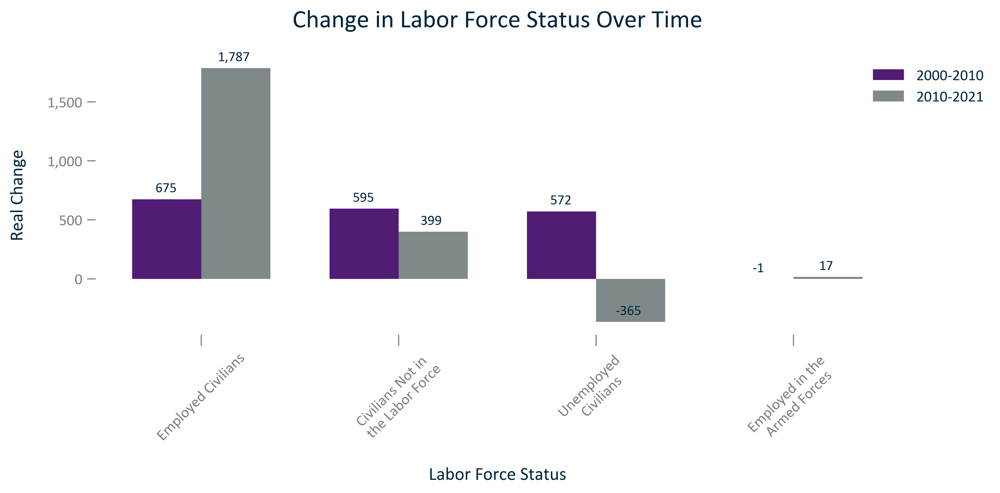

In [94]:
title = 'Change in Labor Force Status Over Time'
df_temp = Primary.loc[Primary['Time Frame'] != 'None']
df_temp = df_temp.loc[df_temp['Time Frame'] != '2000-2021']
df_temp = df_temp[['Time Frame', 'Employment:Employed Civilian Change', 'Employment:Unemployed Civilian Change', 
                   'Employment:Not in Labor Force Change', 'Employment:Armed Forces Change']]
df_temp = df_temp.rename(columns = {'Employment:Employed Civilian Change': 'Employed Civilians', 'Employment:Unemployed Civilian Change': 'Unemployed \nCivilians', 
                                    'Employment:Not in Labor Force Change': 'Civilians Not in \nthe Labor Force', 
                                    'Employment:Armed Forces Change': 'Employed in the \nArmed Forces'})
df_temp = df_temp.set_index('Time Frame')
df_temp = df_temp.transpose()
df_temp = df_temp.sort_values(by = '2000-2010', ascending = False)
#initiate figure and set parameters
xlabel = 'Labor Force Status'
ylabel = 'Real Change'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2021']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-25, 5, 23, 5, "{:,.0f}", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_realchangelfstatus_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_realchangelfstatus_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_clusterbar_primarygeo_realchangelfstatus_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

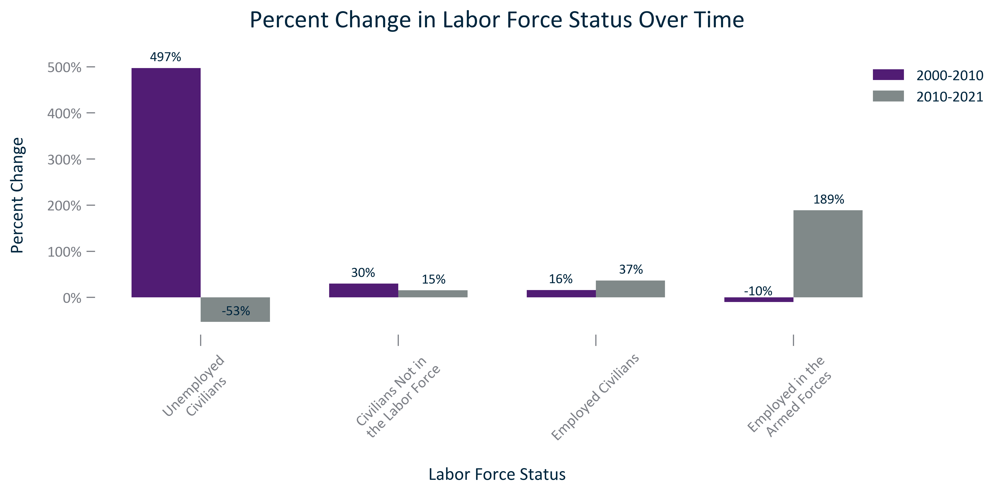

In [95]:
title = 'Percent Change in Labor Force Status Over Time'
df_temp = Primary.loc[Primary['Time Frame'] != 'None']
df_temp = df_temp.loc[df_temp['Time Frame'] != '2000-2021']
df_temp = df_temp[['Time Frame', 'Employment:Employed Civilian % Change', 'Employment:Unemployed Civilian % Change', 
                   'Employment:Not in Labor Force % Change', 'Employment:Armed Forces % Change']]
df_temp = df_temp.rename(columns = {'Employment:Employed Civilian % Change': 'Employed Civilians', 'Employment:Unemployed Civilian % Change': 'Unemployed \nCivilians', 
                                    'Employment:Not in Labor Force % Change': 'Civilians Not in \nthe Labor Force', 
                                    'Employment:Armed Forces % Change': 'Employed in the \nArmed Forces'})
df_temp = df_temp.set_index('Time Frame')
df_temp = df_temp.transpose()
df_temp = df_temp.sort_values(by = '2000-2010', ascending = False)
#initiate figure and set parameters
xlabel = 'Labor Force Status'
ylabel = 'Percent Change'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2021']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2021')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-25, 5, 25, 5, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangelfstatus_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangelfstatus_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_clusterbar_primarygeo_percentchangelfstatus_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

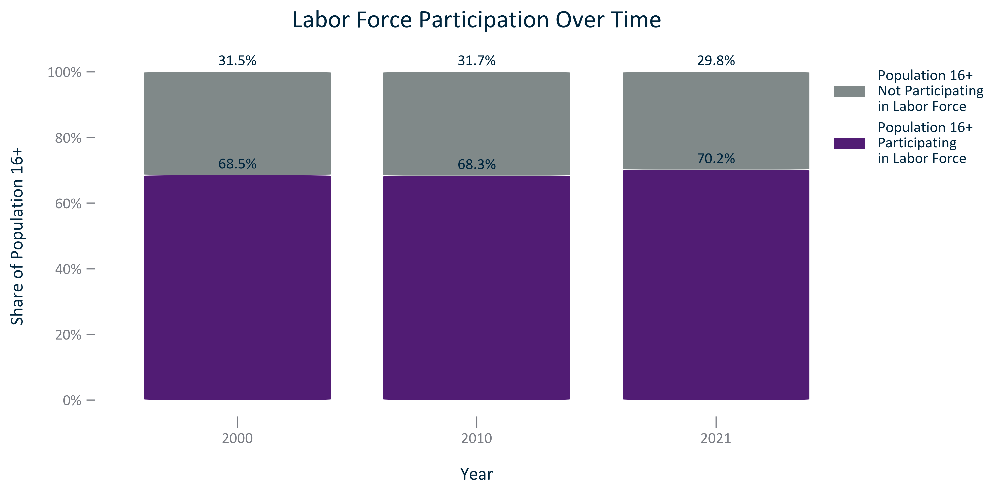

In [96]:
title = 'Labor Force Participation Over Time'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year', 'Employment%:Total Population 16 Over In Labor Force', 'Employment%:Total Population 16 Over Not in Labor Force']]
df_temp = df_temp.rename(columns = {'Employment%:Total Population 16 Over In Labor Force': 'Population 16+ \nParticipating\nin Labor Force', 
                                    'Employment%:Total Population 16 Over Not in Labor Force': 'Population 16+ \nNot Participating\nin Labor Force'})
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
#plt.locator_params(axis='x', nbins = 4)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Population 16+') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/EMP/EMP_stackedbar_primarygeo_lfparticipation_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_stackedbar_primarygeo_lfparticipation_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_stackedbar_primarygeo_lfparticipation_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

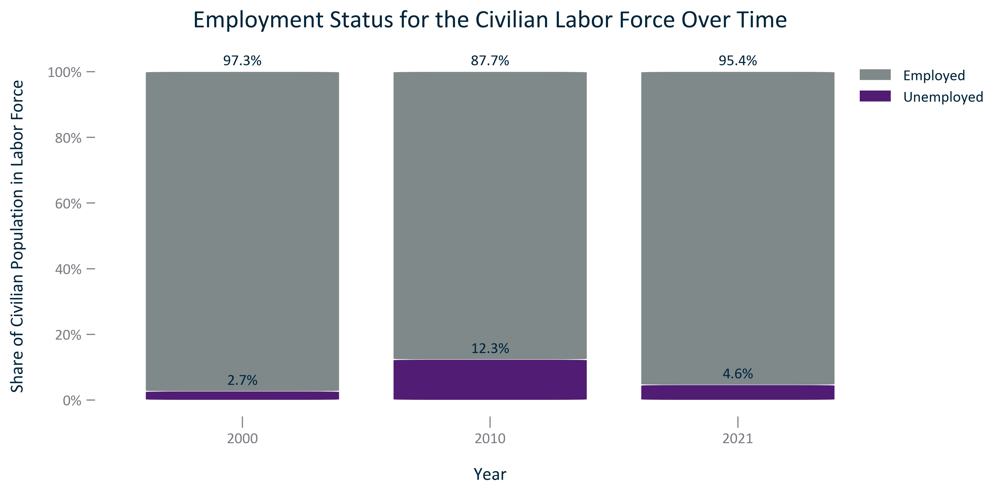

In [97]:
title = 'Employment Status for the Civilian Labor Force Over Time'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year', 'Employment%:Civilian Population in LF 16 Over that are Unemployed', 
                   'Employment%:Civilian Population in LF 16 Over that are Employed']]
df_temp = df_temp.rename(columns = {'Employment%:Civilian Population in LF 16 Over that are Unemployed': 'Unemployed', 
                                    'Employment%:Civilian Population in LF 16 Over that are Employed': 'Employed'})
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
#plt.locator_params(axis='x', nbins = 4)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Civilian Population in Labor Force') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/EMP/EMP_stackedbar_primarygeo_civilianemploymentstatus_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_stackedbar_primarygeo_civilianemploymentstatus_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_stackedbar_primarygeo_civilianemploymentstatus_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

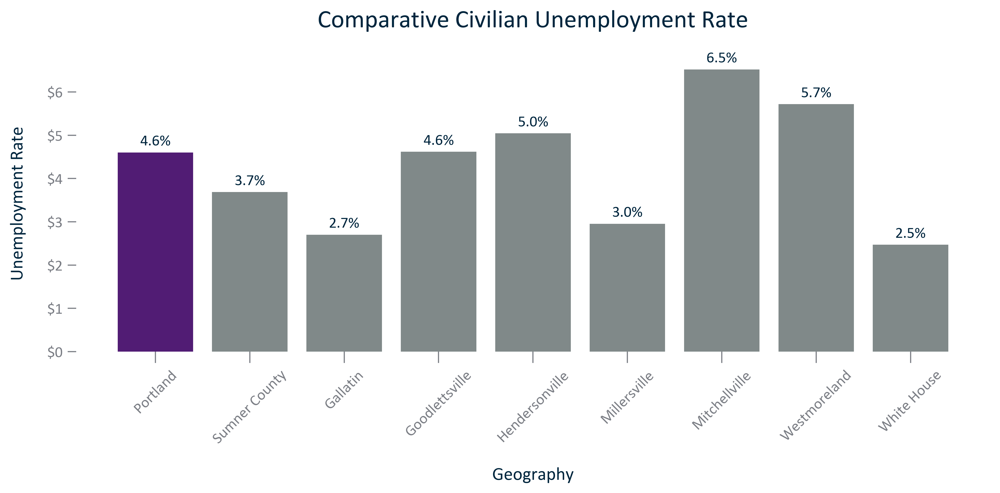

In [98]:
title = 'Comparative Civilian Unemployment Rate'
df_temp = reggeos.loc[reggeos['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['NAME', 'Employment%:Civilian Population in LF 16 Over that are Unemployed']]
x = df_temp['NAME']
y = df_temp['Employment%:Civilian Population in LF 16 Over that are Unemployed']
xlabel = 'Geography'
ylabel = 'Unemployment Rate'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.1f}%")
# #display and save
fig.savefig('../Figures/EMP/EMP_bar_geocomparative_civilianunemploymentrate_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_geocomparative_civilianunemploymentrate_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_geocomparative_civilianunemploymentrate_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

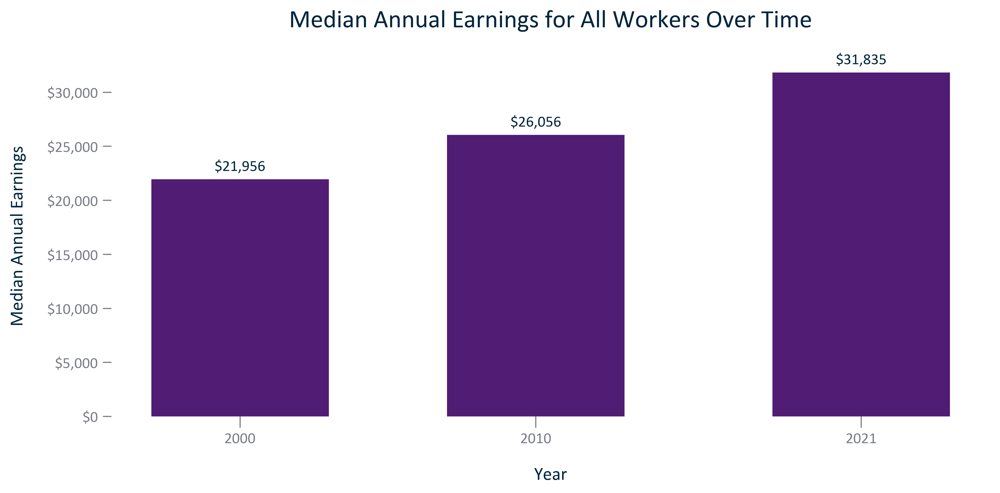

In [99]:
title = 'Median Annual Earnings for All Workers Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Earnings:Median, All Earners']]
df_temp = df_temp.rename(columns = {'Earnings:Median, All Earners': 'Median Annual Earnings'})
xinput = 'Year'
yinput = 'Median Annual Earnings'
xlabel = xinput
ylabel = yinput
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#plt.locator_params(axis='x', nbins=3)
#data labels
singledatalabels(0, 6, "${:,.0f}")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsallworkers_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsallworkers_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsallworkers_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

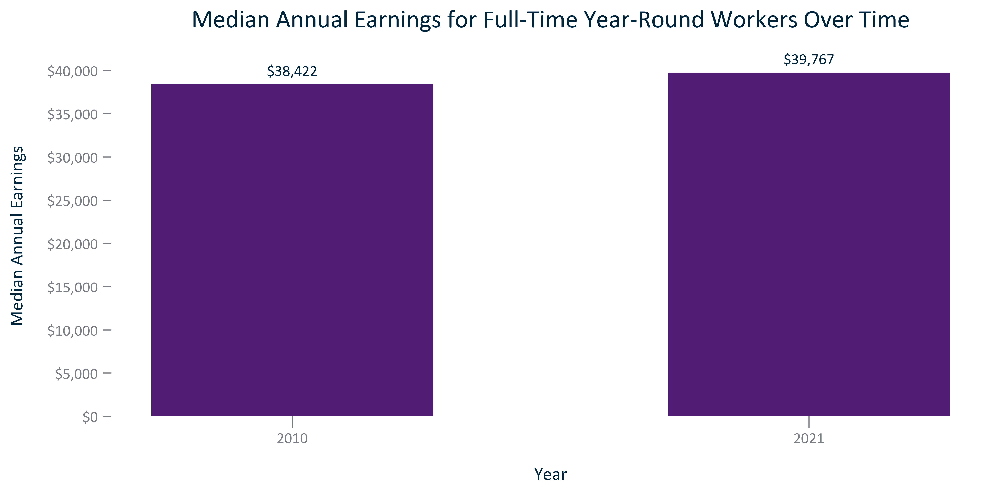

In [100]:
title = 'Median Annual Earnings for Full-Time Year-Round Workers Over Time'
df_temp = Primary.loc[(Primary['Time Frame'] == 'None')&(Primary['Year'] != 2000.0)]
df_temp = df_temp[['NAME', 'Year', 'Earnings:Median, Full Time', 'EarningsFT:Median']]
df_temp = df_temp.rename(columns = {'EarningsFT:Median': 'Median Annual Earnings'})
xinput = 'Year'
yinput = 'Median Annual Earnings'
xlabel = xinput
ylabel = yinput
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
labels = ['2010', '2021']
plt.xticks(x, labels)
#plt.locator_params(axis='x', nbins=3)
#data labels
singledatalabels(0, 6, "${:,.0f}")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsfulltimeworkers_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsfulltimeworkers_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsfulltimeworkers_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

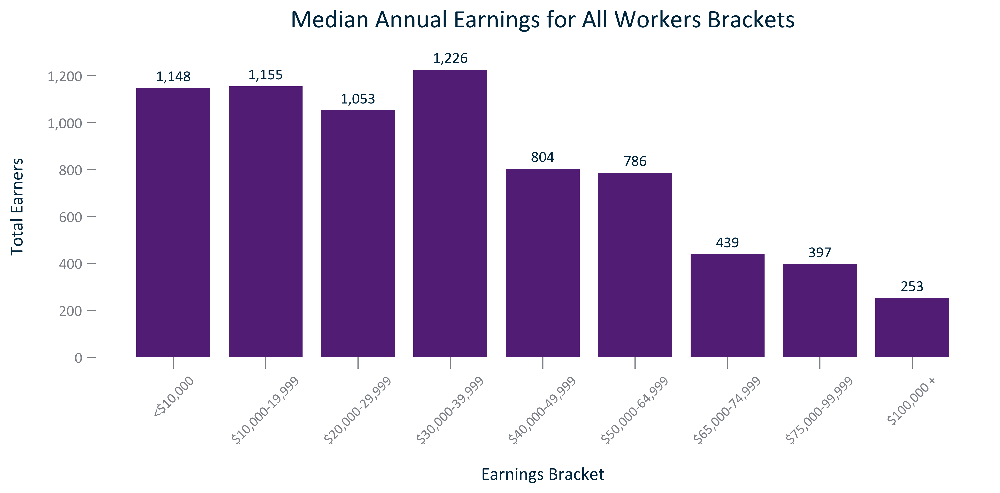

In [101]:
title = "Median Annual Earnings for All Workers Brackets"
#create temporary dataframe
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Earnings:Less than 10,000',
#                    'Earnings:Less than 5,000', 'Earnings:5,000 to 9,999', 
                   'Earnings:10,000 to 19,999', 'Earnings:20,000 to 29,999', 
                   'Earnings:30,000 to 39,999', 'Earnings:40,000 to 49,999', 'Earnings:50,000 to 64,999', 'Earnings:65,000 to 74,999', 
                   'Earnings:75,000 to 99,999', 'Earnings:100,000 and Over']]
df_temp = df_temp.rename(columns = {'Earnings:Less than 10,000': '<$10,000', 
#                                     'Earnings:Less than 5,000': '<$5,000',
#                                     'Earnings:5,000 to 9,999': '$5,000-9,999', 
                                    'Earnings:10,000 to 19,999': '$10,000-19,999', 
                                    'Earnings:20,000 to 29,999': '$20,000-29,999', 
                                    'Earnings:30,000 to 39,999': '$30,000-39,999', 
                                    'Earnings:40,000 to 49,999': '$40,000-49,999', 
                                    'Earnings:50,000 to 64,999': '$50,000-64,999', 
                                    'Earnings:65,000 to 74,999': '$65,000-74,999', 
                                    'Earnings:75,000 to 99,999': '$75,000-99,999', 
                                    'Earnings:100,000 and Over': '$100,000 +'})
df_temp = df_temp.transpose().reset_index(drop = False).rename(columns = {'index':'Earnings Bracket', 32:'Total Earners'})
#initiate figure and set parameters
xinput = 'Earnings Bracket'
yinput = 'Total Earners'
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = xinput
ylabel = yinput
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', labelsize = SMALLER_SIZE, rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianearningsallworkerscount_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianearningsallworkerscount_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_medianearningsallworkerscount_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

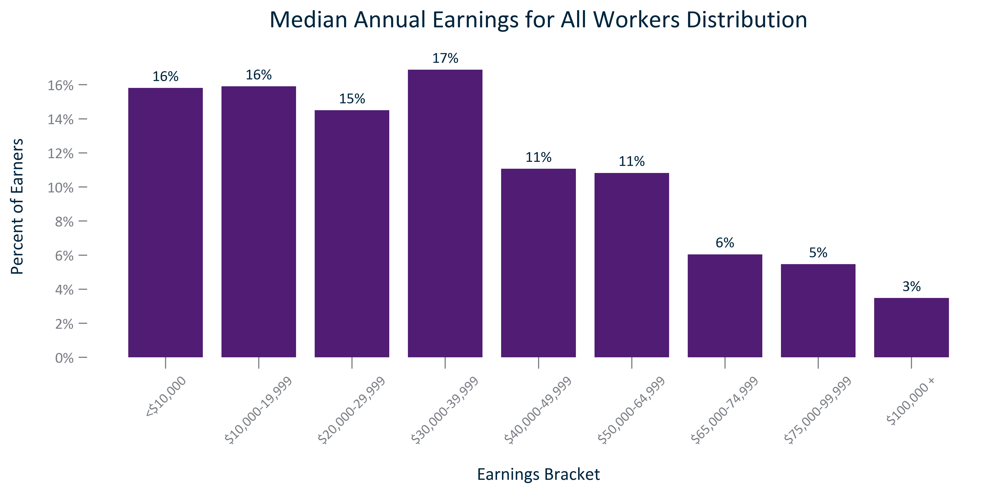

In [102]:
title = "Median Annual Earnings for All Workers Distribution"
#create temporary dataframe
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Earnings:% Less than 10,000',
#                    'Earnings:% Less than 5,000', 'Earnings:% 5,000 to 9,999', 
                   'Earnings:% 10,000 to 19,999', 'Earnings:% 20,000 to 29,999', 
                   'Earnings:% 30,000 to 39,999', 'Earnings:% 40,000 to 49,999', 'Earnings:% 50,000 to 64,999', 'Earnings:% 65,000 to 74,999', 
                   'Earnings:% 75,000 to 99,999', 'Earnings:% 100,000 and Over']]
df_temp = df_temp.rename(columns = {'Earnings:% Less than 10,000': '<$10,000', 
#                                     'Earnings:% Less than 5,000': '<$5,000',
#                                     'Earnings:% 5,000 to 9,999': '$5,000-9,999', 
                                    'Earnings:% 10,000 to 19,999': '$10,000-19,999', 
                                    'Earnings:% 20,000 to 29,999': '$20,000-29,999', 
                                    'Earnings:% 30,000 to 39,999': '$30,000-39,999', 
                                    'Earnings:% 40,000 to 49,999': '$40,000-49,999', 
                                    'Earnings:% 50,000 to 64,999': '$50,000-64,999', 
                                    'Earnings:% 65,000 to 74,999': '$65,000-74,999', 
                                    'Earnings:% 75,000 to 99,999': '$75,000-99,999', 
                                    'Earnings:% 100,000 and Over': '$100,000 +'})
df_temp = df_temp.transpose().reset_index(drop = False).rename(columns = {'index':'Earnings Bracket', 32:'Percent of Earners'})
#initiate figure and set parameters
xinput = 'Earnings Bracket'
yinput = 'Percent of Earners'
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = xinput
ylabel = yinput
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', labelsize = SMALLER_SIZE, rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.0f}%")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianearningsdistributionallworkers_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianearningsdistributionallworkers_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_medianearningsdistributionallworkers_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

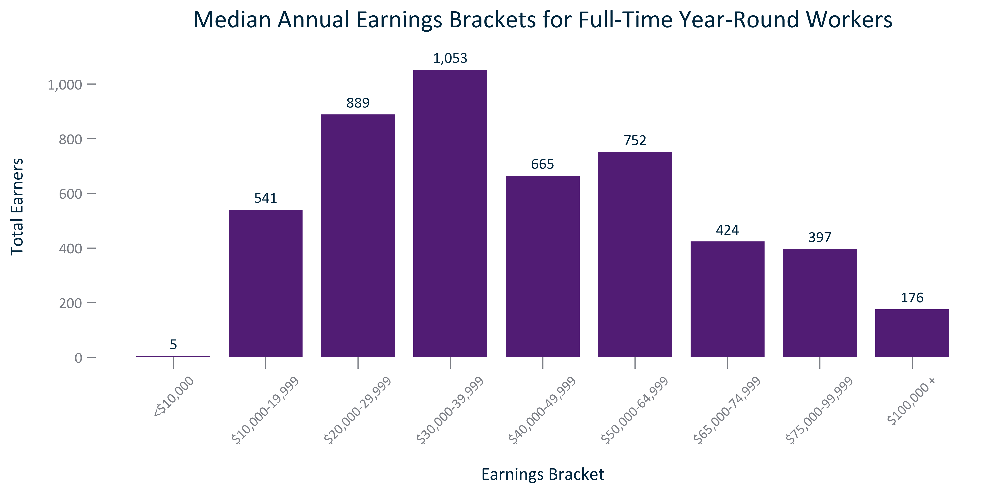

In [103]:
title = "Median Annual Earnings Brackets for Full-Time Year-Round Workers"
#create temporary dataframe
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['EarningsFT:Less than 10,000',
#                    'EarningsFT:Less than 5,000', 'EarningsFT:5,000 to 9,999', 
                   'EarningsFT:10,000 to 19,999', 'EarningsFT:20,000 to 29,999', 
                   'EarningsFT:30,000 to 39,999', 'EarningsFT:40,000 to 49,999', 'EarningsFT:50,000 to 64,999', 'EarningsFT:65,000 to 74,999', 
                   'EarningsFT:75,000 to 99,999', 'EarningsFT:100,000 and Over']]
df_temp = df_temp.rename(columns = {'EarningsFT:Less than 10,000': '<$10,000', 
#                                     'EarningsFT:Less than 5,000': '<$5,000',
#                                     'EarningsFT:5,000 to 9,999': '$5,000-9,999', 
                                    'EarningsFT:10,000 to 19,999': '$10,000-19,999', 
                                    'EarningsFT:20,000 to 29,999': '$20,000-29,999', 
                                    'EarningsFT:30,000 to 39,999': '$30,000-39,999', 
                                    'EarningsFT:40,000 to 49,999': '$40,000-49,999', 
                                    'EarningsFT:50,000 to 64,999': '$50,000-64,999', 
                                    'EarningsFT:65,000 to 74,999': '$65,000-74,999', 
                                    'EarningsFT:75,000 to 99,999': '$75,000-99,999', 
                                    'EarningsFT:100,000 and Over': '$100,000 +'})
df_temp = df_temp.transpose().reset_index(drop = False).rename(columns = {'index':'Earnings Bracket', 32:'Total Earners'})
#initiate figure and set parameters
xinput = 'Earnings Bracket'
yinput = 'Total Earners'
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = xinput
ylabel = yinput
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', labelsize = SMALLER_SIZE, rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianearningsfulltimeworkerscount_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianearningsfulltimeworkerscount_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_medianearningsfulltimeworkerscount_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

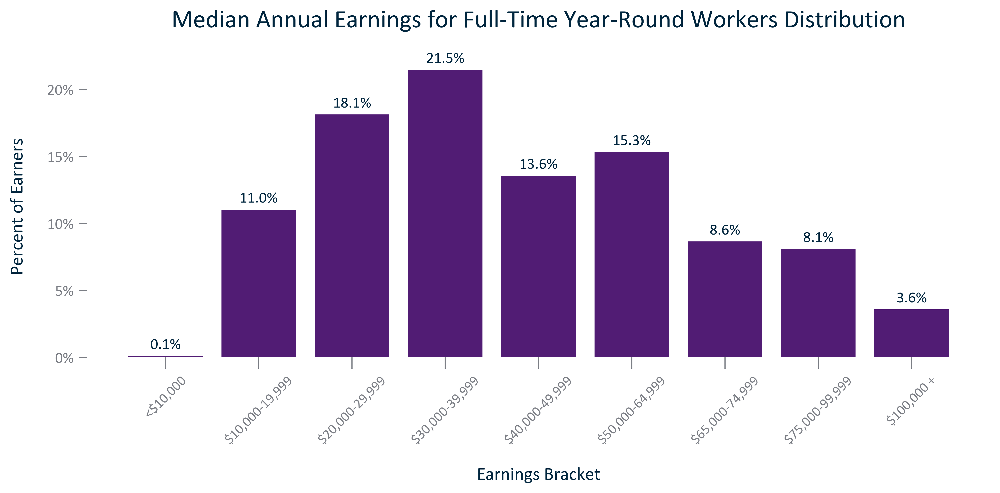

In [104]:
title = "Median Annual Earnings for Full-Time Year-Round Workers Distribution"
#create temporary dataframe
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['EarningsFT:% Less than 10,000',
#                    'EarningsFT:% Less than 5,000', 'EarningsFT:% 5,000 to 9,999', 
                   'EarningsFT:% 10,000 to 19,999', 'EarningsFT:% 20,000 to 29,999', 
                   'EarningsFT:% 30,000 to 39,999', 'EarningsFT:% 40,000 to 49,999', 'EarningsFT:% 50,000 to 64,999', 'EarningsFT:% 65,000 to 74,999', 
                   'EarningsFT:% 75,000 to 99,999', 'EarningsFT:% 100,000 and Over']]
df_temp = df_temp.rename(columns = {'EarningsFT:% Less than 10,000': '<$10,000', 
#                                     'EarningsFT:% Less than 5,000': '<$5,000',
#                                     'EarningsFT:% 5,000 to 9,999': '$5,000-9,999', 
                                    'EarningsFT:% 10,000 to 19,999': '$10,000-19,999', 
                                    'EarningsFT:% 20,000 to 29,999': '$20,000-29,999', 
                                    'EarningsFT:% 30,000 to 39,999': '$30,000-39,999', 
                                    'EarningsFT:% 40,000 to 49,999': '$40,000-49,999', 
                                    'EarningsFT:% 50,000 to 64,999': '$50,000-64,999', 
                                    'EarningsFT:% 65,000 to 74,999': '$65,000-74,999', 
                                    'EarningsFT:% 75,000 to 99,999': '$75,000-99,999', 
                                    'EarningsFT:% 100,000 and Over': '$100,000 +'})
df_temp = df_temp.transpose().reset_index(drop = False).rename(columns = {'index':'Earnings Bracket', 32:'Percent of Earners'})
#initiate figure and set parameters
xinput = 'Earnings Bracket'
yinput = 'Percent of Earners'
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = xinput
ylabel = yinput
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', labelsize = SMALLER_SIZE, rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.1f}%")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianearningsdistributionfulltimeworkers_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianearningsdistributionfulltimeworkers_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_medianearningsdistributionfulltimeworkers_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

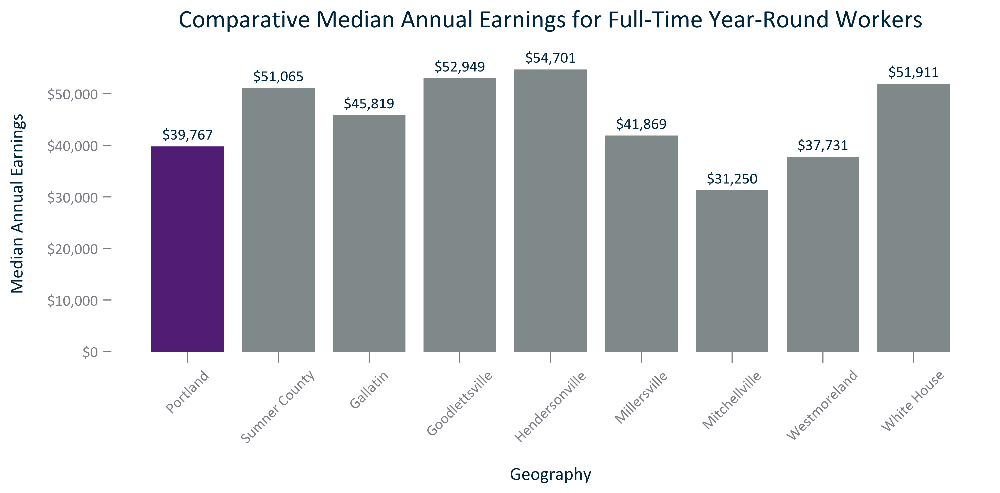

In [105]:
title = 'Comparative Median Annual Earnings for Full-Time Year-Round Workers'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp.loc[df_temp['NAME'] != 'GNRC Region']
df_temp = df_temp[['NAME', 'EarningsFT:Median']]
x = df_temp['NAME']
y = df_temp['EarningsFT:Median']
xlabel = 'Geography'
ylabel = 'Median Annual Earnings'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 5, "${:,.0f}")
# #display and save
fig.savefig('../Figures/EMP/EMP_bar_geocomparative_medianannualearningsfulltimeworkers_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_geocomparative_medianannualearningsfulltimeworkers_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_geocomparative_medianannualearningsfulltimeworkers_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 2 dimensions. The detected shape was (4, 2) + inhomogeneous part.

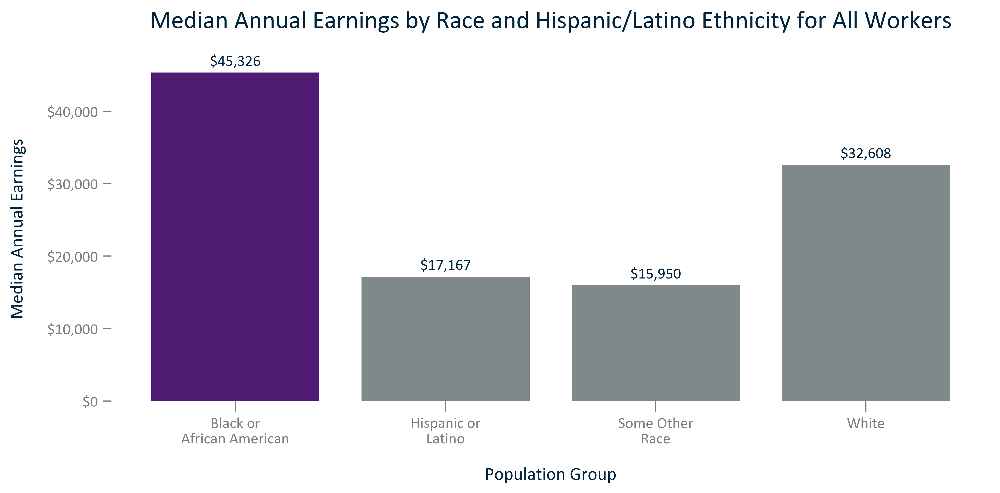

In [106]:
title = 'Median Annual Earnings by Race and Hispanic/Latino Ethnicity for All Workers'
df_temp = Primary.loc[Primary['Year'] == 2021.0]
df_temp = df_temp[['Earnings:Median, All Earners, Black or African American Alone', 'Earnings:Median, All Earners, Hispanic or Latino',
#                   'Earnings:Median, All Earners, American Indian Alaska Native Alone', 'Earnings:Median, All Earners, Asian Alone', 
#                    'Earnings:Median, All Earners, Native Hawaiian Pacific Islander Alone', 
                   'Earnings:Median, All Earners, Some Other Race Alone', 
#                   'Earnings:Median, All Earners, Two or More Races', 
                    'Earnings:Median, All Earners, White Alone', ]]
df_temp = df_temp.rename(columns = {'Earnings:Median, All Earners, White Alone': 'White', 
                                    'Earnings:Median, All Earners, Black or African American Alone': 'Black or\nAfrican American', 
#                                    'Earnings:Median, All Earners, American Indian Alaska Native Alone': 'American Indian or\nAlaska Native', 
                                    'Earnings:Median, All Earners, Asian Alone': 'Asian', 
#                                     'Earnings:Median, All Earners, Native Hawaiian Pacific Islander Alone': 'Native Hawaiian\nor Pacific Islander', 
                                    'Earnings:Median, All Earners, Some Other Race Alone': 'Some Other\nRace', 
#                                    'Earnings:Median, All Earners, Two or More Races': 'Two or\nMore Races', 
                                    'Earnings:Median, All Earners, Hispanic or Latino': 'Hispanic or\nLatino'})
df_temp = df_temp.melt(var_name = 'Group', value_name = 'Median Annual Earnings')
#initiate figure and set parameters
x = df_temp['Group']
y = df_temp['Median Annual Earnings']
xlabel = 'Population Group'
ylabel = 'Median Annual Earnings'
fig, ax = plt.subplots()
#bar_color = [C2 if i != 'Overall Median' else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major')#, labelsize = SMALLER_SIZE)#prop = {'size': 9})
#data labels
singledatalabels(0, 5, "${:,.0f}")
forline = Primary.loc[Primary['Year'] == 2021.0]
line = (forline['Earnings:Median, All Earners']).astype(int)
plt.axhspan(0, line, alpha=0.2, color= GNRCCOOLGRAY, zorder=0)
ax.text(1.75, 45000, 'The shading shows overall median earnings for all workers.', style = 'italic')

#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsraceethallworkers_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsraceethallworkers_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_medianannualearningsraceethallworkers_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

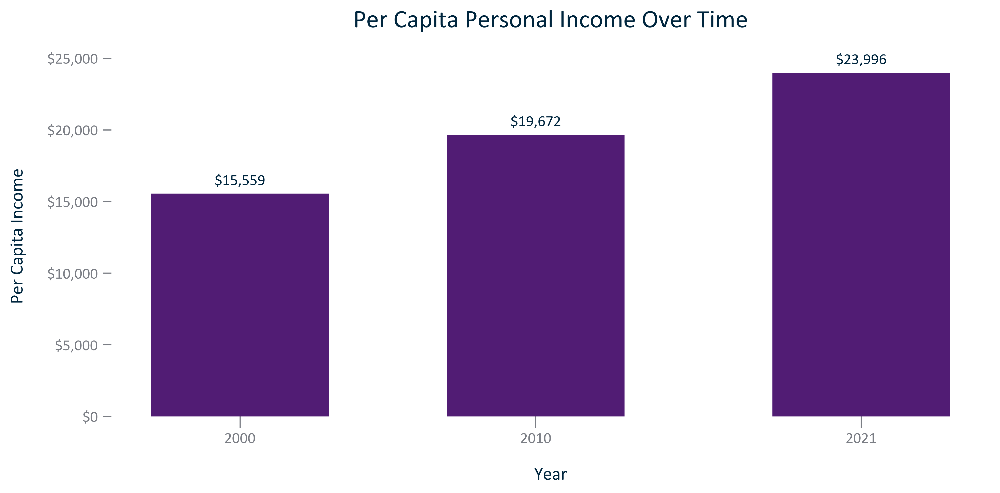

In [107]:
title = 'Per Capita Personal Income Over Time'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Per Capita Income']]
xinput = 'Year'
yinput = 'Per Capita Income'
xlabel = xinput
ylabel = yinput
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
labels = ['2000', '2010', '2021']
plt.xticks(x, labels)
#plt.locator_params(axis='x', nbins=3)
#data labels
singledatalabels(0, 6, "${:,.0f}")
#display and save
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_percapitaincome_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_primarygeo_percapitaincome_overtime.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_primarygeo_percapitaincome_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();

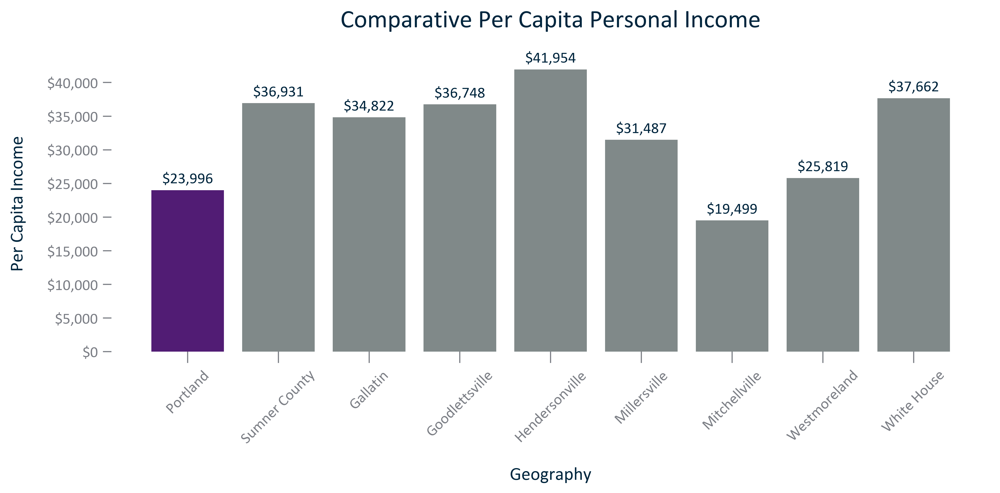

In [108]:
title = 'Comparative Per Capita Personal Income'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2021.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['NAME', 'Per Capita Income']]
x = df_temp['NAME']
y = df_temp['Per Capita Income']
xlabel = 'Geography'
ylabel = 'Per Capita Income'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 5, "${:,.0f}")
# #display and save
fig.savefig('../Figures/EMP/EMP_bar_geocomparative_percapitaincome_2021.svg', bbox_inches='tight')
fig.savefig('../Figures/EMP/EMP_bar_geocomparative_percapitaincome_2021.png', bbox_inches='tight')
with open('../Figures/EMP/EMP_bar_geocomparative_percapitaincome_2021.txt', 'w') as text_file:
    text_file.write('Citation: 2017-2021 ACS 5-Year Estimates')
plt.show()
plt.close();